In [1]:
import pandas as pd
import requests
from bs4 import BeautifulSoup
import matplotlib.pyplot as plt
import csv


import sys
import os
import geopandas as gpd
import pycountry
from shapely.geometry import Polygon


In [17]:
# ROAD Qualities dataset
# https://www.theglobaleconomy.com/rankings/roads_quality/Europe/
url = "https://www.theglobaleconomy.com/rankings/roads_quality/Europe/"
response = requests.get(url)
soup = BeautifulSoup(response.content, "html.parser")

In [18]:
Countries = ["Country"]
RoadQuality = ["RoadQuality"]
GlobalRank = ["Ranking"]
year = 2019

In [19]:
def changeToAndSymbol(text):
    new_text = text.replace("&amp;", "&")
    return new_text

def getCountry(text):
    start_str = "\">"
    end_str = "</a>"
    start_index = text.index(start_str) + len(start_str)
    end_index = text.index(end_str)
    result = text[start_index:end_index]
    result = changeToAndSymbol(result)
    #print(result)
    return result

In [20]:
country_data = soup.findAll('table', attrs = {'id': "benchmarkTable"})
soup = BeautifulSoup(str(country_data), "html.parser")

rows = soup.select('tr')

#print(rows[0])
data = []
for row in rows[1:]:
    test = str(row)
    soup2 = BeautifulSoup(test, "html.parser")
    td_tags = soup2.find_all('td')
    Countries.append(getCountry(str(td_tags[0])))
    RoadQuality.append(td_tags[1].get_text().strip())
    GlobalRank.append(td_tags[2].get_text().strip())
    #print(td_tags[0])
    #for th in th_tags:
     #   print(th.get_text().strip())

    #data.append(soup.select("th"))
#print(data[1])

 #   print(row)
#country_table = country_data.findAll("tr")
print(Countries)
print(RoadQuality)
print(GlobalRank)


['Country', 'Netherlands', 'Switzerland', 'Austria', 'Portugal', 'Spain', 'Croatia', 'Denmark', 'Luxembourg', 'France', 'Finland', 'Germany', 'Sweden', 'Cyprus', 'Turkey', 'Slovenia', 'UK', 'Lithuania', 'Estonia', 'Greece', 'Norway', 'Belgium', 'Ireland', 'Italy', 'Poland', 'Iceland', 'Hungary', 'Slovakia', 'Albania', 'Czechia', 'Montenegro', 'Latvia', 'Russia', 'Serbia', 'Bulgaria', 'North Macedonia', 'Malta', 'Romania', 'Ukraine', 'Bosnia & Herz.', 'Moldova']
['RoadQuality', '6.4', '6.3', '6', '6', '5.7', '5.6', '5.6', '5.5', '5.4', '5.3', '5.3', '5.3', '5.1', '5', '4.9', '4.9', '4.8', '4.7', '4.6', '4.5', '4.4', '4.4', '4.4', '4.3', '4.1', '4', '4', '3.9', '3.9', '3.9', '3.6', '3.5', '3.5', '3.4', '3.4', '3.3', '3', '3', '2.8', '2.6']
['Ranking', '1', '2', '3', '4', '5', '6', '7', '8', '9', '10', '11', '12', '13', '14', '15', '16', '17', '18', '19', '20', '21', '22', '23', '24', '25', '26', '27', '28', '29', '30', '31', '32', '33', '34', '35', '36', '37', '38', '39', '40']


In [21]:
# Open a new CSV file for writing
with open('roadQuality2019.csv', 'w', newline='') as csvfile:
    writer = csv.writer(csvfile)

    # Write the arrays as columns in the CSV file
    for row in zip(Countries, RoadQuality, GlobalRank):
        writer.writerow(row)

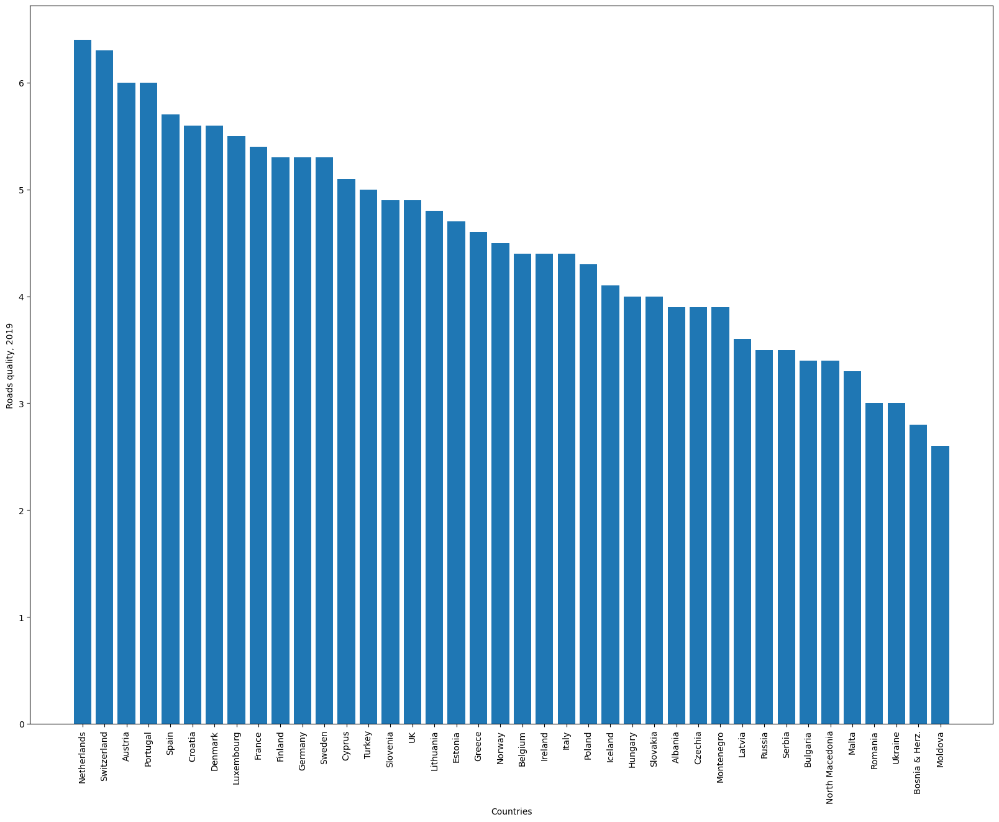

In [22]:
# Read CSV file using Pandas
df = pd.read_csv('roadQuality2019.csv')

# Extract data for plotting
x = df['Country']
y = df['RoadQuality']



# Create bar chart using Matplotlib
plt.bar(x, y)
plt.rcParams['figure.figsize'] = [20, 15]
# Rotate x-axis labels to be vertical
plt.xticks(rotation=90)


plt.xlabel('Countries')
plt.ylabel('Roads quality, 2019')
plt.show()

# Oppervlakte en populatie

In [2]:
# ROAD Qualities dataset
# https://autotraveler.ru/en/spravka/max-speed-limits-in-europe.html
url = "https://www.europa-nu.nl/id/vh89nvo47vi0/europese_landen?sort=oppervlakte&landen=be&landen=bg&landen=cy&landen=dk&landen=de&landen=ee&landen=fi&landen=fr&landen=gr&landen=hu&landen=ie&landen=it&landen=hr&landen=lv&landen=lt&landen=lu&landen=mt&landen=nl&landen=at&landen=pl&landen=pt&landen=ro&landen=si&landen=sk&landen=es&landen=cz&landen=se&landen=al&landen=ad&landen=am&landen=az&landen=ba&landen=ge&landen=is&landen=li&landen=md&landen=mc&landen=me&landen=mk&landen=no&landen=ua&landen=sm&landen=rs&landen=tr&landen=gb&landen=ch&landen=by&landen=kz&landen=xk&landen=ru&landen=va"
response = requests.get(url)
soup = BeautifulSoup(response.content, "html.parser")

In [3]:
def getCountry(text):
    start_str = "span>"
    start_index = text.index(start_str) + len(start_str)
    end_index = text.index("<", start_index)
    result = text[start_index:end_index]
    result = changeToAndSymbol(result)
    return result


In [ ]:
Countries = ["Country"]
Inwoners = ["Inwoners"]
Oppervlakte = ["Oppervlakte"]
Autoweg = ["Autoweg"]
Snelweg = ["Snelweg"]

In [4]:
soup

<!DOCTYPE html>

<html class="no-js" lang="nl" prefix="og: http://ogp.me/ns#">
<head>
<meta content="width=device-width, initial-scale=1.0" name="viewport"/>
<meta charset="utf-8"/>
<meta content="welke landen horen bij Europa, hoeveel landen heeft Europa, landen Europa, inwoners Europa, Europa landen, hoeveel landen zijn er in Europa" name="Keywords"/>
<meta content="Europa bestaat geografisch en cultuurhistorisch uit 51 landen, waarvan er 27 lid zijn van de Europese Unie. Naast deze 27 leden is er een aantal andere …" name="Description"/>
<!-- <PageMap><DataObject type="document"><Attribute name="vorm">vj9idsj04xr6</Attribute><Attribute name="n6l">vh6nn21pc3u5</Attribute><Attribute name="n6l">vhmeket8e4xw</Attribute><Attribute name="n6s">vh6nezxgdsuz</Attribute></DataObject></PageMap> -->
<meta content="@europanu" name="twitter:site"/>
<meta content="summary" name="twitter:card"/>
<meta content="Europese landen" name="twitter:title"/>
<meta content="Europa bestaat geografisch en cult

# Speeding highway


In [23]:
# ROAD Qualities dataset
# https://autotraveler.ru/en/spravka/max-speed-limits-in-europe.html
url = "https://autotraveler.ru/en/spravka/max-speed-limits-in-europe.html"
response = requests.get(url)
soup = BeautifulSoup(response.content, "html.parser")

In [24]:
def getCountry(text):
    start_str = "span>"
    start_index = text.index(start_str) + len(start_str)
    end_index = text.index("<", start_index)
    result = text[start_index:end_index]
    result = changeToAndSymbol(result)
    return result


In [10]:
Countries = ["Country"]
BinnenBebKom = ["BinnenBebKom"]
BuitenBebKom = ["BuitenBebKom"]
Autoweg = ["Autoweg"]
Snelweg = ["Snelweg"]

In [11]:

country_data = soup.findAll('div', attrs = {'class': "table-responsive"})
soup = BeautifulSoup(str(country_data), "html.parser")

country_data = soup.findAll('table', attrs = {'id': "pkw-cars"})
soup = BeautifulSoup(str(country_data), "html.parser")

#country_data
rows = soup.select('tr')
#soup

rows

[<tr>
 <th>Country</th>
 <th title="Within town"><svg height="36" viewbox="0 0 800 480" width="60" xmlns="http://www.w3.org/2000/svg"><rect fill="#ffffff" height="450" rx="20" ry="20" stroke="#000" stroke-width="30" width="770" x="15" y="15"></rect><path d="M40 440V290l80-35 80 35v65h10v-35l55-240 55 240v35h10v-45l30-35h30v-20h50v20h30l30 40v25h15v-60l70-40 70 40v80h15V215l45-15 45 15v225z"></path></svg></th>
 <th title="Single carriageway"><svg height="36" viewbox="0 0 800 480" width="60" xmlns="http://www.w3.org/2000/svg"><rect fill="#ffffff" height="450" rx="20" ry="20" stroke="#000" stroke-width="30" width="770" x="15" y="15"></rect><path d="M40 440V290l80-35 80 35v65h10v-35l55-240 55 240v35h10v-45l30-35h30v-20h50v20h30l30 40v25h15v-60l70-40 70 40v80h15V215l45-15 45 15v225z"></path><path d="M760 40L40 440" stroke="#ed171f" stroke-linecap="round" stroke-width="60"></path><rect fill="none" height="450" rx="20" ry="20" stroke="#000" stroke-width="30" width="770" x="15" y="15"></rect><

In [12]:
data = []
for row in rows[1:]:
    test = str(row)
    #print(test)
    soup2 = BeautifulSoup(test, "html.parser")
    td_tags = soup2.find_all('td')
    #print(td_tags)
    Countries.append(getCountry(str(td_tags[0])))
    BinnenBebKom.append(td_tags[1].get_text().strip())
    BuitenBebKom.append(td_tags[2].get_text().strip())
    Autoweg.append(td_tags[3].get_text().strip())
    Snelweg.append(td_tags[4].get_text().strip())
    #RoadQuality.append(td_tags[1].get_text().strip())
    #GlobalRank.append(td_tags[2].get_text().strip())
    #print(td_tags[0])
    #for th in th_tags:
     #   print(th.get_text().strip())

    #data.append(soup.select("th"))
#print(data[1])
print(Countries)
print(BinnenBebKom)
print(BuitenBebKom)
print(Autoweg)
print(Snelweg)

['Country', 'Albania', 'Andorra', 'Armenia', 'Austria', 'Azerbaijan', 'Belarus', 'Belgium ', 'Bosnia and', 'Bulgaria', 'Croatia', 'Cyprus', 'Czech Republic', 'Denmark', 'Estonia', 'Finland', 'France', 'Georgia', 'Germany ', 'Great Britain', 'Greece', 'Hungary', 'Iceland', 'Ireland', 'Italy', 'Latvia', 'Liechtenstein', 'Lithuania ', 'Luxembourg', 'Malta', 'Moldova', 'Montenegro', 'Netherlands', 'North Macedonia', 'Norway', 'Poland ', 'Portugal', 'Romania', 'Russia', 'Serbia', 'Slovakia', 'Slovenia', 'Spain', 'Sweden', 'Switzerland', 'Turkey ', 'Ukraine']
['BinnenBebKom', '40', '50', '60', '50', '60', '60', '50', '50', '50', '50', '50', '50', '50', '50', '50', '50', '60', '50', '48', '50', '50', '50', '50', '50', '50', '50', '50', '50', '50', '50', '50', '50', '50', '50', '50', '50', '50', '60', '50', '50', '50', '50', '50', '50', '50', '50']
['BuitenBebKom', '80', '90', '90', '100', '90', '90', '90 (70)', '80', '90', '90', '80', '90', '80', '90', '80', '80', '90', '100', '96', '90', '90

In [13]:
# Open a new CSV file for writing
with open('snelheid.csv', 'w', newline='') as csvfile:
    writer = csv.writer(csvfile)

    # Write the arrays as columns in the CSV file
    for row in zip(Countries, BinnenBebKom, BuitenBebKom,Autoweg,Snelweg):
        writer.writerow(row)

# Boetes te snel rijden

In [15]:
speedFineData = pd.DataFrame(
    columns=["Country", "fine_city", "fine_rural", "fine_highway"],
    data = [
        ["Albania", 20, 20, 20],
        ["Austria", 50, 50, 50],
        ["Belgium", 153, 153, 153], # (200 + 105) / 2
        ["Croatia", 135, 67, 67],
        ["Czech Republic", 38, 19, 19],
        ["Denmark", 405, 200, 200],
        ["Estonia", 400, 200, None],
        ["Finland", 312, 260, 260],
        ["France", 90, 90, 90],
        ["Germany", 80, 70, 70],
        ["Greece", 100, 100, 100],
        ["Hungary", 80, 80, 80],
        ["Ireland", 90, 90, 90],
        ["Italy", 143, 143, 143],
        ["Kosovo", 200, 200, 200],
        ["Latvia", 71, 101, 141],
        ["Lithuania", 57, 57, 57], # (86 + 28) / 2
        ["Luxembourg", 49, 49, 49],
        ["Netherlands", 207, 196, 186],
        ["Norway", 944, 711, 711],
        ["Poland", 48, 48, 48],
        ["Portugal", 360, 180, 180], # (600 + 120) / 2 | (300 + 60) / 2
        ["Slovakia", 80, 40, 40],
        ["Slovenia", 250, 80, 80],
        ["Spain", 150, 50, 50],
        ["Sweden", 345, 300, 300],
        ["Switzerland", 560, 374, 243],
        ["United Kingdom", 95, 95, 95]
    ]
)
speedFineData.to_csv('boetes.csv')

# Alcohol percentage


In [46]:

url = "https://etsc.eu/issues/drink-driving/blood-alcohol-content-bac-drink-driving-limits-across-europe/"
response = requests.get(url)
soup = BeautifulSoup(response.content, "html.parser")

In [47]:
def getCountry(text):
    start_str = "span>"
    start_index = text.index(start_str) + len(start_str)
    end_index = text.index("<", start_index)
    result = text[start_index:end_index]
    result = changeToAndSymbol(result)
    return result


In [48]:
Countries = ["Country"]
standard_driver = ["standard_driver"]
commercial_driver = ["commercial_driver"]
novice_driver = ["novice_driver"]


In [49]:

country_data = soup.findAll('div', attrs = {'class': "is-layout-flow wp-block-column"})
soup = BeautifulSoup(str(country_data), "html.parser")

country_data = soup.findAll('table')
soup = BeautifulSoup(str(country_data), "html.parser")

#country_data
rows = soup.select('tr')
#soup

#rows

In [50]:
data = []
for row in rows[1:]:
    test = str(row)
    #print(test)
    soup2 = BeautifulSoup(test, "html.parser")
    td_tags = soup2.find_all('strong')
    #print(td_tags)
    Countries.append(td_tags[0].get_text())#getCountry(str(td_tags[0])))
    standard_driver.append(td_tags[1].get_text().strip())
    commercial_driver.append(td_tags[2].get_text().strip())
    novice_driver.append(td_tags[3].get_text().strip())
    #RoadQuality.append(td_tags[1].get_text().strip())
    #GlobalRank.append(td_tags[2].get_text().strip())
    #print(td_tags[0])
    #for th in th_tags:
     #   print(th.get_text().strip())

    #data.append(soup.select("th"))
#print(data[1])
print(Countries)
print(standard_driver)
print(commercial_driver)
print(novice_driver)

['Country', 'Austria', 'Belgium', 'Bulgaria', 'Croatia', 'Cyprus', 'Czech Republic \xa0\xa0', 'Denmark', 'Estonia', 'Finland', 'France', 'Germany', 'Greece', 'Hungary', 'Ireland', 'Italy', 'Latvia', 'Lithuania', 'Luxembourg', 'Malta', 'Netherlands', 'Norway', 'Poland', 'Portugal', 'Romania ', 'Slovakia ', 'Slovenia ', 'Spain ', 'Sweden', 'UK [i]', 'Switzerland ']
['standard_driver', '0.5', '0.5', '0.5', '0.5', '0.5', '0.0', '0.5', '0.2', '0.5', '0.5', '0.5', '0.5', '0.0', '0.5', '0.5', '0.5', '0.4', '0.5', '0.5', '0.5', '0.2', '0.2', '0.5', '0.0', '0.0', '0.5', '0.5', '0.2', '0.8', '0.5']
['commercial_driver', '0.1', '0.2', '0.5', '0.0', '0.2', '0.0', '0.5', '0.2', '0.5', '0.5 (0.2 bus drivers)', '0.0', '0.2', '0.0', '0.2', '0.0', '0.5', '0.0', '0.2', '0.2', '0.5', '0.2', '0.2', '0.2', '0.0', '0.0', '0.0', '0.3', '0.2', '0.8', '0.1']
['novice_driver', '0.1', '0.5', '0.5', '0.0', '0.2', '0.0', '0.5', '0.2', '0.5', '0.2', '0.0', '0.2', '0.0', '0.2', '0.0', '0.2', '0.0', '0.2', '0.2', '0.

In [51]:
# Open a new CSV file for writing
with open('alcohol.csv', 'w', newline='') as csvfile:
    writer = csv.writer(csvfile)

    # Write the arrays as columns in the CSV file
    for row in zip(Countries, standard_driver, commercial_driver,novice_driver):
        writer.writerow(row)

# Other

In [114]:
file = "IRTAD_CASUAL_BY_AGE.csv" 

In [48]:
def make_bbox(long0, lat0, long1, lat1):
    return Polygon([[long0, lat0],
                    [long1,lat0],
                    [long1,lat1],
                    [long0, lat1]])

In [28]:
## Alternatively, can clip to more standard European extent 
## with Central/Eastern Russia excluded
bbox = make_bbox(-36.386719,29.228890,60.292969,74.543330)
bbox_gdf = gpd.GeoDataFrame(index=[0], crs='epsg:4326', geometry = [bbox])

/home/goldmanes/.local/lib/python3.11/site-packages/geopandas/geodataframe.py:1415: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  result = super().__getitem__(key)


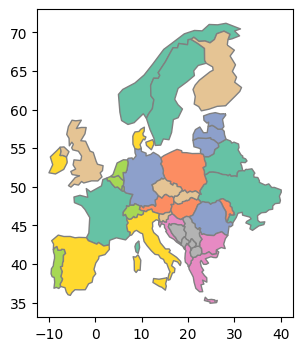

In [29]:
world = gpd.read_file(gpd.datasets.get_path('naturalearth_lowres'))
world = world.overlay(bbox_gdf, how="intersection")
world = world[world["continent"] == "Europe"][~world["name"].isin(["Russia", "Svalbard", "Iceland", "French Guiana", "Suriname"])]
ax2 = world.plot( figsize=(8,4), edgecolor=u'gray', cmap='Set2' )

In [15]:
def plot_map(col, data, free_legend=False, lower=0.0, higher=1.0):
    #ax2 = world.plot( figsize=(8,4), edgecolor=u'gray', cmap='Set2' )

    merge_df = pd.merge(left=world, right=data, how="left", left_on="name", right_on="Country")

    vmin = lower#data[col].min()
    print(lower)
    vmax = higher#data[col].max()
    print(higher)
    cmap = "viridis"

    fig, ax = plt.subplots(1, figsize=(20, 8))
    ax.axis('off')
    if not free_legend:
        merge_df.plot(column=col, ax=ax, edgecolor='0.8', linewidth=1, cmap=cmap, legend=free_legend, vmin=lower, vmax=higher)
    else:
        merge_df.plot(column=col, ax=ax, edgecolor='0.8', linewidth=1, cmap=cmap, legend=free_legend)
    world.boundary.plot(ax=ax, linewidth=0.4, edgecolor=u'gray')

    ax.set_title(col, fontdict={'fontsize': '25', 'fontweight': '3'})

    if not free_legend:
        # Create colorbar as a legend
        sm = plt.cm.ScalarMappable(norm=plt.Normalize(vmin=vmin, vmax=vmax), cmap=cmap)
        # Empty array for the data range
        sm._A = []
        # Add the colorbar to the figure
        cbaxes = fig.add_axes([0.15, 0.25, 0.01, 0.4])
        cbar = fig.colorbar(sm, cax=cbaxes)

    plt.plot()

In [134]:
data = pd.read_csv(file)
data


,COUNTRY,Country,INJURY_TYPE,Injury type,AGE_GROUP,Age group,TRAFFIC_PARTICIPATION,Road user,MEASURE,Measure,...,Year,Unit Code,Unit,PowerCode Code,PowerCode,Reference Period Code,Reference Period,Value,Flag Codes,Flags
0,AUS,Australia,KIL,Killed,TOT,Total,TOT,Total,NUMBER,Number,...,1990,PER,Persons,0,Units,NaN,NaN,2331.0,NaN,NaN
1,AUS,Australia,KIL,Killed,TOT,Total,TOT,Total,NUMBER,Number,...,1991,PER,Persons,0,Units,NaN,NaN,2113.0,NaN,NaN
2,AUS,Australia,KIL,Killed,TOT,Total,TOT,Total,NUMBER,Number,...,1992,PER,Persons,0,Units,NaN,NaN,1974.0,NaN,NaN
3,AUS,Australia,KIL,Killed,TOT,Total,TOT,Total,NUMBER,Number,...,1993,PER,Persons,0,Units,NaN,NaN,1953.0,NaN,NaN
4,AUS,Australia,KIL,Killed,TOT,Total,TOT,Total,NUMBER,Number,...,1994,PER,Persons,0,Units,NaN,NaN,1928.0,NaN,NaN
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
204653,LUX,Luxembourg,KIL,Killed,65MORE,65 years and more,PEDELECS,Of which: pedelecs,RATE-POP-100T,Rate per hundred thousand population,...,2021,100000HAB,Per 100 000 inhabitants,0,Units,NaN,NaN,0.0,NaN,NaN
204654,LUX,Luxembourg,KIL,Killed,65MORE,65 years and more,MICRO-VEHICLES,Motorised micro-vehicles excluding bikes and m...,RATE-POP-100T,Rate per hundred thousand population,...,2021,100000HAB,Per 100 000 inhabitants,0,Units,NaN,NaN,0.0,NaN,NaN
204655,LUX,Luxembourg,KIL,Killed,UNKNOWN,Unknown age,PEDELECS,Of which: pedelecs,NUMBER,Number,...,2021,PER,Persons,0,Units,NaN,NaN,0.0,NaN,NaN
204656,LUX,Luxembourg,KIL,Killed,UNKNOWN,Unknown age,MICRO-VEHICLES,Motorised micro-vehicles excluding bikes and m...,NUMBER,Number,...,2021,PER,Persons,0,Units,NaN,NaN,0.0,NaN,NaN


In [135]:
data[data["TRAFFIC_PARTICIPATION"] == "CYCLISTS"][data["Year"] == 2020][data["Measure"] == "Number"]

/tmp/ipykernel_4739/2148740426.py:1: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  data[data["TRAFFIC_PARTICIPATION"] == "CYCLISTS"][data["Year"] == 2020][data["Measure"] == "Number"]
/tmp/ipykernel_4739/2148740426.py:1: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  data[data["TRAFFIC_PARTICIPATION"] == "CYCLISTS"][data["Year"] == 2020][data["Measure"] == "Number"]


,COUNTRY,Country,INJURY_TYPE,Injury type,AGE_GROUP,Age group,TRAFFIC_PARTICIPATION,Road user,MEASURE,Measure,...,Year,Unit Code,Unit,PowerCode Code,PowerCode,Reference Period Code,Reference Period,Value,Flag Codes,Flags
158,AUS,Australia,KIL,Killed,TOT,Total,CYCLISTS,Cyclists,NUMBER,Number,...,2020,PER,Persons,0,Units,NaN,NaN,42.0,p,Provisional
606,AUT,Austria,KIL,Killed,TOT,Total,CYCLISTS,Cyclists,NUMBER,Number,...,2020,PER,Persons,0,Units,NaN,NaN,40.0,NaN,NaN
1118,BEL,Belgium,KIL,Killed,TOT,Total,CYCLISTS,Cyclists,NUMBER,Number,...,2020,PER,Persons,0,Units,NaN,NaN,84.0,NaN,NaN
1628,CAN,Canada,KIL,Killed,TOT,Total,CYCLISTS,Cyclists,NUMBER,Number,...,2020,PER,Persons,0,Units,NaN,NaN,51.0,e,Estimate
2138,CZE,Czech Republic,KIL,Killed,TOT,Total,CYCLISTS,Cyclists,NUMBER,Number,...,2020,PER,Persons,0,Units,NaN,NaN,51.0,NaN,NaN
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
202237,COL,Colombia,KIL,Killed,18-20Y,18-20 years,CYCLISTS,Cyclists,NUMBER,Number,...,2020,PER,Persons,0,Units,NaN,NaN,33.0,NaN,NaN
202419,COL,Colombia,KIL,Killed,21-24Y,21-24 years,CYCLISTS,Cyclists,NUMBER,Number,...,2020,PER,Persons,0,Units,NaN,NaN,25.0,NaN,NaN
202601,COL,Colombia,KIL,Killed,25-64Y,25-64 years,CYCLISTS,Cyclists,NUMBER,Number,...,2020,PER,Persons,0,Units,NaN,NaN,241.0,NaN,NaN
202783,COL,Colombia,KIL,Killed,65MORE,65 years and more,CYCLISTS,Cyclists,NUMBER,Number,...,2020,PER,Persons,0,Units,NaN,NaN,92.0,NaN,NaN


In [136]:
pd.merge(left=world, right=data[data["TRAFFIC_PARTICIPATION"] == "CYCLISTS"][data["Year"] == 2020][data["Measure"] == "Number"][data["Age group"] == "Total"], how="left", left_on="name", right_on="Country")
#pd.merge(left=world, right=data[data["TRAFFIC_PARTICIPATION"] == "CYCLISTS"][data["Year"] == 2020][data["Measure"] == "Number"], how="left", left_on="name", right_on="Country").iloc[1]

/tmp/ipykernel_4739/111992459.py:1: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pd.merge(left=world, right=data[data["TRAFFIC_PARTICIPATION"] == "CYCLISTS"][data["Year"] == 2020][data["Measure"] == "Number"][data["Age group"] == "Total"], how="left", left_on="name", right_on="Country")
/tmp/ipykernel_4739/111992459.py:1: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pd.merge(left=world, right=data[data["TRAFFIC_PARTICIPATION"] == "CYCLISTS"][data["Year"] == 2020][data["Measure"] == "Number"][data["Age group"] == "Total"], how="left", left_on="name", right_on="Country")
/tmp/ipykernel_4739/111992459.py:1: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  pd.merge(left=world, right=data[data["TRAFFIC_PARTICIPATION"] == "CYCLISTS"][data["Year"] == 2020][data["Measure"] == "Number"][data["Age group"] == "Total"], how="left", left_on="name", right_on="Country")


,pop_est,continent,name,iso_a3,gdp_md_est,geometry,COUNTRY,Country,INJURY_TYPE,Injury type,...,Year,Unit Code,Unit,PowerCode Code,PowerCode,Reference Period Code,Reference Period,Value,Flag Codes,Flags
0,5347896.0,Europe,Norway,NOR,403336,"POLYGON ((29.39955 69.15692, 28.59193 69.06478...",NOR,Norway,KIL,Killed,...,2020.0,PER,Persons,0.0,Units,NaN,NaN,5.0,NaN,NaN
1,67059887.0,Europe,France,FRA,2715518,"MULTIPOLYGON (((9.39000 43.00998, 9.56002 42.1...",FRA,France,KIL,Killed,...,2020.0,PER,Persons,0.0,Units,NaN,NaN,178.0,NaN,NaN
2,10285453.0,Europe,Sweden,SWE,530883,"POLYGON ((11.46827 59.43239, 12.30037 60.11793...",SWE,Sweden,KIL,Killed,...,2020.0,PER,Persons,0.0,Units,NaN,NaN,18.0,NaN,NaN
3,9466856.0,Europe,Belarus,BLR,63080,"POLYGON ((29.22951 55.91834, 29.37157 55.67009...",NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
4,44385155.0,Europe,Ukraine,UKR,153781,"POLYGON ((32.41206 52.28869, 32.71576 52.23847...",NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
5,37970874.0,Europe,Poland,POL,595858,"POLYGON ((23.52754 53.47012, 23.80493 53.08973...",POL,Poland,KIL,Killed,...,2020.0,PER,Persons,0.0,Units,NaN,NaN,249.0,NaN,NaN
6,8877067.0,Europe,Austria,AUT,445075,"POLYGON ((16.90375 47.71487, 16.34058 47.71290...",AUT,Austria,KIL,Killed,...,2020.0,PER,Persons,0.0,Units,NaN,NaN,40.0,NaN,NaN
7,9769949.0,Europe,Hungary,HUN,163469,"POLYGON ((22.64082 48.15024, 22.71053 47.88219...",HUN,Hungary,KIL,Killed,...,2020.0,PER,Persons,0.0,Units,NaN,NaN,39.0,NaN,NaN
8,2657637.0,Europe,Moldova,MDA,11968,"POLYGON ((26.85782 48.36821, 27.52254 48.46712...",NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
9,19356544.0,Europe,Romania,ROU,250077,"POLYGON ((28.67978 45.30403, 29.14972 45.46493...",NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN


/tmp/ipykernel_4739/1136068798.py:1: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  plot_map("Value", data[data["TRAFFIC_PARTICIPATION"] == "CYCLISTS"][data["Year"] == 2021][data["Measure"] == "Rate per hundred thousand population"][data["Age group"] == "Total"], free_legend=True)
/tmp/ipykernel_4739/1136068798.py:1: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  plot_map("Value", data[data["TRAFFIC_PARTICIPATION"] == "CYCLISTS"][data["Year"] == 2021][data["Measure"] == "Rate per hundred thousand population"][data["Age group"] == "Total"], free_legend=True)
/tmp/ipykernel_4739/1136068798.py:1: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  plot_map("Value", data[data["TRAFFIC_PARTICIPATION"] == "CYCLISTS"][data["Year"] == 2021][data["Measure"] == "Rate per hundred thousand population"][data["Age group"] == "Total"], free_legend=True)


0.0
1.0


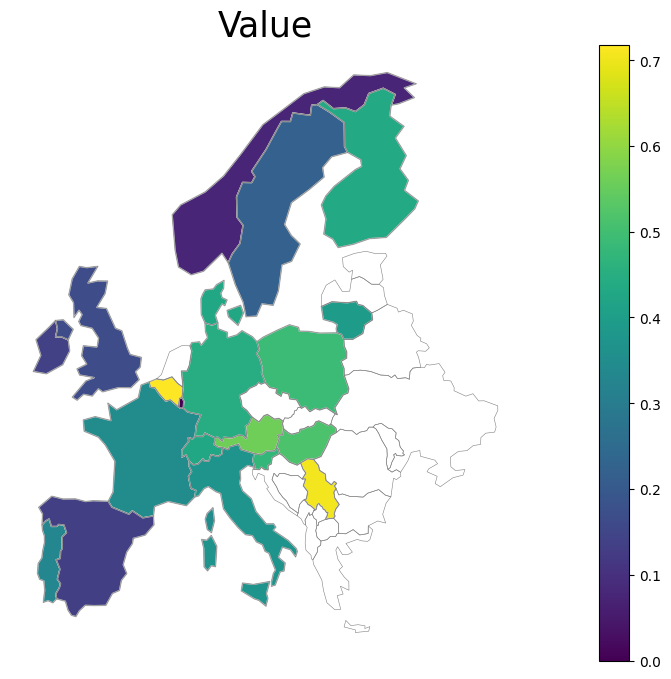

In [137]:
plot_map("Value", data[data["TRAFFIC_PARTICIPATION"] == "CYCLISTS"][data["Year"] == 2021][data["Measure"] == "Rate per hundred thousand population"][data["Age group"] == "Total"], free_legend=True)

/tmp/ipykernel_4739/827131856.py:1: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  plot_map("Value", data[data["TRAFFIC_PARTICIPATION"] == "PEDELECS"][data["Year"] == 2021][data["Measure"] == "Rate per hundred thousand population"][data["Age group"] == "Total"], free_legend=True)
/tmp/ipykernel_4739/827131856.py:1: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  plot_map("Value", data[data["TRAFFIC_PARTICIPATION"] == "PEDELECS"][data["Year"] == 2021][data["Measure"] == "Rate per hundred thousand population"][data["Age group"] == "Total"], free_legend=True)
/tmp/ipykernel_4739/827131856.py:1: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  plot_map("Value", data[data["TRAFFIC_PARTICIPATION"] == "PEDELECS"][data["Year"] == 2021][data["Measure"] == "Rate per hundred thousand population"][data["Age group"] == "Total"], free_legend=True)


0.0
1.0


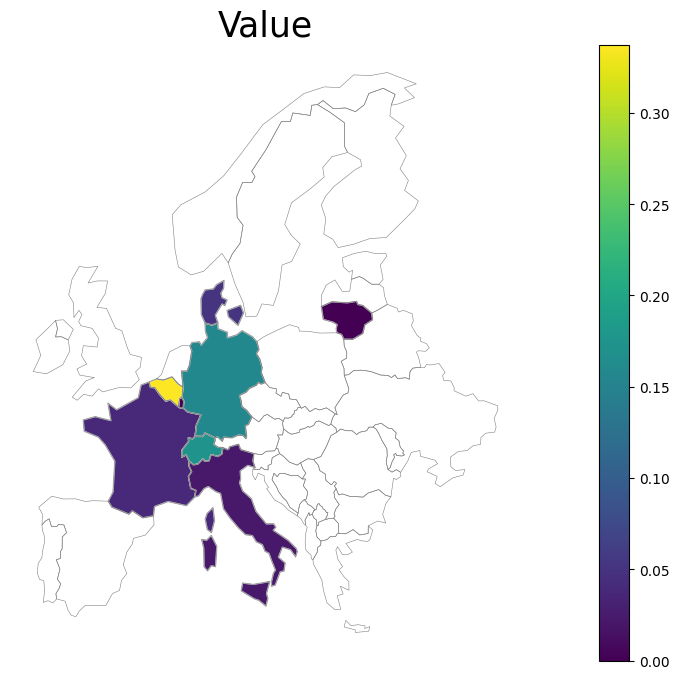

In [138]:
plot_map("Value", data[data["TRAFFIC_PARTICIPATION"] == "PEDELECS"][data["Year"] == 2021][data["Measure"] == "Rate per hundred thousand population"][data["Age group"] == "Total"], free_legend=True)

# ESRA

## E-Survey of Road users' Attitudes

publication: https://www.vias.be/publications/ESRA%202%20A%20global%20look%20at%20road%20safety/A%20global%20look%20at%20road%20safety%20-%20Synthesis%20from%20the%20ESRA2%20survey%20in%2048%20countries.pdf

dashboard: https://app.powerbi.com/view?r=eyJrIjoiM2Y5MzEwYTMtMTE1Mi00MzNkLWFlOWQtNmU2ZWNiM2RhYzJlIiwidCI6IjlkMWIxYjIyLWE5ZTAtNDg1Mi1hMTEwLWZlYzRmZDc1N2M2ZSIsImMiOjh9&pageName=ReportSection9fbd3f40b24badccab99

In [139]:
file = "esra.xlsx"

In [140]:
#world = gpd.read_file(gpd.datasets.get_path('naturalearth_lowres'))
#ax2 = world.plot( figsize=(8,4), edgecolor=u'gray', cmap='Set2' )
#world


world = gpd.read_file(gpd.datasets.get_path('naturalearth_lowres'))
world = world.overlay(bbox_gdf, how="intersection")
world = world[world["continent"] == "Europe"][~world["name"].isin(["Russia", "Svalbard", "Iceland", "French Guiana", "Suriname"])]

/home/goldmanes/.local/lib/python3.11/site-packages/geopandas/geodataframe.py:1415: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  result = super().__getitem__(key)


In [141]:
def plot_map(col, data, free_legend=False, lower=0.0, higher=1.0):
    #world = gpd.read_file(gpd.datasets.get_path('naturalearth_lowres'))
    #ax2 = world.plot( figsize=(8,4), edgecolor=u'gray', cmap='Set2' )
    
    world = gpd.read_file(gpd.datasets.get_path('naturalearth_lowres'))
    world = world.overlay(bbox_gdf, how="intersection")
    world = world[world["continent"] == "Europe"][~world["name"].isin(["Russia", "Svalbard", "Iceland", "French Guiana", "Suriname"])]

    merge_df = pd.merge(left=world, right=data, how="left", left_on="name", right_on="Country")

    vmin = lower#data[col].min()
    vmax = higher#data[col].max()
    cmap = "viridis"

    fig, ax = plt.subplots(1, figsize=(20, 8))
    ax.axis('off')
    if not free_legend:
        merge_df.plot(column=col, ax=ax, edgecolor='0.8', linewidth=1, cmap=cmap, legend=free_legend, vmin=lower, vmax=higher)
    else:
        merge_df.plot(column=col, ax=ax, edgecolor='0.8', linewidth=1, cmap=cmap, legend=free_legend)
    world.boundary.plot(ax=ax, linewidth=0.4, edgecolor=u'gray')

    ax.set_title(col, fontdict={'fontsize': '25', 'fontweight': '3'})

    if not free_legend:
        # Create colorbar as a legend
        sm = plt.cm.ScalarMappable(norm=plt.Normalize(vmin=vmin, vmax=vmax), cmap=cmap)
        # Empty array for the data range
        sm._A = []
        # Add the colorbar to the figure
        cbaxes = fig.add_axes([0.15, 0.25, 0.01, 0.4])
        cbar = fig.colorbar(sm, cax=cbaxes)

    plt.plot()

In [ ]:
def plot_map2(col, data, free_legend=False):
    #ax2 = world.plot( figsize=(8,4), edgecolor=u'gray', cmap='Set2' )

    world = gpd.read_file(gpd.datasets.get_path('naturalearth_lowres'))
    world = world.overlay(bbox_gdf, how="intersection")
    world = world[world["continent"] == "Europe"][~world["name"].isin(["Russia", "Svalbard", "Iceland", "French Guiana", "Suriname"])]

    merge_df = pd.merge(left=world, right=data, how="left", left_on="name", right_on="Country")

    vmin = merge_df[col].min() # Updated code
    print(vmin)
    vmax = merge_df[col].max() # Updated code
    print(vmax)
    cmap = "viridis"

    fig, ax = plt.subplots(1, figsize=(20, 8))
    ax.axis('off')
    if not free_legend:
        merge_df.plot(column=col, ax=ax, edgecolor='0.8', linewidth=1, cmap=cmap, legend=free_legend, vmin=vmin, vmax=vmax)
    else:
        merge_df.plot(column=col, ax=ax, edgecolor='0.8', linewidth=1, cmap=cmap, legend=free_legend)
    world.boundary.plot(ax=ax, linewidth=0.4, edgecolor=u'gray')

    ax.set_title(col, fontdict={'fontsize': '25', 'fontweight': '3'})

    if not free_legend:
        # Create colorbar as a legend
        sm = plt.cm.ScalarMappable(norm=plt.Normalize(vmin=vmin, vmax=vmax), cmap=cmap)
        # Empty array for the data range
        sm._A = []
        # Add the colorbar to the figure
        cbaxes = fig.add_axes([0.15, 0.25, 0.01, 0.4])
        cbar = fig.colorbar(sm, cax=cbaxes)


### Use of transport modes – a few days a month (Q10)
Table 5: Use of transport modes, by country and region (% at least a few days a month).

In [142]:
data = pd.read_excel(file,sheet_name=0)
data.rename(columns={"Column1" : "Country"}, inplace=True)
for col in data.columns[1:]:
    data[col] = data[col].str.rstrip("%").astype(float)/100
data.to_csv('csv/transport_modes_month.csv')
data

,Country,Pedestrian,Cyclist,Moped rider /motorcyclist,Car as driver,Car as a passenger,Public transport
0,Australia,0.889,0.209,0.076,0.804,0.722,0.456
1,Austria,0.976,0.491,0.122,0.490,0.371,0.332
2,Belgium,0.902,0.403,0.106,0.772,0.628,0.422
3,Benin,0.946,0.285,0.632,0.318,0.769,0.426
4,Bulgaria,0.909,0.414,0.151,0.683,0.821,0.670
5,Cameroon,0.956,0.255,0.618,0.431,0.990,0.637
6,Canada,0.829,0.284,0.095,0.773,0.713,0.380
7,Colombia,0.929,0.585,0.357,0.558,0.885,0.831
8,Czech Republic,0.928,0.349,0.107,0.606,0.660,0.641
9,Denmark,0.946,0.566,0.083,0.743,0.788,0.503


0.885
0.98


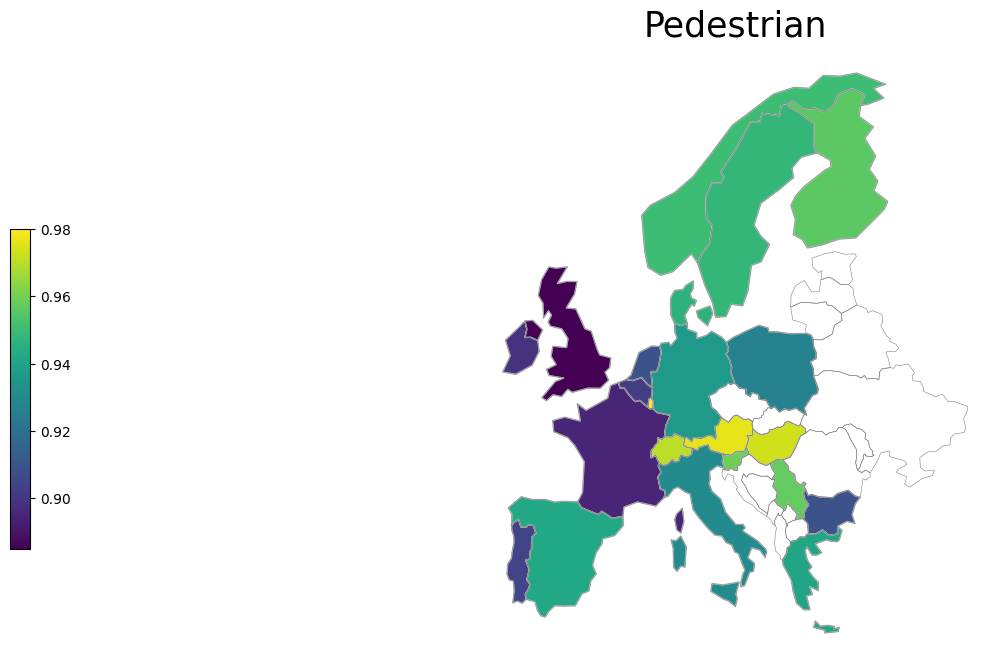

In [145]:
plot_map2("Pedestrian", data)


0.239
0.736


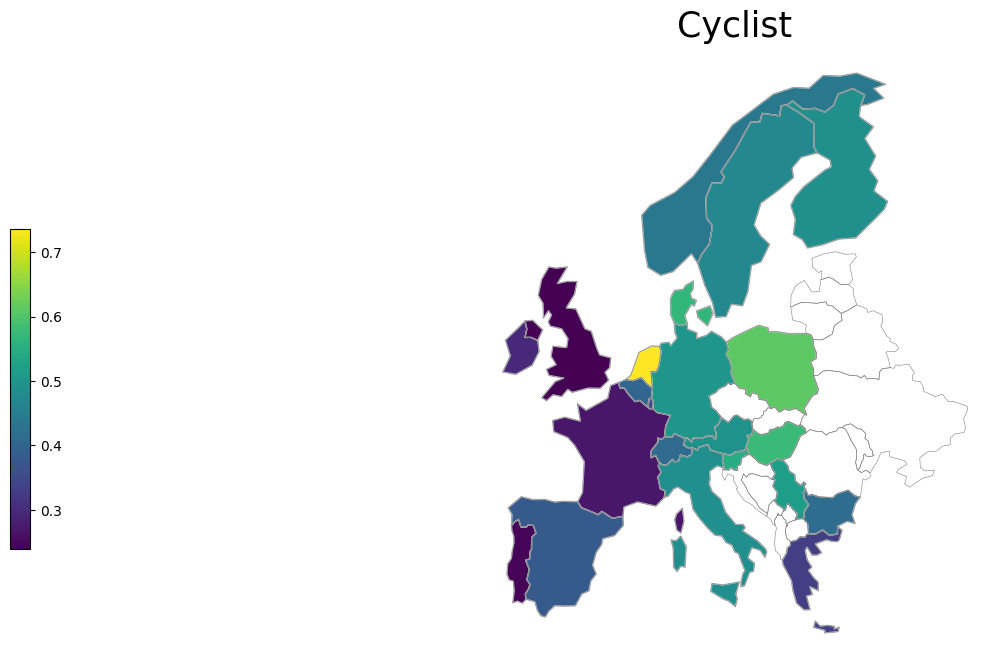

In [146]:
plot_map2("Cyclist", data)

0.49
0.91


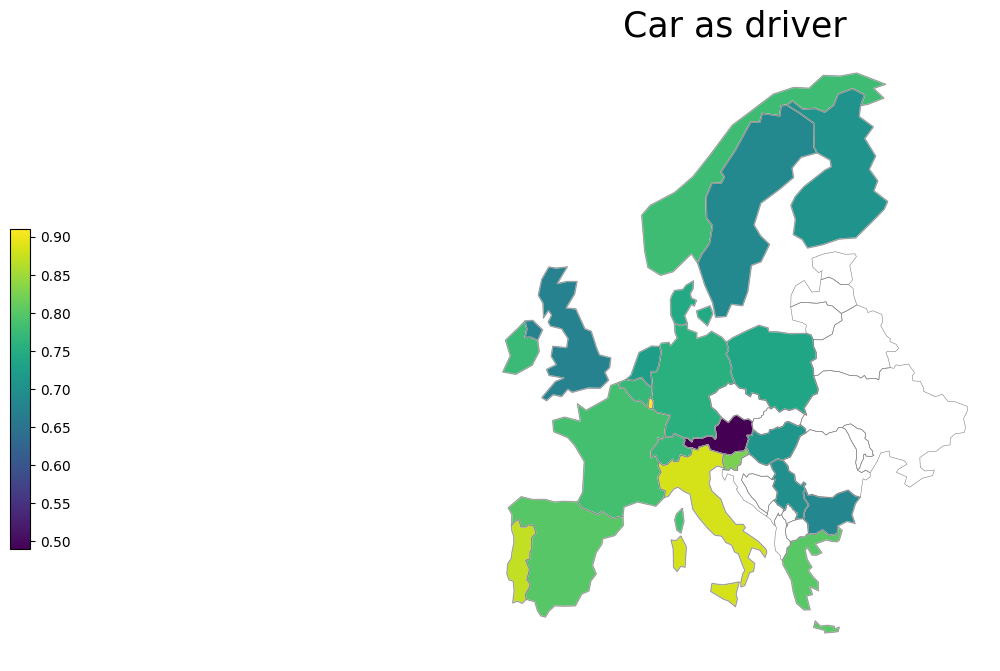

In [147]:
plot_map2("Car as driver", data)

0.371
0.895


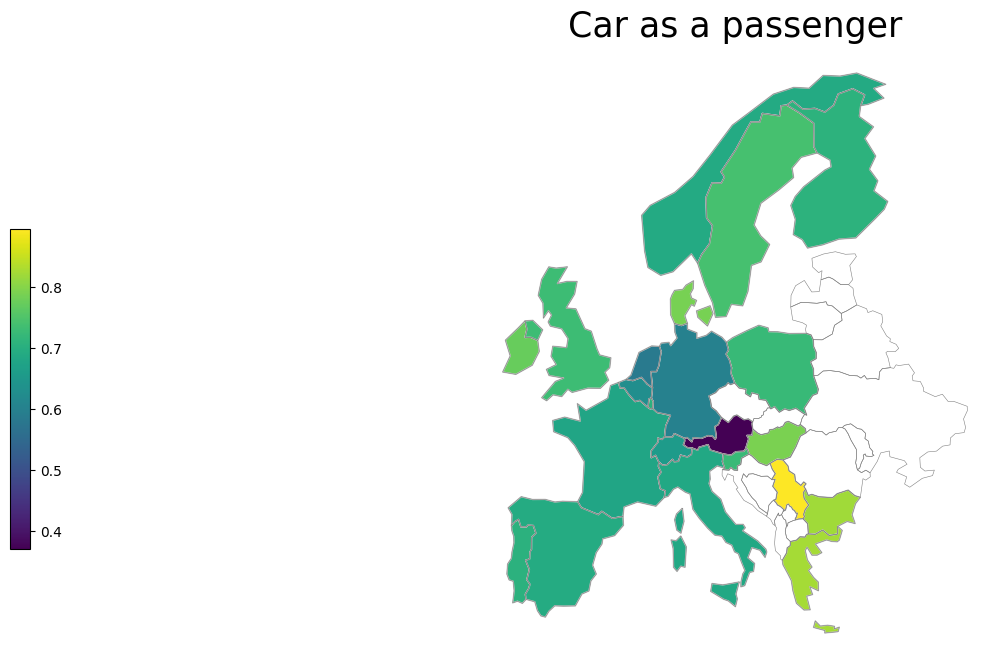

In [148]:
plot_map2("Car as a passenger", data)

0.332
0.6990000000000001


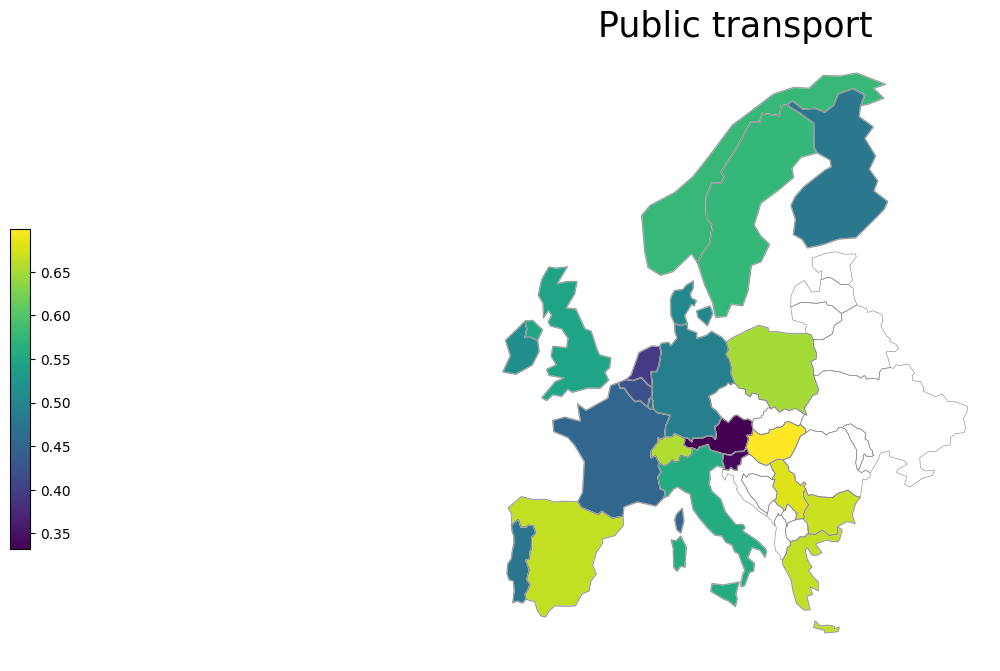

In [149]:
plot_map2("Public transport", data)

In [150]:
data = pd.read_excel(file,sheet_name=1)
data.rename(columns={"Column1" : "Country"}, inplace=True)
for col in data.columns[1:]:
    data[col] = data[col].str.rstrip("%").astype(float)/100
data.to_csv('csv/transport_modes_year.csv')
data

,Country,Pedestrian,Cyclist,Moped rider /motorcyclist,Car as driver,Car as a passenger,Public transport
0,Australia,0.938,0.331,0.112,0.836,0.925,0.813
1,Austria,0.993,0.700,0.212,0.576,0.614,0.610
2,Belgium,0.942,0.575,0.157,0.801,0.878,0.809
3,Benin,0.971,0.521,0.731,0.426,0.975,0.839
4,Bulgaria,0.938,0.643,0.280,0.744,0.975,0.963
5,Cameroon,0.985,0.441,0.657,0.539,0.995,0.922
6,Canada,0.896,0.497,0.139,0.807,0.939,0.772
7,Colombia,0.956,0.754,0.454,0.626,0.983,0.982
8,Czech Republic,0.975,0.600,0.245,0.688,0.967,0.964
9,Denmark,0.966,0.740,0.170,0.800,0.970,0.890


### Self-declared behaviour as car driver and car passenger (Q12_1b/Q12_2)
Table 7: Self-declared behaviour as a car driver/passenger, by country and region (% at least once in the past 30 days – scores 2 to 5 on a 5-point scale from
1 “never” to 5 “[almost] always”).

In [151]:
data = pd.read_excel(file,sheet_name=2)
data.rename(columns={"Column1" : "Country"}, inplace=True)
for col in data.columns[1:]:
    mask = data[col].str.contains("%", na=False)
    data[col][mask] = data[col][mask].str.rstrip("%").astype(float)/100
data.to_csv('csv/self_declared_behaviour_driver_passenger.csv')
data

,Country,drive when you may have been over the legal limit for drinking and driving,drive after drinking alcohol,drive 1 hour after using drugs (other than medication ),drive after taking medication that carries a warning that it may influence your driving ability,drive faster than the speed limit inside built-up areas,drive faster than the speed limit outside built-up areas (but not on motorways /freeways),drive faster than the speed limit on motorways /freeways,drive without wearing your seatbelt,transport children under 150cm* without using child restraint systems,transport children over 150cm* without wearing their seatbelts,as a car passenger travel without wearing your seatbelt in the back seat,talk on a hand-held mobile phone while driving,talk on a hands-free mobile phone while driving,read a text message/e mail or check social media while driving,drive when you were so sleepy that you had trouble keeping your eyes open
0,Australia,0.089,0.237,0.059,0.134,0.446,0.506,0.493,0.063,0.079,0.059,0.1,0.125,0.413,0.19,0.17
1,Austria,0.148,0.305,0.073,0.22,0.714,0.825,0.77,0.199,0.148,0.098,0.437,0.365,0.636,0.342,0.318
2,Belgium,0.242,0.331,0.071,0.181,0.617,0.721,0.683,0.142,0.144,0.12,0.301,0.222,0.455,0.281,0.244
3,Benin,0.247,0.377,0.195,0.221,0.312,0.558,0.416,0.364,0.579,0.6,0.694,0.481,0.701,0.221,0.143
4,Bulgaria,0.051,0.093,0.035,0.101,0.491,0.552,0.44,0.337,0.19,0.216,0.58,0.385,0.522,0.249,0.193
5,Cameroon,0.239,0.27,0.09,0.159,0.398,0.472,0.443,0.614,0.545,0.556,0.866,0.364,0.625,0.33,0.091
6,Canada,0.145,0.259,0.128,0.167,0.664,0.751,0.786,0.16,0.199,0.155,0.252,0.214,0.436,0.26,0.22
7,Colombia,0.11,0.136,0.044,0.102,0.387,0.481,0.489,0.204,0.33,0.232,0.767,0.361,0.674,0.416,0.178
8,Czech Republic,0.119,0.072,0.027,0.115,0.683,0.783,0.711,0.277,0.152,0.117,0.493,0.337,0.406,0.268,0.219
9,Denmark,0.116,0.267,0.042,0.122,0.618,0.818,0.741,0.129,0.308,0.09,0.202,0.244,0.421,0.29,0.241


In [162]:
world = gpd.read_file(gpd.datasets.get_path('naturalearth_lowres'))
world = world.overlay(bbox_gdf, how="intersection")
world = world[world["continent"] == "Europe"][~world["name"].isin(["Russia", "Svalbard", "Iceland", "French Guiana", "Suriname"])]

merge_df = pd.merge(left=world, right=data, how="left", left_on="name", right_on="Country")

merge_df

/home/goldmanes/.local/lib/python3.11/site-packages/geopandas/geodataframe.py:1415: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  result = super().__getitem__(key)


,pop_est,continent,name,iso_a3,gdp_md_est,geometry,Country,drive when you may have been over the legal limit for drinking and driving,drive after drinking alcohol,drive 1 hour after using drugs (other than medication ),...,drive faster than the speed limit outside built-up areas (but not on motorways /freeways),drive faster than the speed limit on motorways /freeways,drive without wearing your seatbelt,transport children under 150cm* without using child restraint systems,transport children over 150cm* without wearing their seatbelts,as a car passenger travel without wearing your seatbelt in the back seat,talk on a hand-held mobile phone while driving,talk on a hands-free mobile phone while driving,read a text message/e mail or check social media while driving,drive when you were so sleepy that you had trouble keeping your eyes open
0,5347896.0,Europe,Norway,NOR,403336,"POLYGON ((29.39955 69.15692, 28.59193 69.06478...",Norway,0.085,0.059,0.057,...,0.784,0.79,0.129,0.16,0.114,0.218,0.329,0.625,0.361,0.234
1,67059887.0,Europe,France,FRA,2715518,"MULTIPOLYGON (((9.39000 43.00998, 9.56002 42.1...",France,0.223,0.289,0.063,...,0.746,0.673,0.123,0.148,0.077,0.227,0.258,0.363,0.281,0.185
2,10285453.0,Europe,Sweden,SWE,530883,"POLYGON ((11.46827 59.43239, 12.30037 60.11793...",Sweden,0.069,0.077,0.047,...,0.785,0.805,0.162,0.146,0.09,0.277,0.311,0.538,0.248,0.243
3,9466856.0,Europe,Belarus,BLR,63080,"POLYGON ((29.22951 55.91834, 29.37157 55.67009...",NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
4,44385155.0,Europe,Ukraine,UKR,153781,"POLYGON ((32.41206 52.28869, 32.71576 52.23847...",NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
5,37970874.0,Europe,Poland,POL,595858,"POLYGON ((23.52754 53.47012, 23.80493 53.08973...",Poland,0.064,0.068,0.029,...,0.735,0.557,0.274,0.184,0.172,0.507,0.421,0.596,0.267,0.196
6,8877067.0,Europe,Austria,AUT,445075,"POLYGON ((16.90375 47.71487, 16.34058 47.71290...",Austria,0.148,0.305,0.073,...,0.825,0.77,0.199,0.148,0.098,0.437,0.365,0.636,0.342,0.318
7,9769949.0,Europe,Hungary,HUN,163469,"POLYGON ((22.64082 48.15024, 22.71053 47.88219...",Hungary,0.039,0.054,0.022,...,0.668,0.566,0.275,0.142,0.147,0.598,0.291,0.524,0.171,0.203
8,2657637.0,Europe,Moldova,MDA,11968,"POLYGON ((26.85782 48.36821, 27.52254 48.46712...",NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
9,19356544.0,Europe,Romania,ROU,250077,"POLYGON ((28.67978 45.30403, 29.14972 45.46493...",NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN


In [161]:
merge_df.dropna(subset=["pop_est"], inplace=True)
merge_df.reset_index(drop=True, inplace=True)


# Extract data for plotting
x = merge_df['Country']
#y = merge_df["drive when you may have been over the legal limit for drinking and driving"]
y = merge_df["pop_est"]


# Create bar chart using Matplotlib
#plt.bar(x, y)
#plt.rcParams['figure.figsize'] = [30, 15]
# Rotate x-axis labels to be vertical
#plt.xticks(rotation=90)


#plt.xlabel('Countries')
#plt.ylabel('drive and drinking, 2019')
#plt.show()

print(x)
print(y)

0             Norway
1             France
2             Sweden
3                NaN
4                NaN
5             Poland
6            Austria
7            Hungary
8                NaN
9                NaN
10               NaN
11               NaN
12               NaN
13           Germany
14          Bulgaria
15            Greece
16               NaN
17               NaN
18       Switzerland
19        Luxembourg
20           Belgium
21       Netherlands
22          Portugal
23             Spain
24           Ireland
25             Italy
26           Denmark
27    United Kingdom
28          Slovenia
29           Finland
30               NaN
31               NaN
32               NaN
33               NaN
34            Serbia
35               NaN
36               NaN
Name: Country, dtype: object
0      5347896.0
1     67059887.0
2     10285453.0
3      9466856.0
4     44385155.0
5     37970874.0
6      8877067.0
7      9769949.0
8      2657637.0
9     19356544.0
10     2786844.0
11     

/home/goldmanes/.local/lib/python3.11/site-packages/geopandas/geodataframe.py:1415: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  result = super().__getitem__(key)
/home/goldmanes/.local/lib/python3.11/site-packages/geopandas/geodataframe.py:1415: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  result = super().__getitem__(key)
/home/goldmanes/.local/lib/python3.11/site-packages/geopandas/geodataframe.py:1415: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  result = super().__getitem__(key)
/home/goldmanes/.local/lib/python3.11/site-packages/geopandas/geodataframe.py:1415: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  result = super().__getitem__(key)
/home/goldmanes/.local/lib/python3.11/site-packages/geopandas/geodataframe.py:1415: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  result = super().__getitem__(key)
/home/goldmanes/.loc

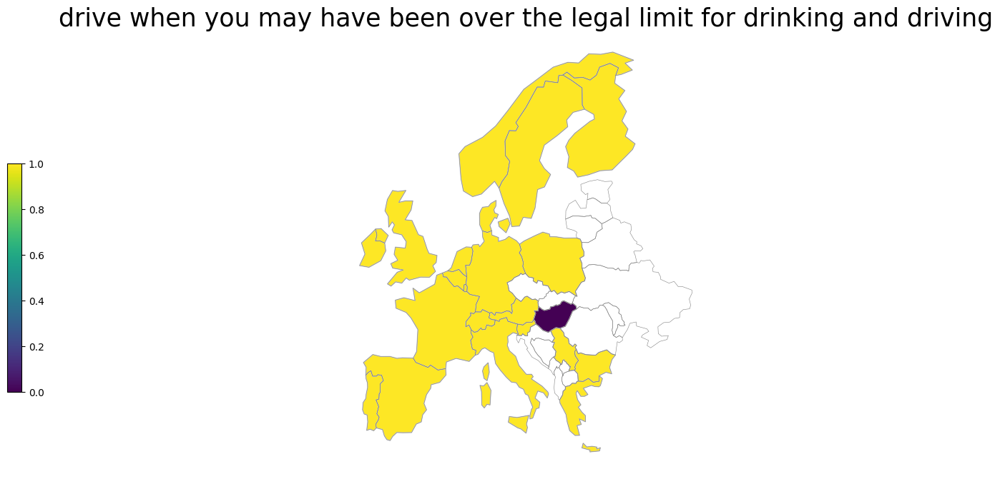

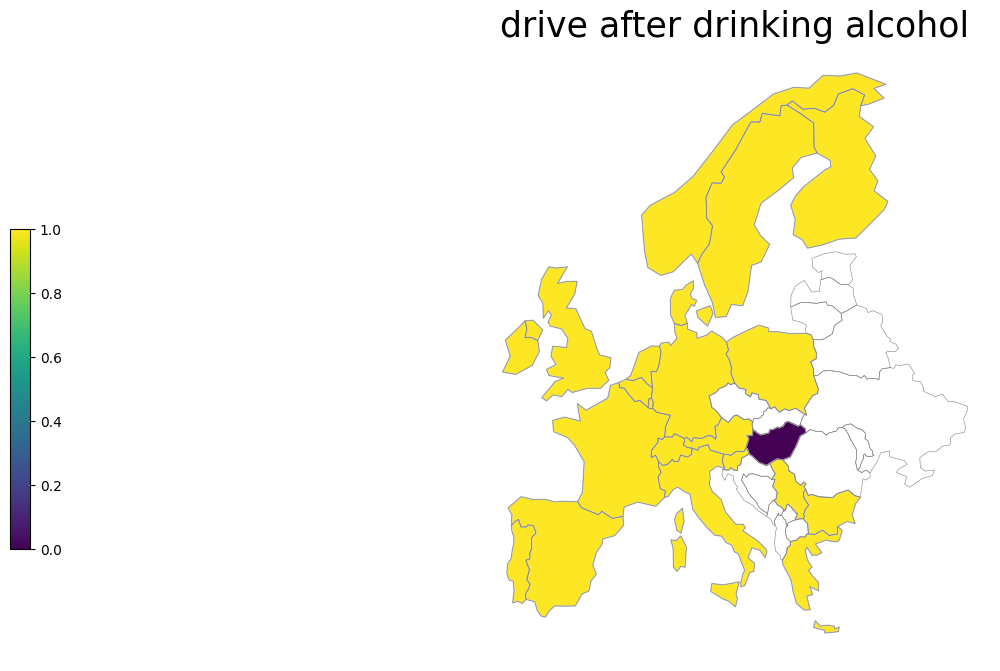

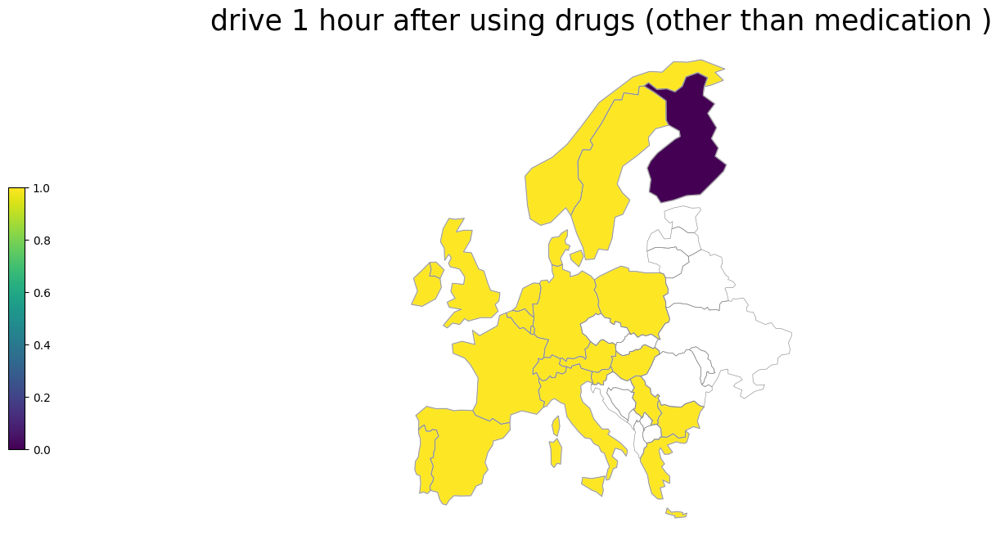

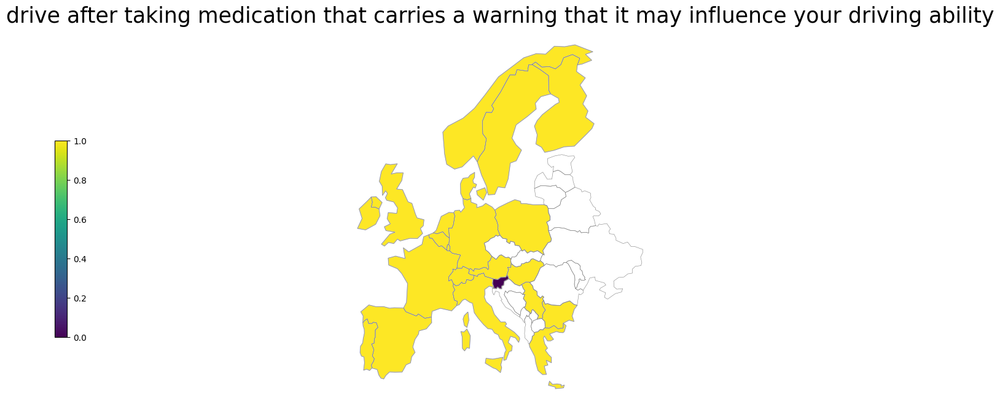

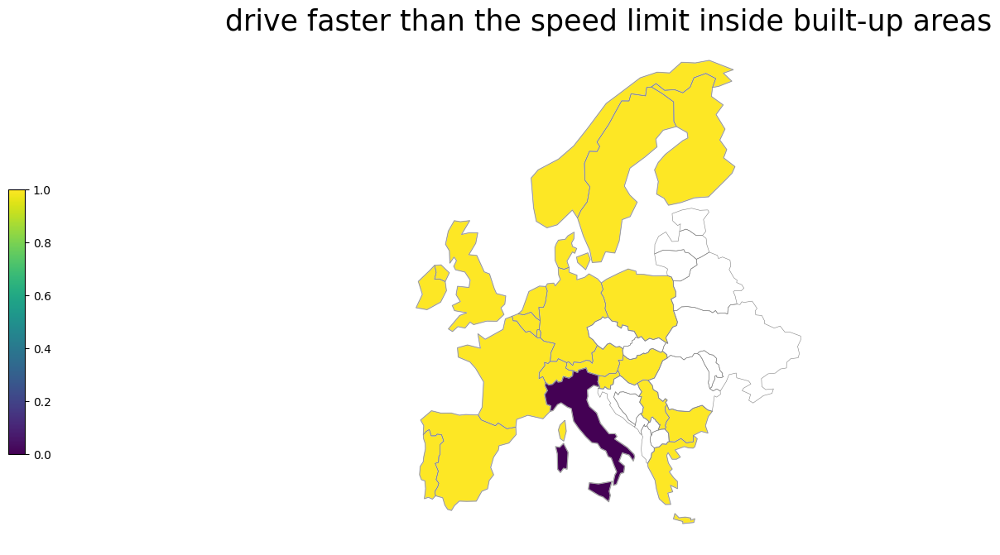

...

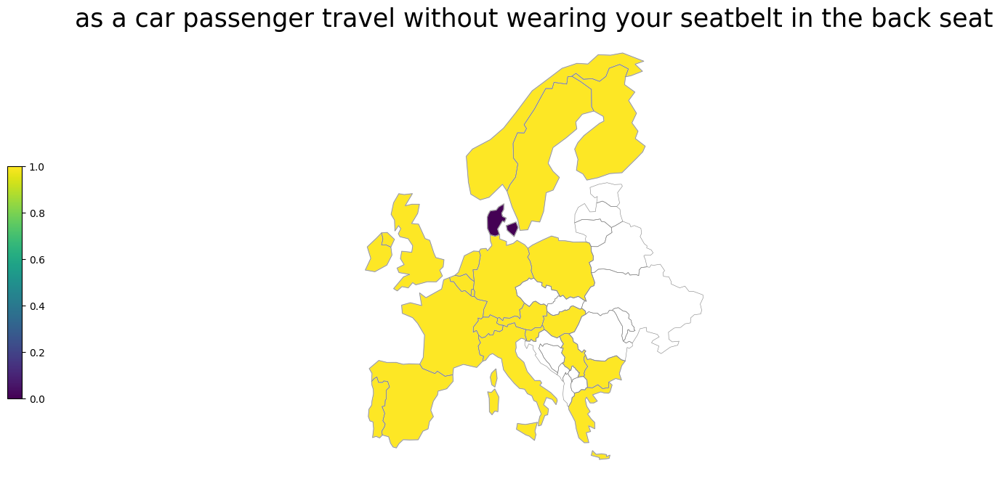

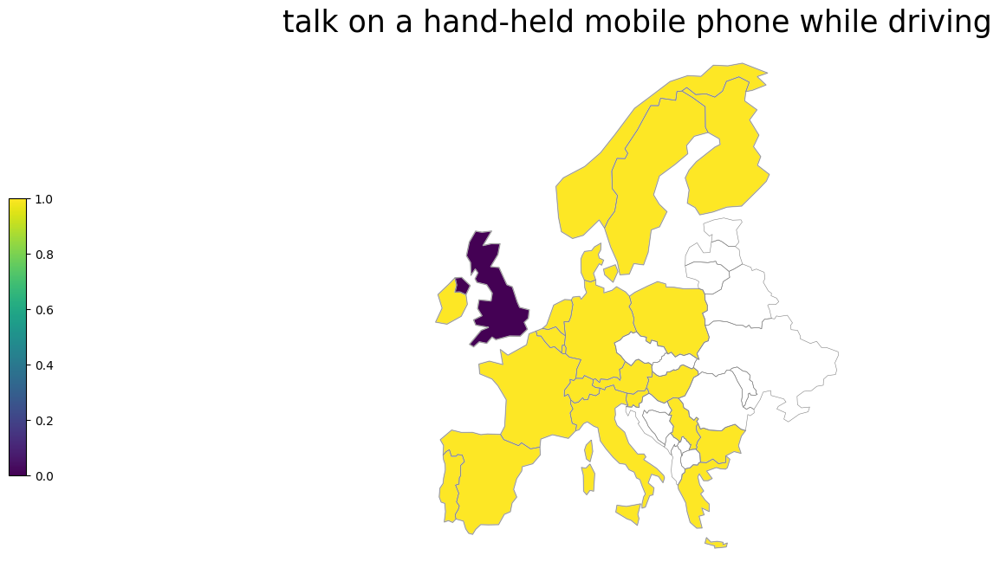

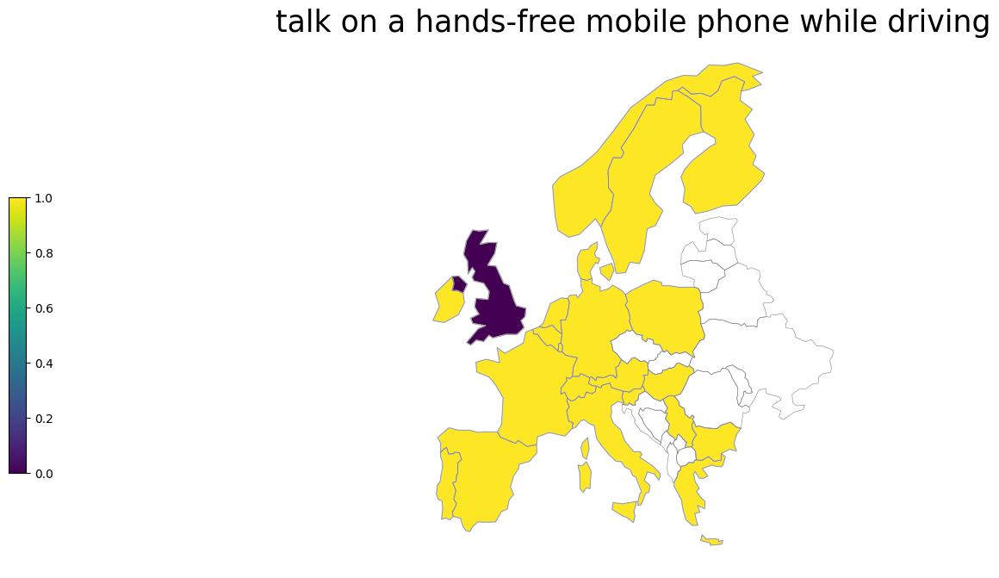

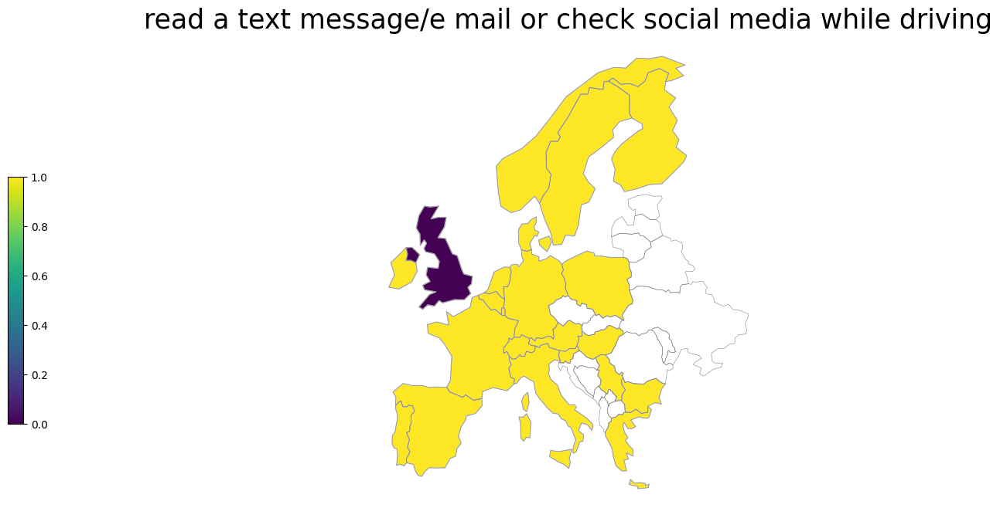

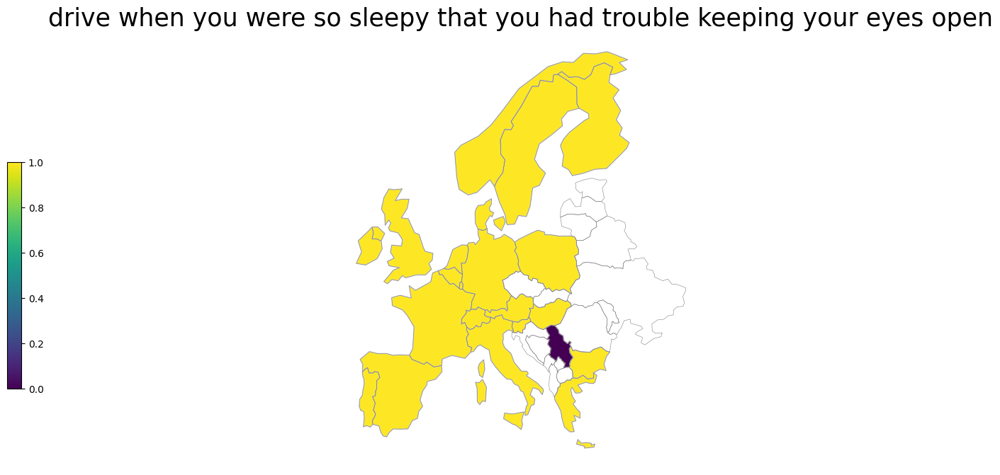

In [153]:
for i in range(len(data.columns)-1):
    plot_map2(data.columns[1+i], data)

In [28]:
data = pd.read_excel(file,sheet_name=3)
data.rename(columns={"Column1" : "Country"}, inplace=True)
for col in data.columns[1:]:
    mask = data[col].str.contains("%", na=False)
    data[col][mask] = data[col][mask].str.rstrip("%").astype(float)/100
data.to_csv('csv/self_declared_behaviour_moped_motor_cyclist_pedestrian.csv')
data

,Country,ride when you may have been over the legal limit for drinking and driving,ride faster than the speed limit outside built-up areas (but not on motorways/fr eeways),ride a moped or motorcycle without a helmet,read a text message/emai l or check social media while riding a moped or motorcycle,cycle when you think you may have had too much to drink,cycle without a helmet,cycle while listening to music through headphones,read a text message/em ail or check social media while cycling,cycle on the road next to the cycle lane,listen to music through headphones as a pedestrian while walking in the streets,read a text message/em ail or check social media while walking in the streets,cross the road when a pedestrian light is red,cross the road at places other than at a nearby (distance <30m*) pedestrian crossing
0,Australia,0.307,0.459,0.293,0.297,0.149,0.297,0.371,0.174,0.347,0.338,0.523,0.416,0.653
1,Austria,0.218,0.523,0.198,0.185,0.178,0.691,0.214,0.144,0.359,0.274,0.607,0.43,0.718
2,Belgium,0.213,0.424,0.233,0.218,0.282,0.828,0.283,0.225,0.372,0.274,0.555,0.429,0.715
3,Benin,0.144,0.34,0.314,0.209,0.217,0.485,0.391,0.174,0.464,0.581,0.742,0.364,0.623
4,Bulgaria,0.098,0.327,0.303,0.164,0.067,0.675,0.303,0.13,0.546,0.317,0.565,0.248,0.634
5,Cameroon,0.167,0.288,0.46,0.152,0.173,0.731,0.423,0.269,0.442,0.621,0.81,0.482,0.79
6,Canada,0.527,0.634,0.495,0.505,0.219,0.516,0.388,0.238,0.435,0.377,0.477,0.456,0.693
7,Colombia,0.097,0.387,0.343,0.215,0.128,0.546,0.577,0.219,0.571,0.59,0.614,0.507,0.721
8,Czech Republic,0.094,0.419,0.217,0.076,0.264,0.701,0.235,0.128,0.295,0.288,0.62,0.377,0.777
9,Denmark,0.28,0.549,0.378,0.256,0.278,0.72,0.339,0.226,0.305,0.354,0.584,0.458,0.698


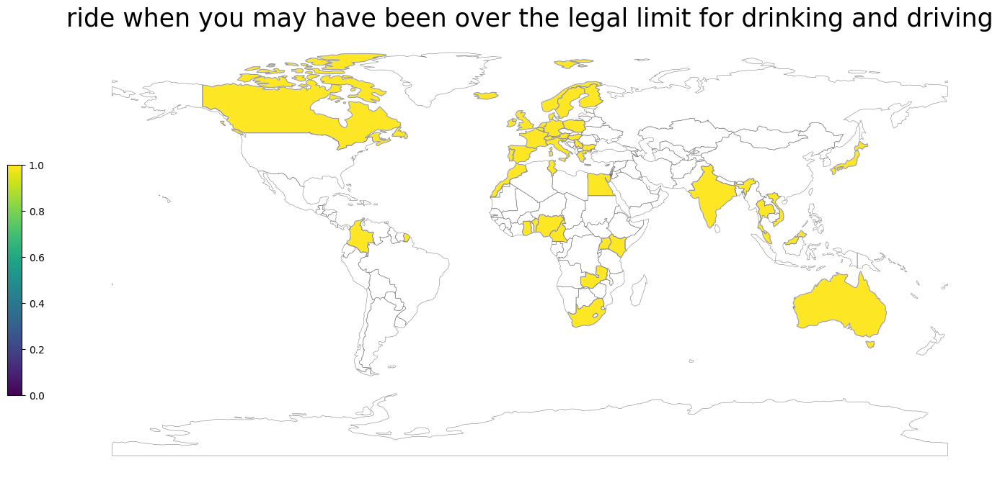

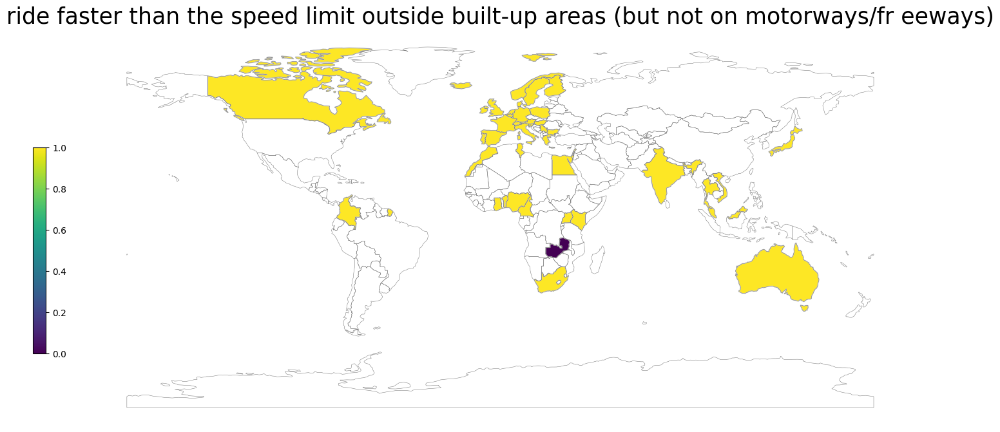

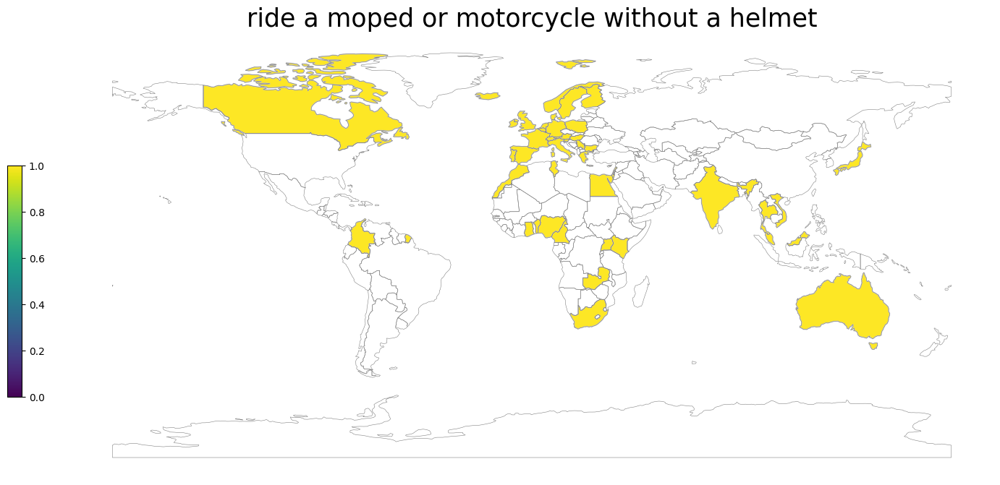

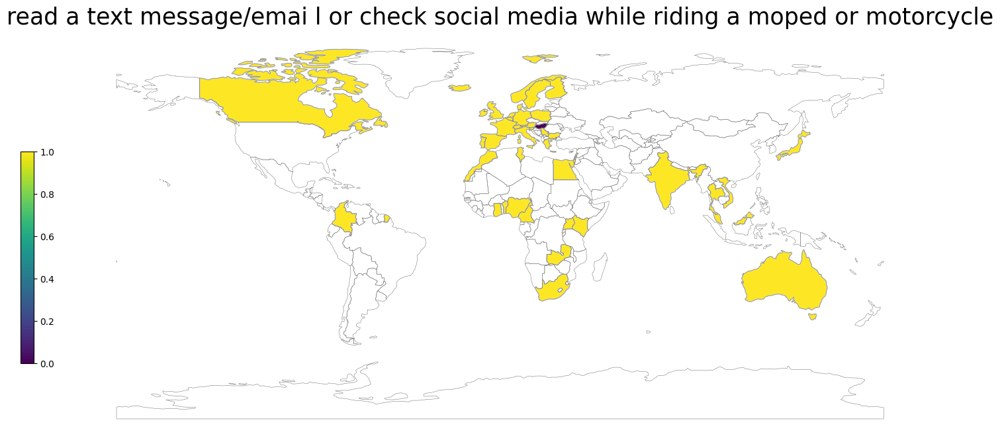

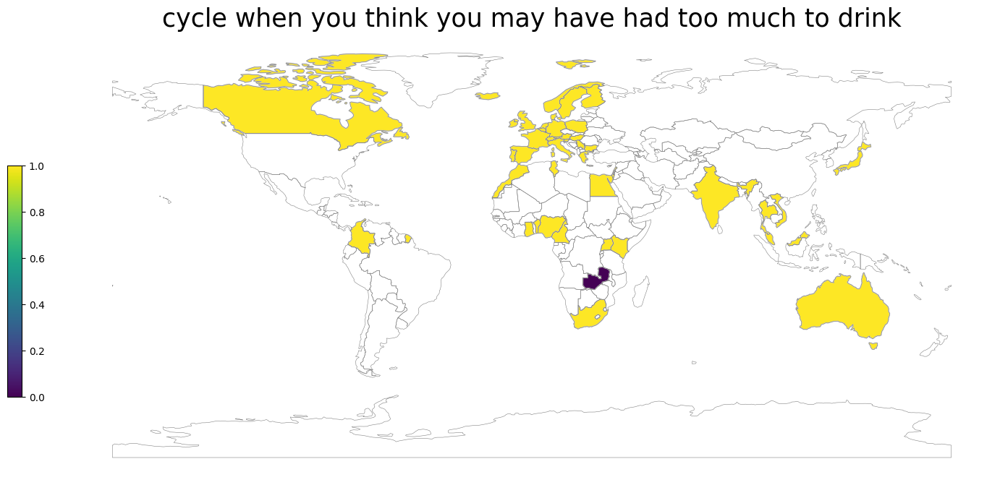

...

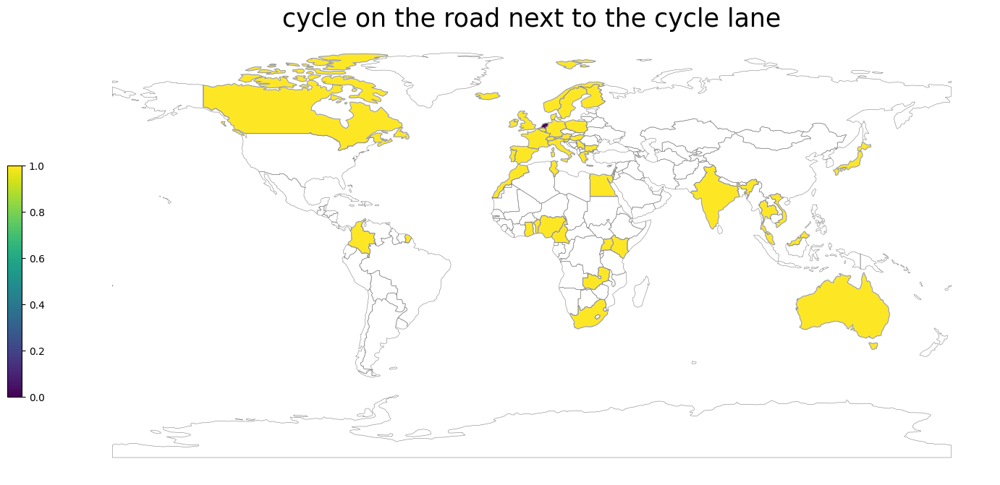

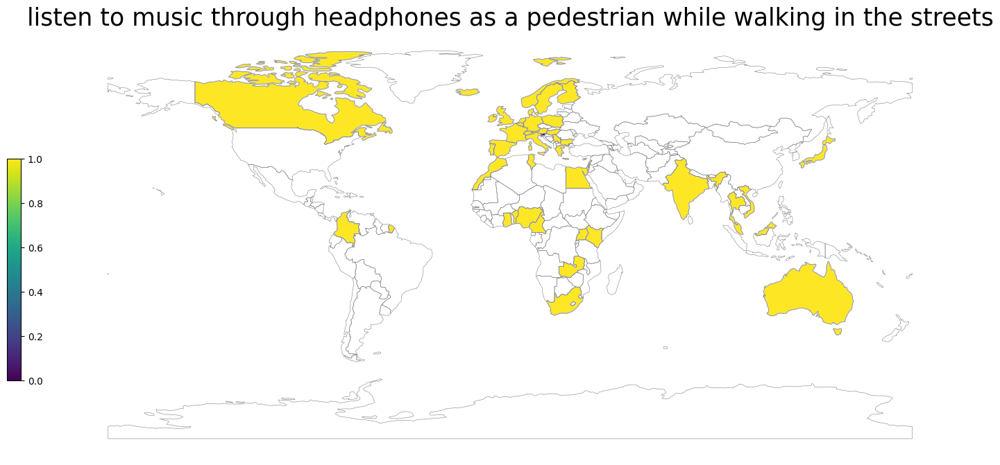

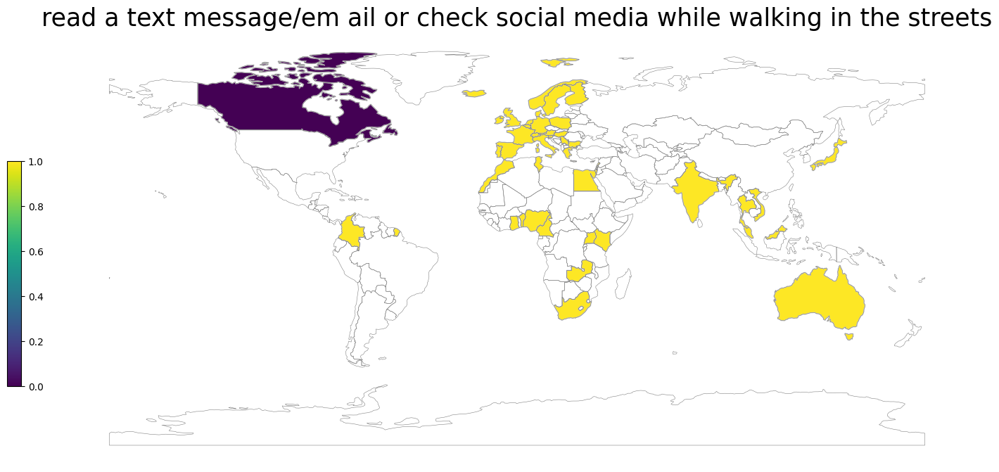

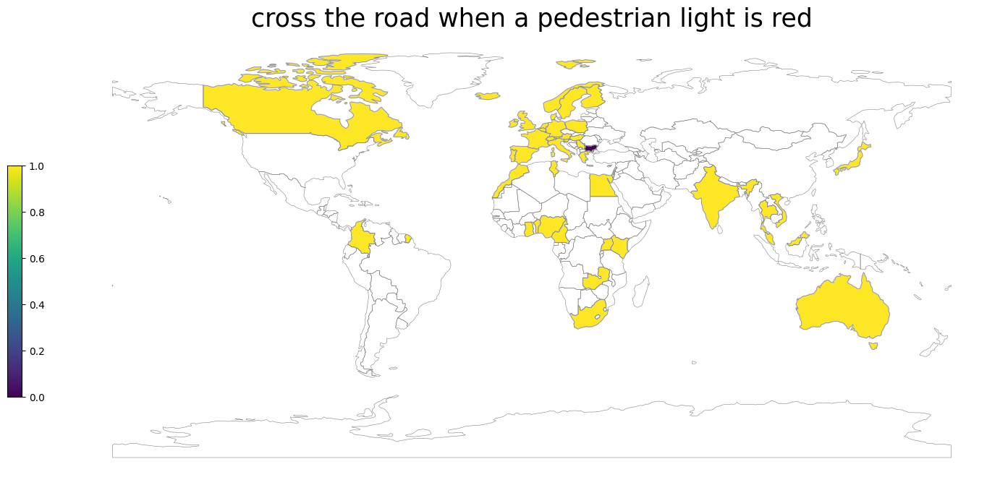

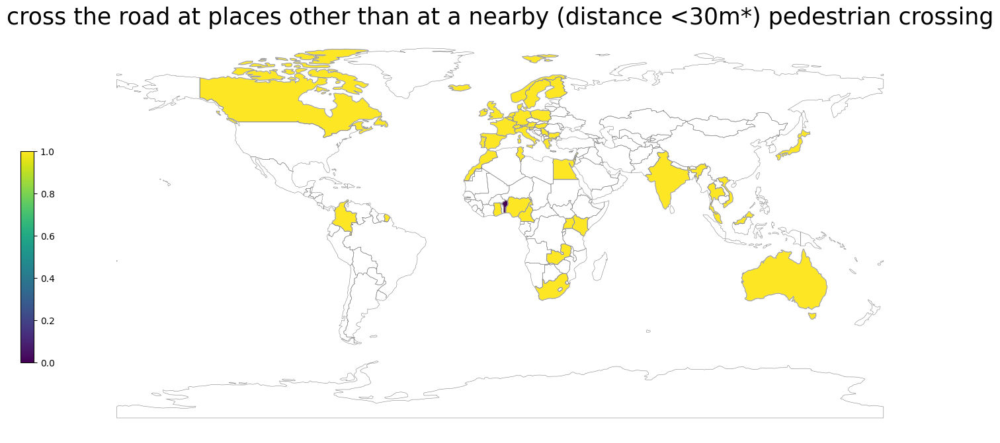

In [31]:
for i in range(len(data.columns)-1):
    plot_map(data.columns[1+i], data)

### Social acceptability (Q13)
Table 9: Social acceptability of unsafe behaviour in traffic, by country and region (“Where you live, how acceptable would most other people say it is for a CAR
DRIVER to…” – % of acceptability – scores 4 and 5 on a 5-point scale from 1 “unacceptable” to 5 “acceptable”).

In [32]:
data = pd.read_excel(file,sheet_name=4)
data.rename(columns={"Column1" : "Country"}, inplace=True)
for col in data.columns[1:]:
    mask = data[col].str.contains("%", na=False)
    data[col][mask] = data[col][mask].str.rstrip("%").astype(float)/100
data.to_csv('csv/social_acceptability.csv')
data

,Country,drive when he/she may be over the legal limit for drinking and driving,drive 1 hour after using drugs (other than medication),drive faster than the speed limit outside built-up areas (but not on motorways/ freeways),not wear a seatbelt while driving,"transport children in the car without securing them (child’s car seat, seatbelt, etc.)",talk on a hand-held mobile phone while driving,"read a text message/email or check social media (e.g. Facebook, twitter, etc.) while driving"
0,Australia,0.027,0.034,0.083,0.018,0.023,0.044,0.04
1,Austria,0.066,0.038,0.292,0.114,0.049,0.175,0.093
2,Belgium,0.046,0.033,0.146,0.061,0.034,0.06,0.04
3,Benin,0.066,0.058,0.116,0.202,0.182,0.124,0.116
4,Bulgaria,0.054,0.038,0.177,0.155,0.098,0.205,0.115
5,Cameroon,0.167,0.103,0.279,0.446,0.358,0.181,0.137
6,Canada,0.037,0.04,0.136,0.045,0.042,0.058,0.051
7,Colombia,0.029,0.025,0.087,0.083,0.104,0.057,0.067
8,Czech Republic,0.012,0.009,0.086,0.056,0.018,0.033,0.019
9,Denmark,0.017,0.019,0.132,0.041,0.014,0.033,0.03


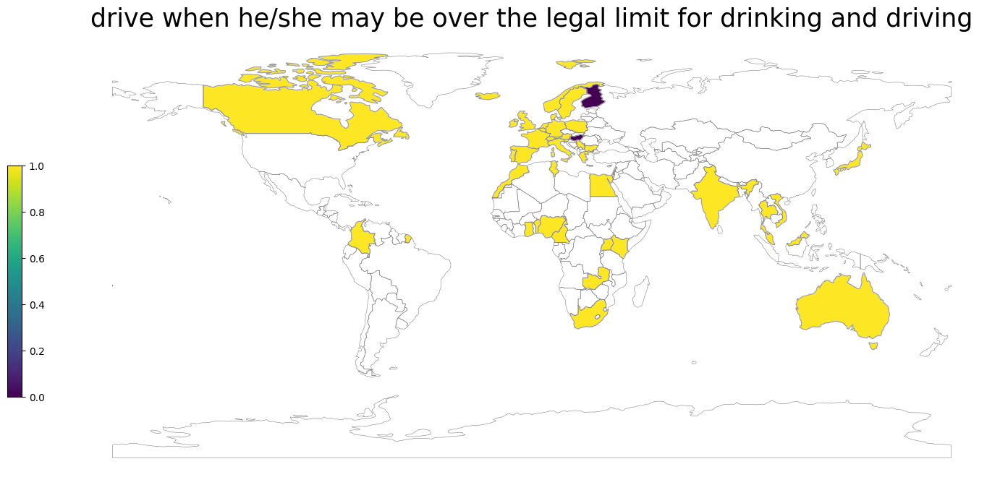

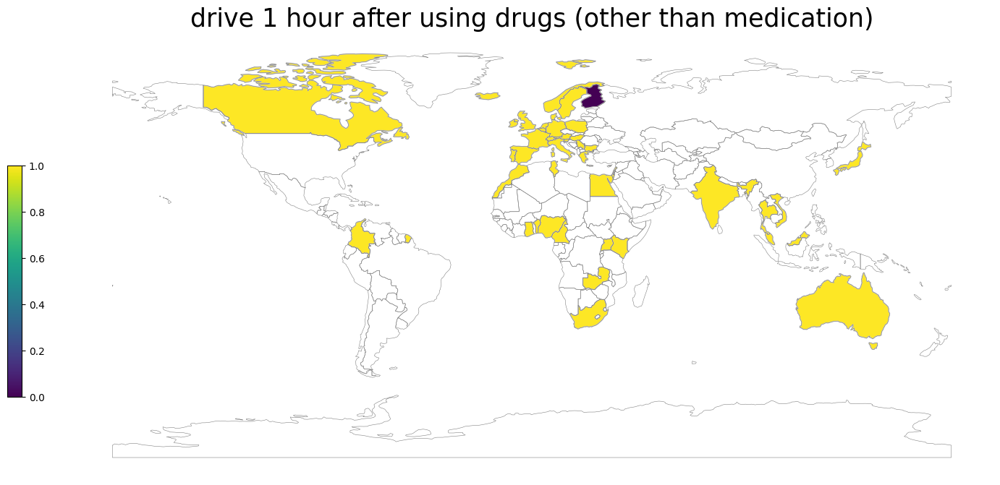

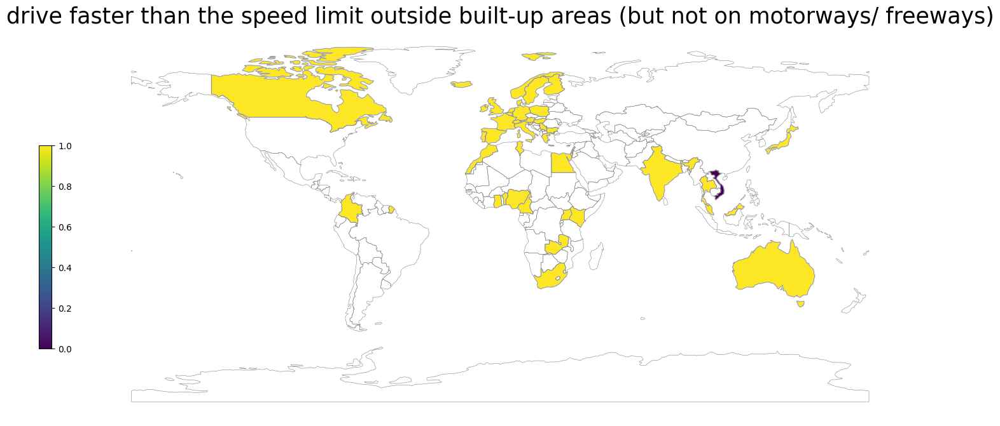

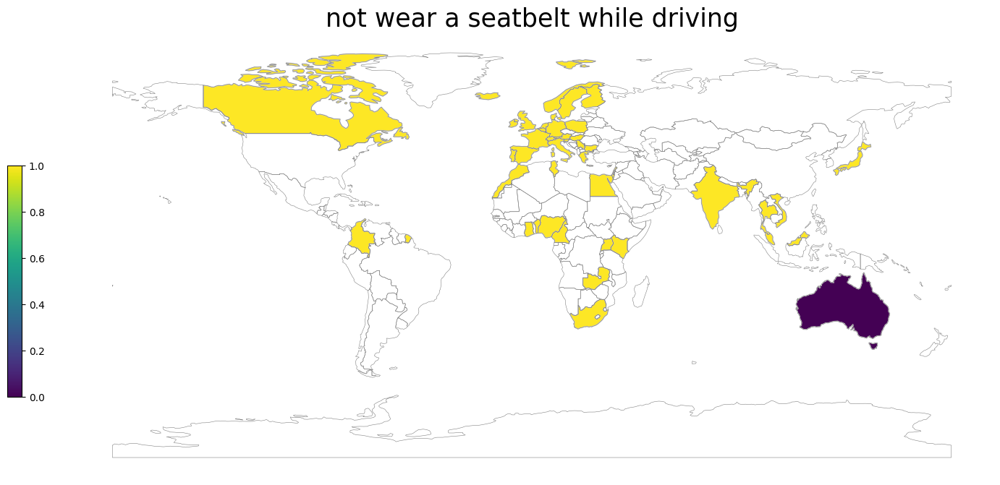

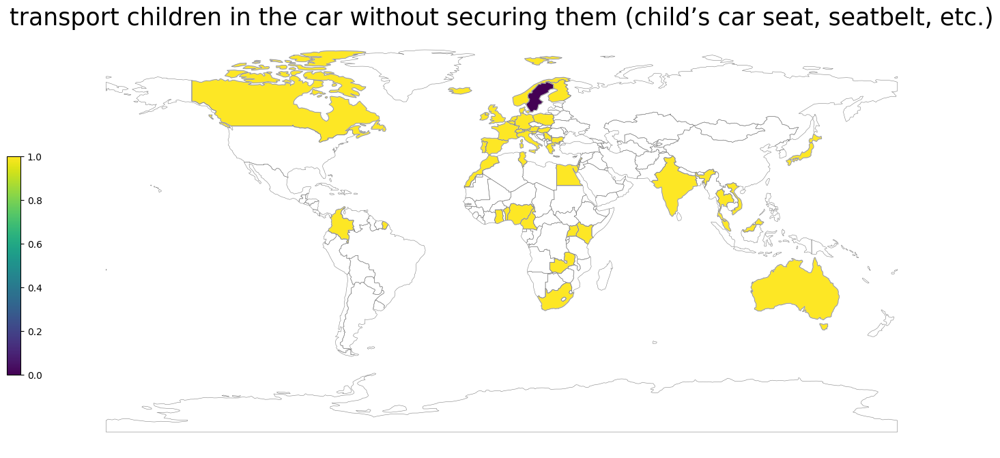

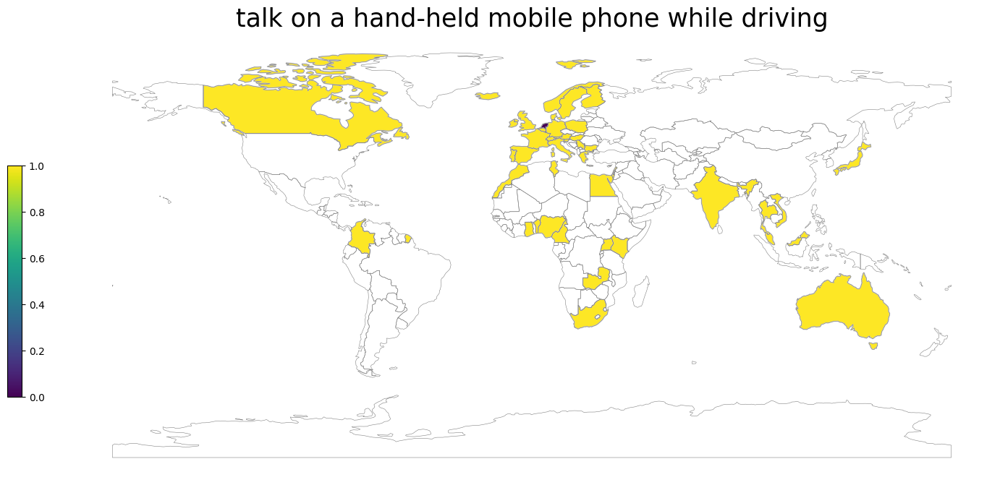

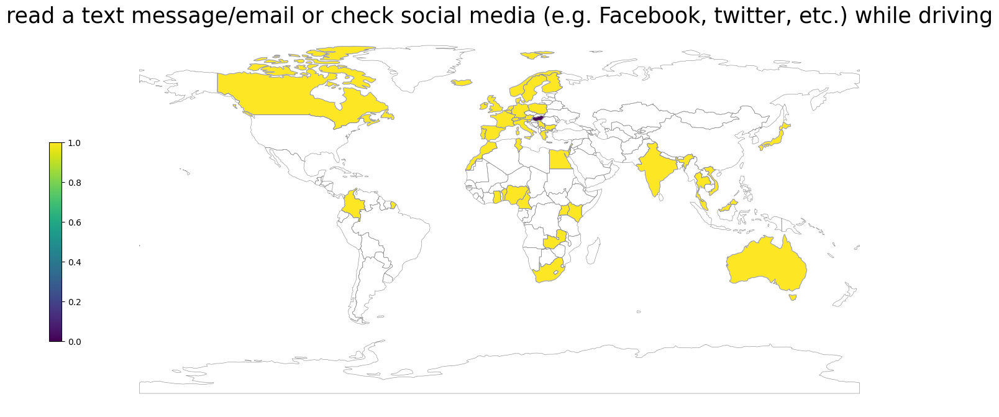

In [33]:
for i in range(len(data.columns)-1):
    plot_map(data.columns[1+i], data)

### Personal acceptability (Q14)
Table 10: Personal acceptability of unsafe behaviour in traffic, by country and region (“How acceptable do you, personally, feel it is for a CAR DRIVER to…” –
% of acceptability – scores 4 and 5 on a 5-point scale from 1 “unacceptable” to 5 “acceptable”).

In [34]:
data = pd.read_excel(file,sheet_name=5)
data.rename(
    columns={
    "Column1" : "Country",
    "Column2" : "drive when he/she may be over the legal limit for drinking and driving",
    "Column3" : "drive 1 hour after using drugs (other than medication)",
    "Column4" : "drive after taking a medication that may influence the ability to drive",
    "Column5" : "drive faster than the speed limit inside builtup areas",
    "Column6" : "drive faster than the speed limit outside builtup areas (but not on motorways/freeways)",
    "Column7" : "drive faster than the speed limit on motorways/freeways",
    "Column8" : "not wear a seatbelt while driving",
    "Column9" : "transport children in the car without securing them (child’s car seat, seatbelt, etc.)",
    "Column10" : "talk on a hand-held mobile phone while driving",
    "Column11" : "talk on a hand-free mobile phone while driving",
    "Column12" : "read a text message/email or check social media while driving",
    "Column13" : "drive when they’re so sleepy that they have trouble keeping their eyes open",
    "Column14" : "Country",
    }, inplace=True)
data = data.drop([0,1]).reset_index(drop=True)
for col in data.columns[1:]:
    mask = data[col].str.contains("%2", na=False)
    data[col][mask] = data[col][mask].str.rstrip("2")
for col in data.columns[1:]:
    mask = data[col].str.contains("%", na=False)
    data[col][mask] = data[col][mask].str.rstrip("%").astype(float)/100
data.to_csv('csv/personal_acceptability.csv')
data

,Country,drive when he/she may be over the legal limit for drinking and driving,drive 1 hour after using drugs (other than medication),drive after taking a medication that may influence the ability to drive,drive faster than the speed limit inside builtup areas,drive faster than the speed limit outside builtup areas (but not on motorways/freeways),drive faster than the speed limit on motorways/freeways,not wear a seatbelt while driving,"transport children in the car without securing them (child’s car seat, seatbelt, etc.)",talk on a hand-held mobile phone while driving,talk on a hand-free mobile phone while driving,read a text message/email or check social media while driving,drive when they’re so sleepy that they have trouble keeping their eyes open
0,Australia,0.018,0.022,0.012,0.031,0.061,0.07,0.022,0.017,0.028,0.243,0.017,0.021
1,Austria,0.026,0.021,0.038,0.105,0.221,0.29,0.057,0.026,0.074,0.351,0.031,0.027
2,Belgium,0.031,0.018,0.023,0.06,0.117,0.18,0.039,0.016,0.019,0.323,0.017,0.013
3,Benin,0.029,0.037,0.062,0.017,0.045,0.095,0.07,0.079,0.05,0.202,0.058,0.021
4,Bulgaria,0.02,0.011,0.016,0.033,0.059,0.066,0.06,0.025,0.054,0.373,0.024,0.018
5,Cameroon,0.034,0.044,0.044,0.034,0.103,0.113,0.142,0.103,0.059,0.314,0.054,0.025
6,Canada,0.03,0.042,0.032,0.072,0.118,0.194,0.048,0.029,0.048,0.243,0.03,0.029
7,Colombia,0.011,0.009,0.014,0.025,0.055,0.06,0.024,0.032,0.02,0.196,0.021,0.01
8,Czech Republic,0.011,0.006,0.01,0.031,0.091,0.11,0.052,0.012,0.036,0.334,0.007,0.01
9,Denmark,0.009,0.01,0.014,0.025,0.108,0.157,0.034,0.011,0.02,0.229,0.012,0.008


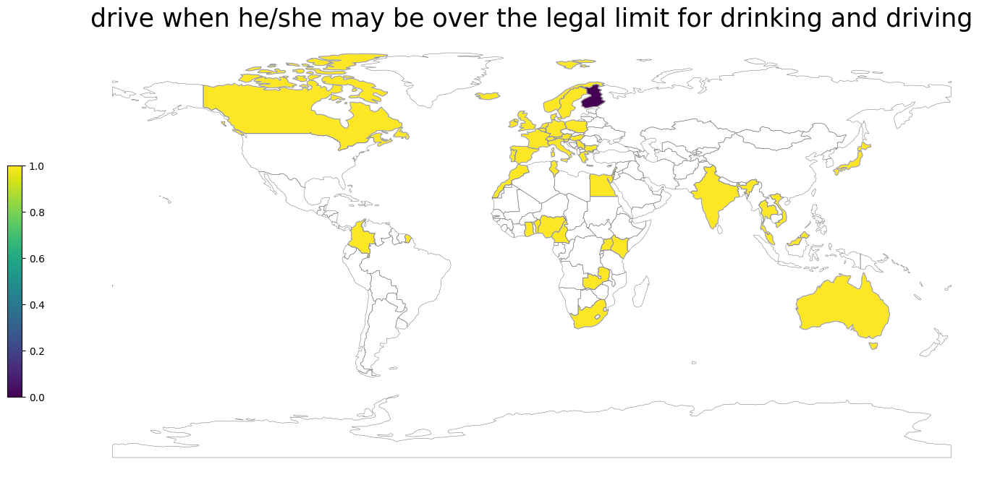

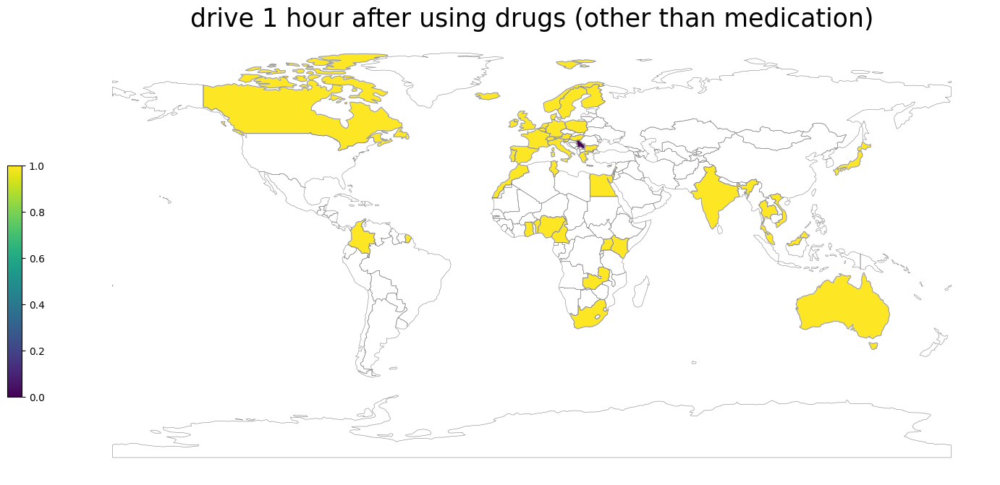

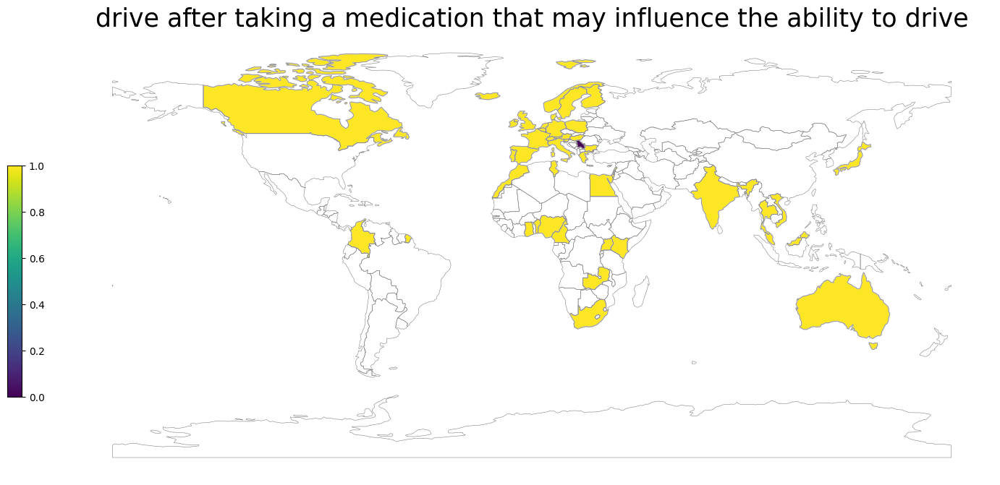

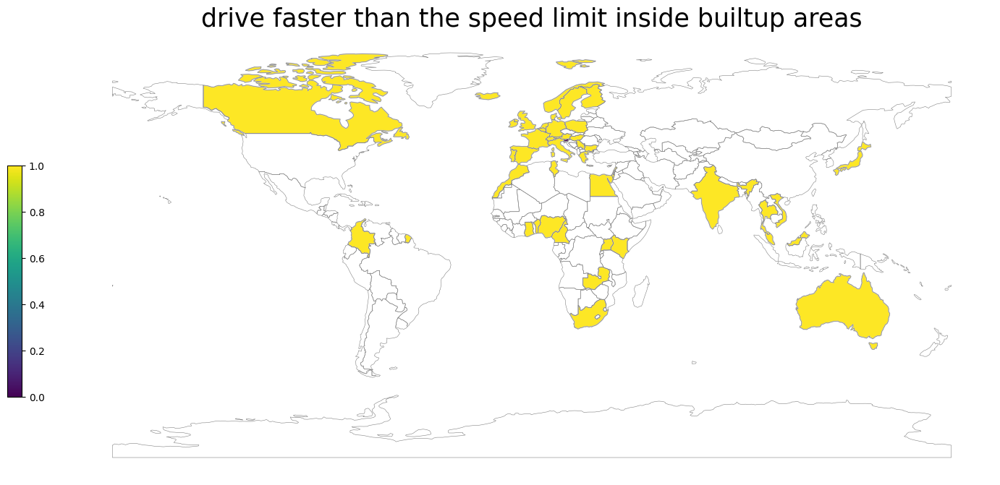

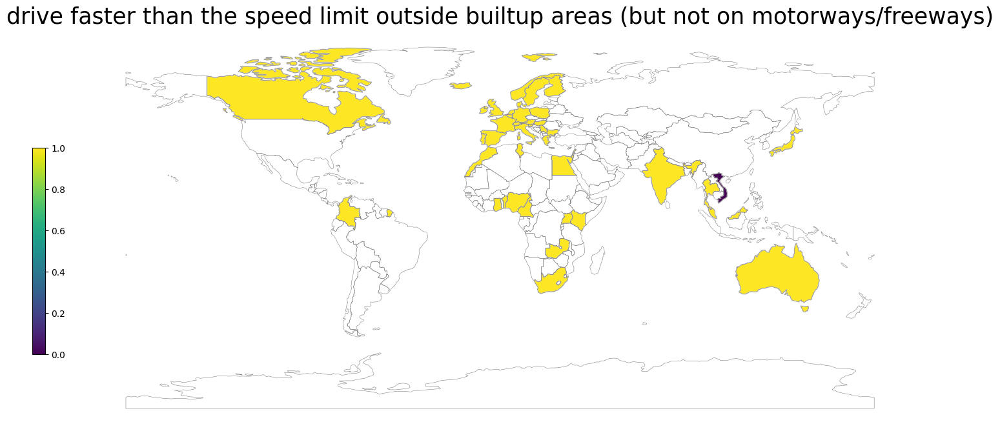

...

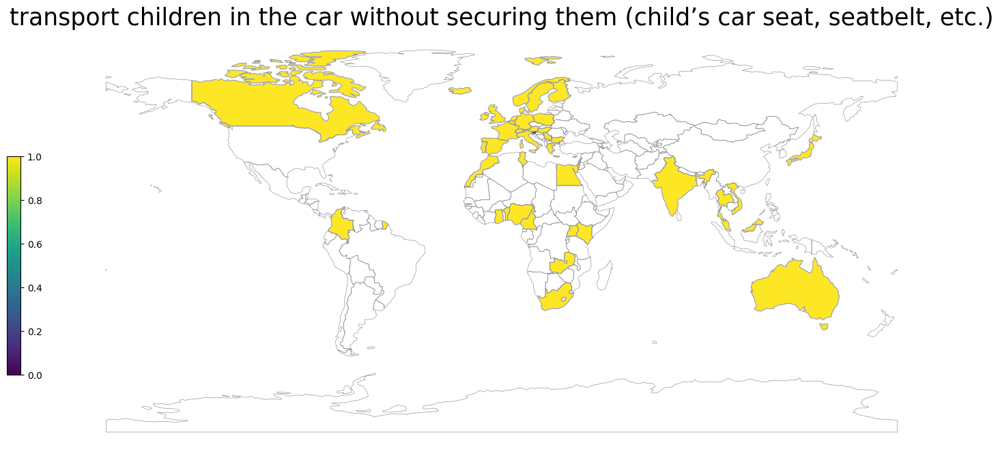

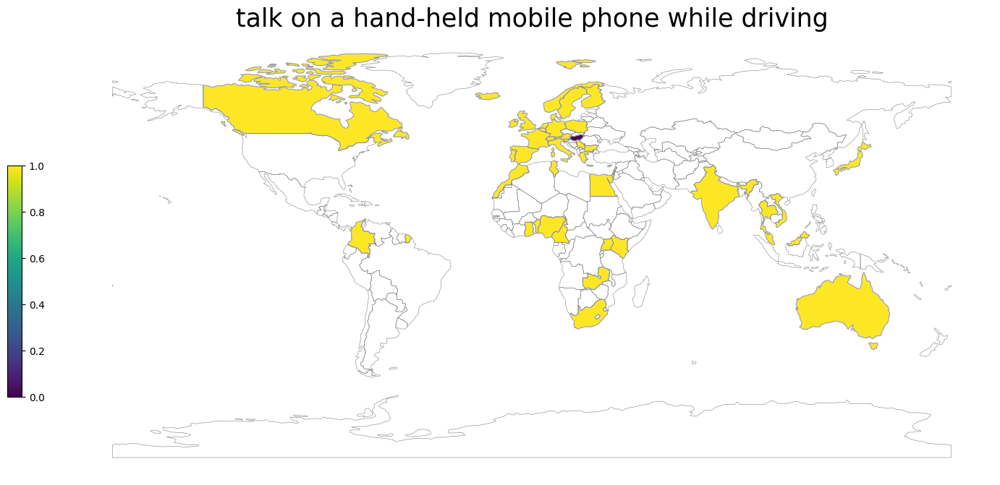

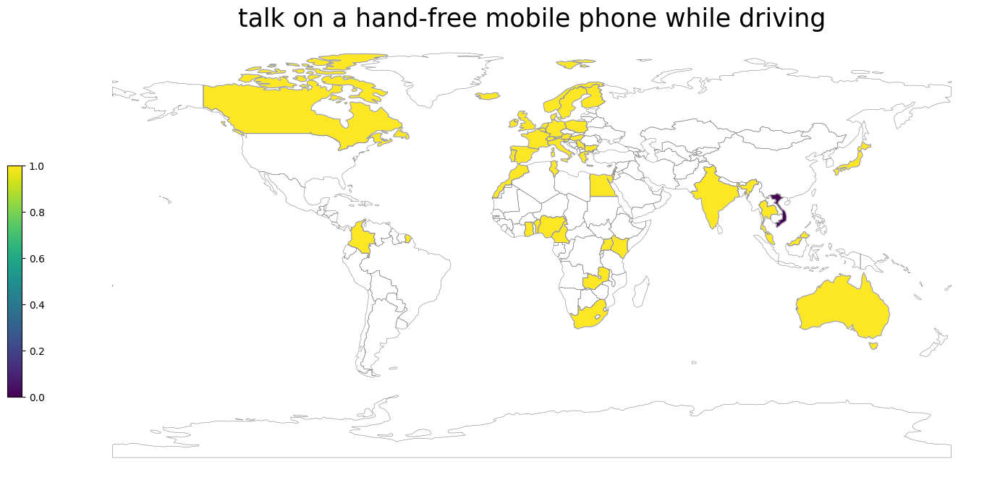

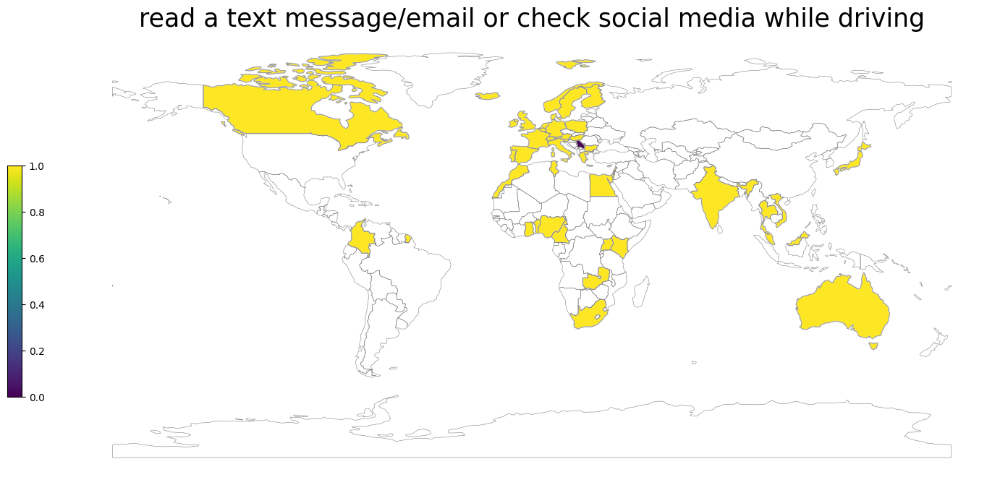

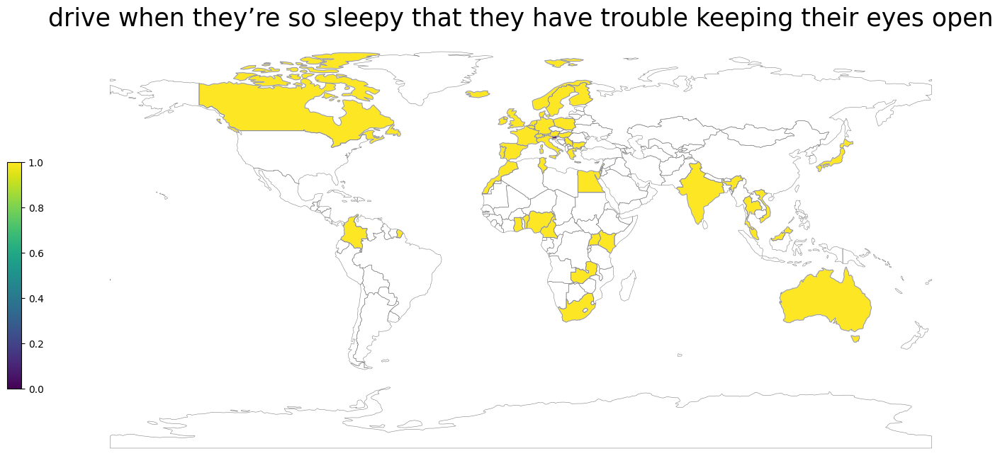

In [35]:
for i in range(len(data.columns)-1):
    plot_map(data.columns[1+i], data)

### Attitudes (Q15), risk perception (Q17), perceived behaviour control (Q15)
Table 11: Composite mean scores for Attitudes, Risk Perception, and Perceived Behaviour Control (PBC).

In [36]:
data = pd.read_excel(file,sheet_name=6)
data.rename(columns={"Column1" : "Country", "Column2" : "Attitudes", "Column4" : "Risk perception", "Column6" : "PBC DUI-alcohol", "Column8" : "PBC distraction-mobile phone", "Column10" : "PBC speeding"}, inplace=True)
data.to_csv('csv/attitudes_risk_behavioralcoltrol.csv')
data

,Country,Attitudes,Risk perception,PBC DUI-alcohol,PBC distraction-mobile phone,PBC speeding
0,Australia,1.35,4.41,1.40,1.42,1.71
1,Austria,1.62,4.26,1.76,1.67,2.46
2,Belgium,1.50,4.18,1.63,1.56,1.97
3,Benin,1.41,4.35,1.44,1.38,1.39
4,Bulgaria,1.45,4.41,1.33,1.39,1.55
5,Cameroon,1.57,4.63,1.53,1.60,1.50
6,Canada,1.49,4.21,1.51,1.48,1.96
7,Colombia,1.45,4.07,1.31,1.48,1.55
8,Czech Republic,1.42,4.65,1.25,1.42,1.82
9,Denmark,1.39,4.18,1.49,1.46,1.94


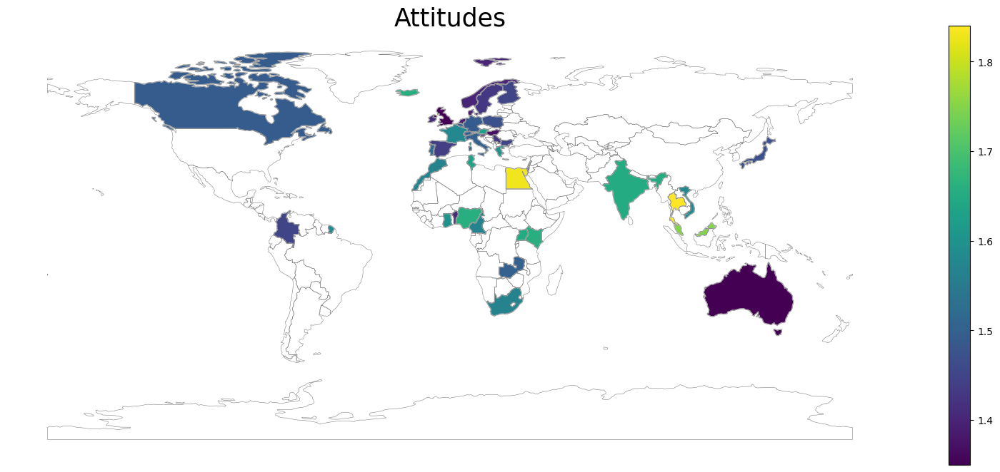

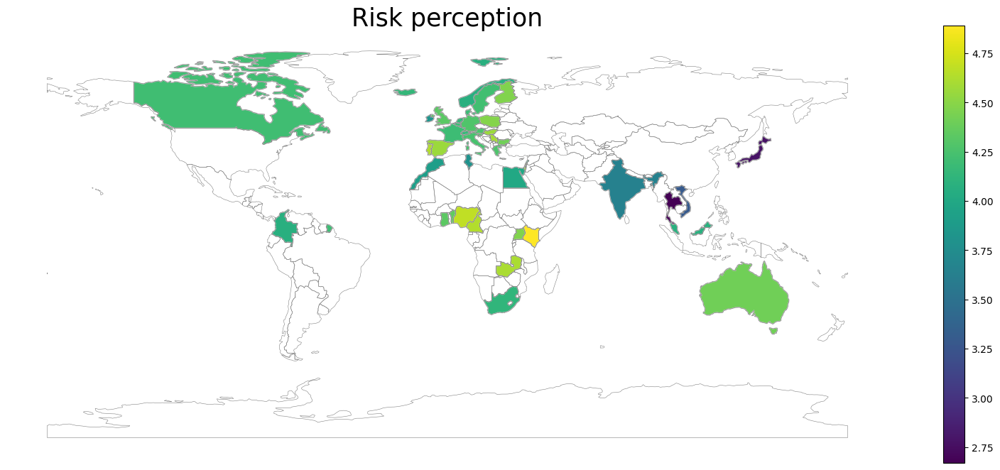

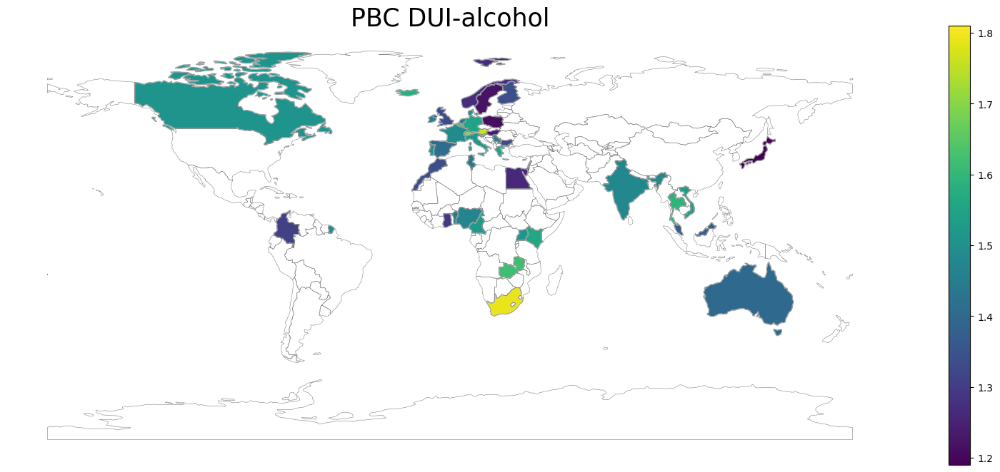

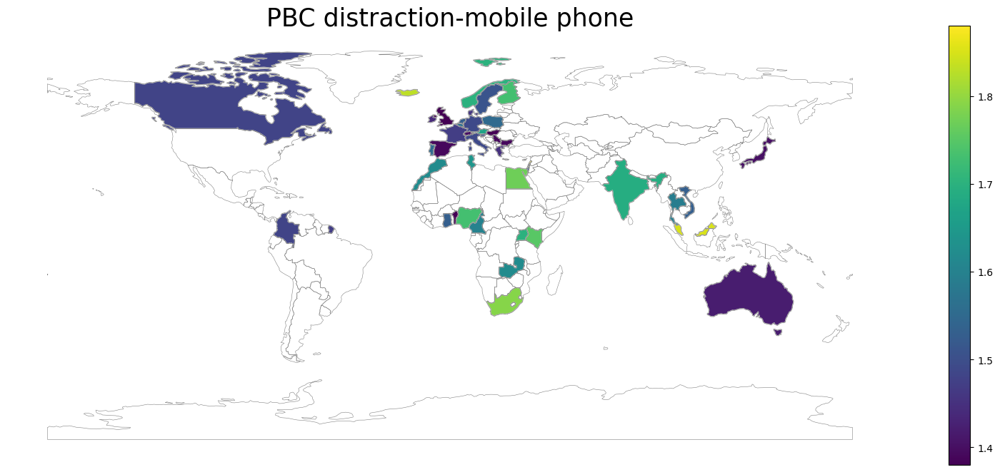

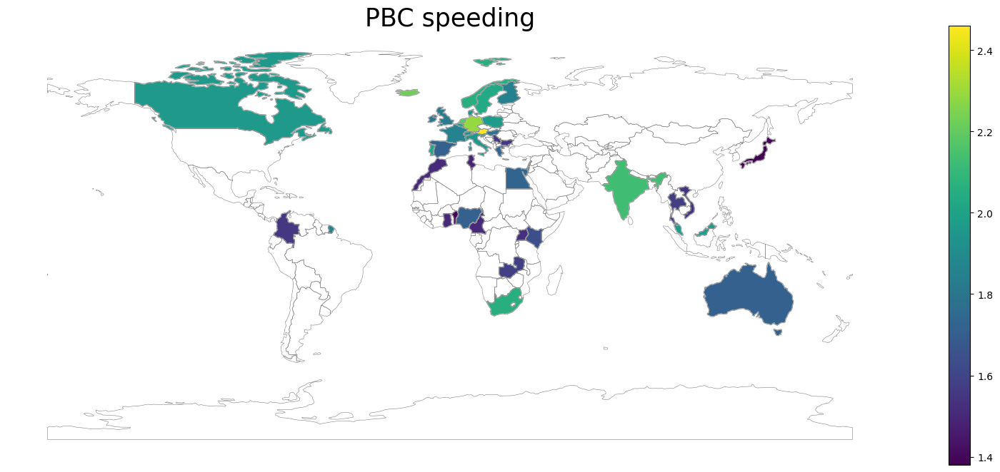

In [37]:
for i in range(len(data.columns)-1):
    plot_map(data.columns[1+i], data, free_legend=True)

### Safety feeling (Q16)
Table 12: Safety feeling, by country and region (mean score of a 11-point scale, where 0 = very unsafe
& 10 = very safe).

In [38]:
data = pd.read_excel(file,sheet_name=7)
data.rename(columns={"Column1" : "Country"}, inplace=True)
data.to_csv('csv/safety_feeling.csv')
data

,Country,Pedestrian,Cyclist,Moped rider /motorcyclist,Car as driver,Car as a passenger,Public transport
0,Australia,8.1,6.3,5.7,7.5,7.5,7.9
1,Austria,8.3,7.2,6.2,8.0,7.2,8.2
2,Belgium,6.7,5.6,5.4,7.0,6.7,7.6
3,Benin,7.9,5.0,4.3,7.5,6.4,6.2
4,Bulgaria,7.2,5.5,4.5,5.9,6.5,7.2
5,Cameroon,6.7,4.8,4.7,6.7,7.0,7.2
6,Canada,8.1,6.6,6.0,7.8,7.5,8.1
7,Colombia,6.3,5.3,4.8,6.7,7.0,6.6
8,Czech Republic,7.3,6.1,5.5,6.8,6.9,7.8
9,Denmark,8.4,7.3,6.4,8.2,7.7,8.1


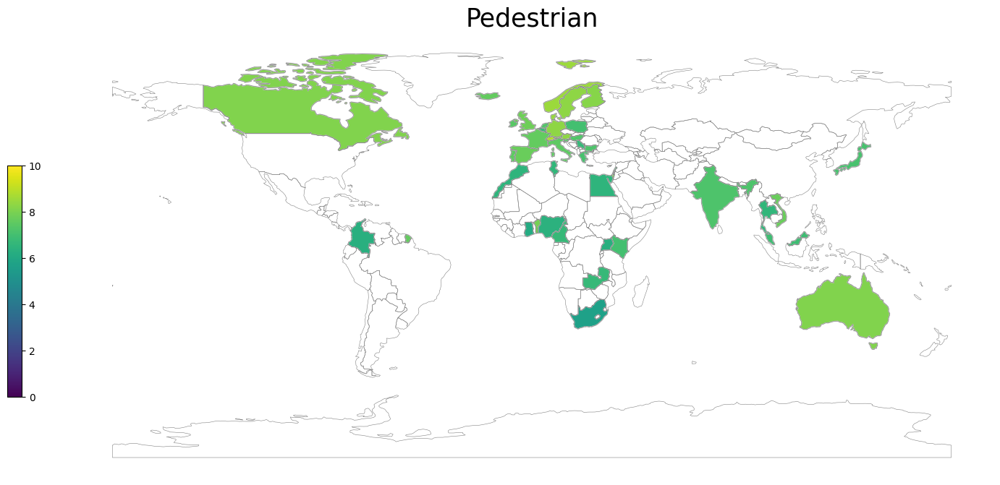

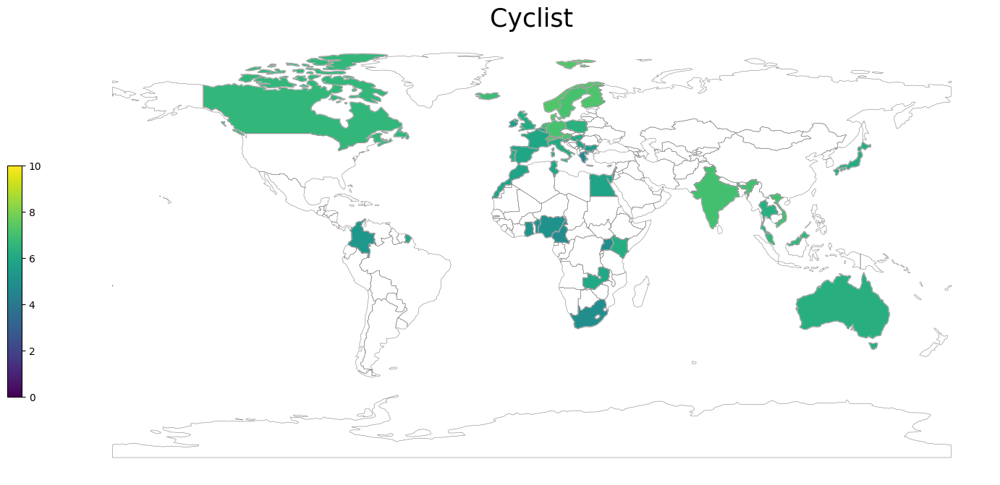

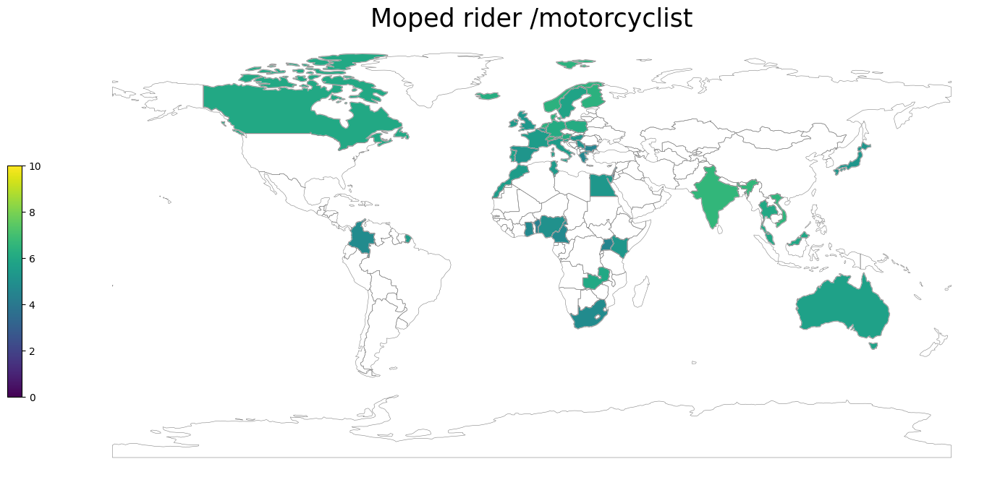

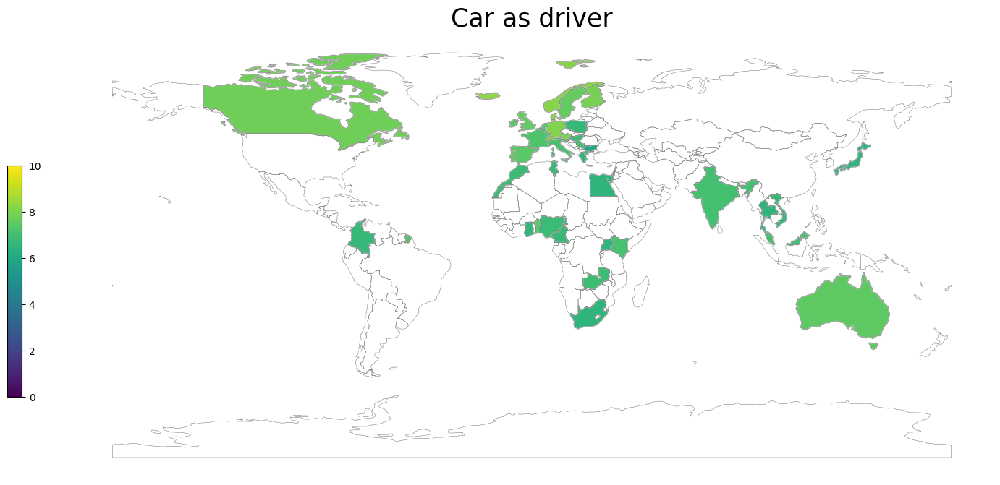

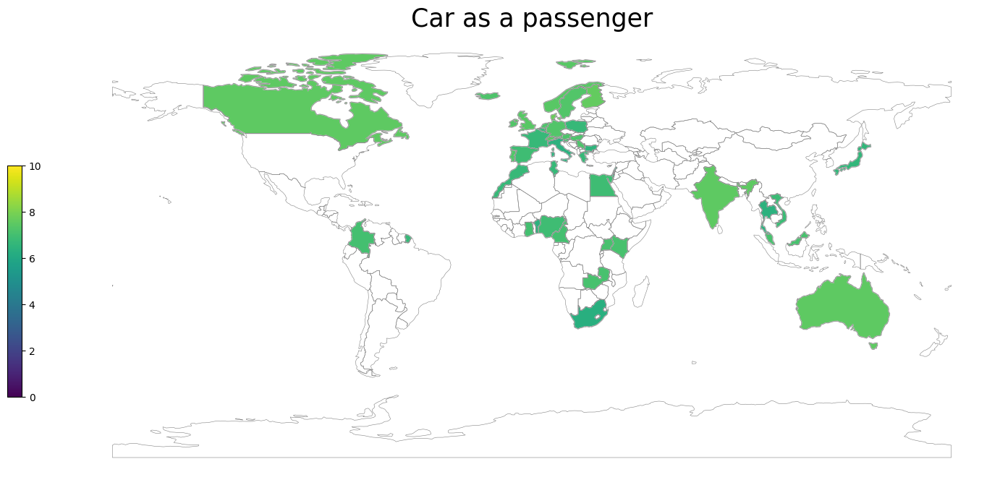

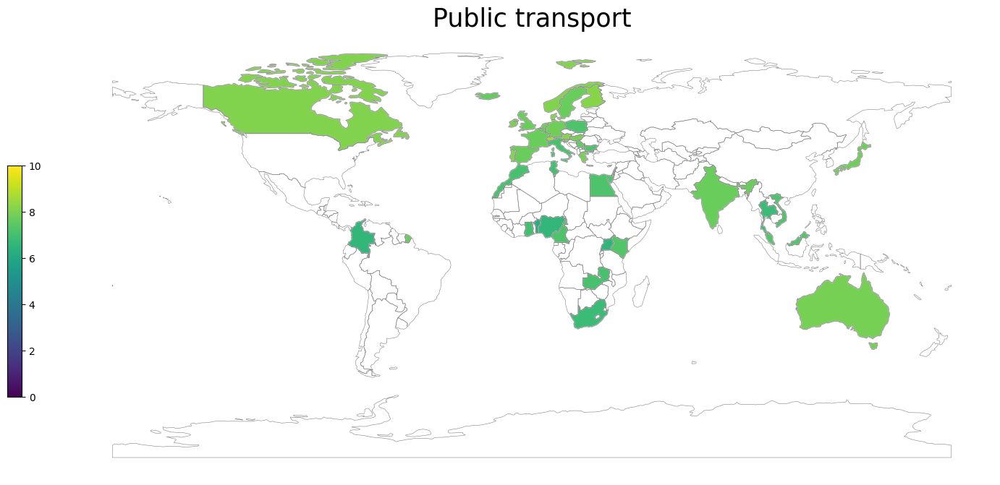

In [39]:
for i in range(len(data.columns)-1):
    plot_map(data.columns[1+i], data, lower=0, higher=10)

### Enforcement perception (Q20)
Table 13: Enforcement perception, by country and region (“On a typical journey, how likely is it that
you (as a CAR DRIVER) will be checked by the police for…” – % of likely – scores 5 to 7 on a 7-point
scale from 1 “very unlikely” to 7 “very likely”).

In [40]:
data = pd.read_excel(file,sheet_name=8)
data.rename(columns={"Column1" : "Country"}, inplace=True)
for col in data.columns[1:]:
    mask = data[col].str.contains("%", na=False)
    data[col][mask] = data[col][mask].str.rstrip("%").astype(float)/100
data.to_csv('csv/enforcment_perception.csv')
data

,Country,"alcohol, in other words, being subjected to a Breathalyser test",use of illegal drugs,respecting the speed limits,wearing your seatbelt,use of hand-held mobile phone to talk or text while driving
0,Australia,0.3,0.171,0.414,0.241,0.211
1,Austria,0.235,0.105,0.431,0.25,0.198
2,Belgium,0.218,0.143,0.385,0.196,0.157
3,Benin,0.146,0.078,0.194,0.223,0.175
4,Bulgaria,0.358,0.265,0.532,0.501,0.319
5,Cameroon,0.245,0.236,0.382,0.373,0.236
6,Canada,0.137,0.119,0.272,0.207,0.147
7,Colombia,0.427,0.273,0.473,0.513,0.309
8,Czech Republic,0.385,0.191,0.462,0.357,0.247
9,Denmark,0.109,0.08,0.26,0.155,0.128


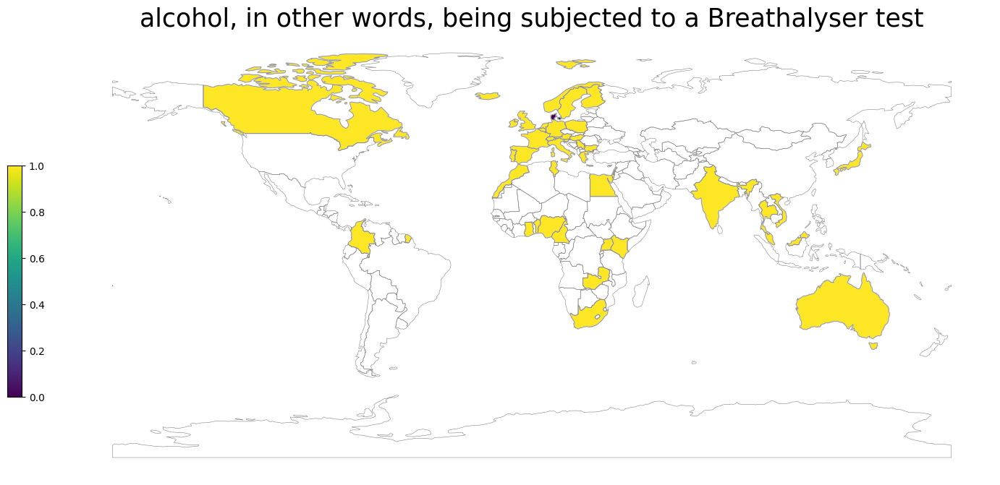

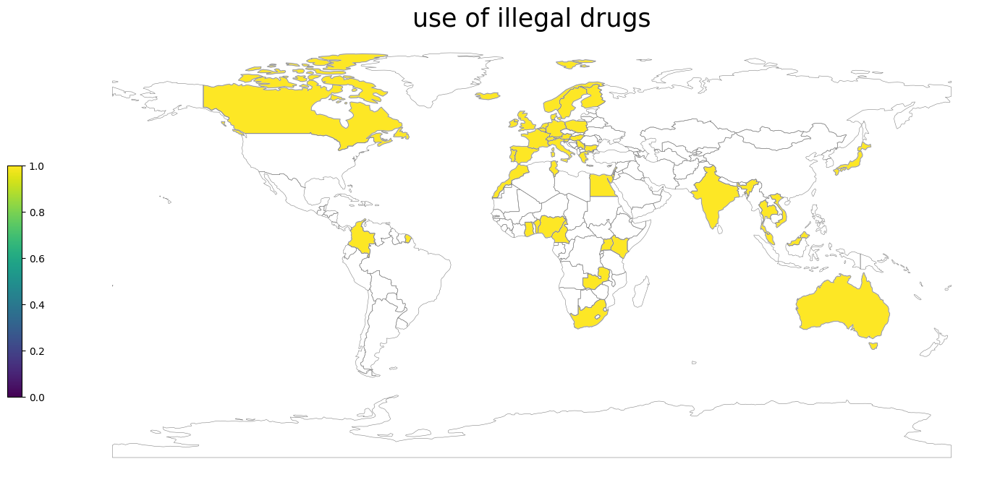

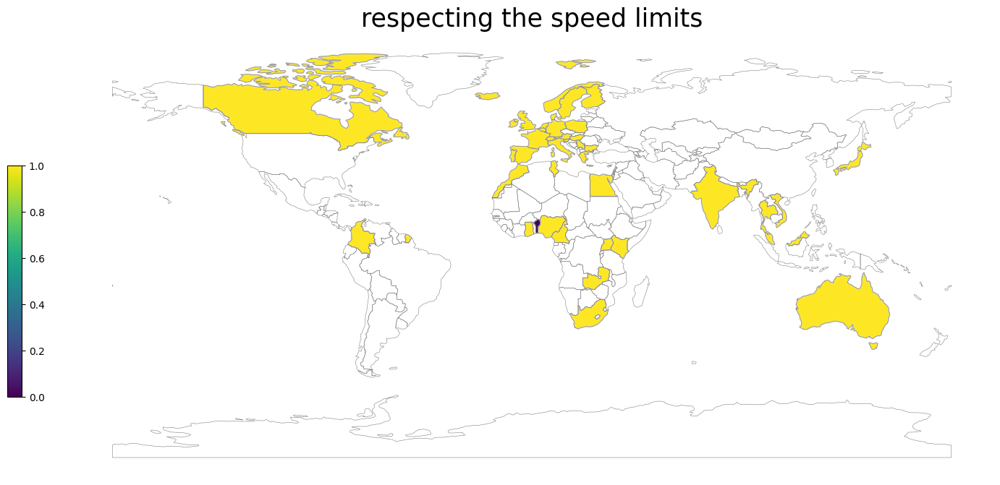

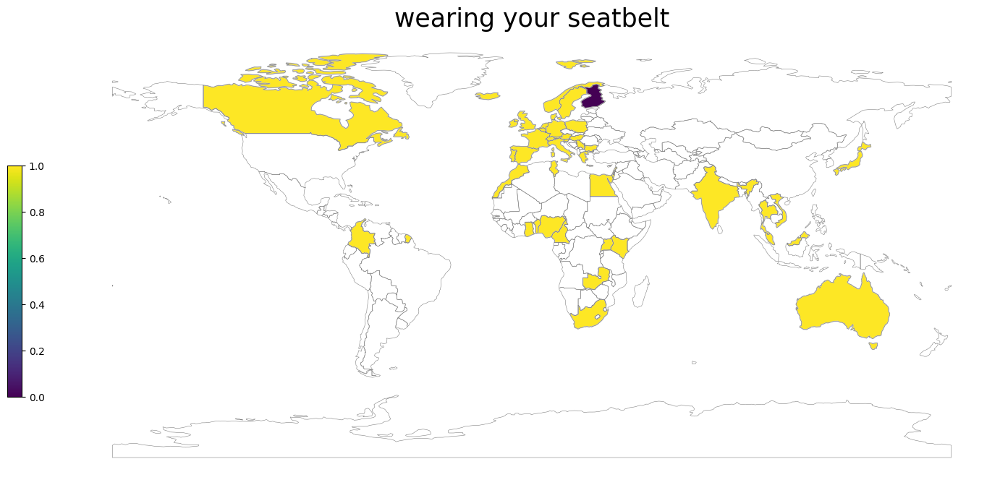

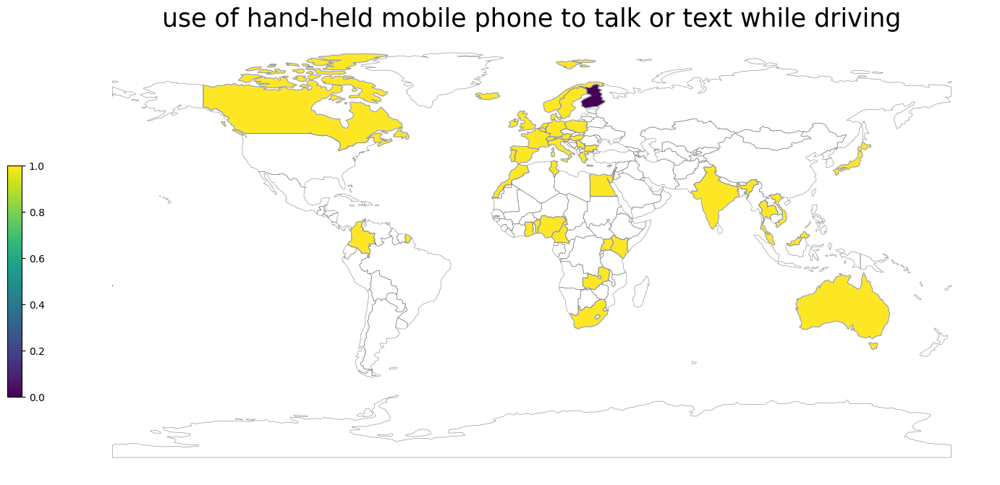

In [41]:
for i in range(len(data.columns)-1):
    plot_map(data.columns[1+i], data)

### Self-declared enforcement (Q21/Q22)
Table 14: Self-declared enforcement, by country and region (“In the past 12 months, how many times
have you been checked by the police for …?” – % at least once in the past 12 months).

In [42]:
data = pd.read_excel(file,sheet_name=9)
data.rename(columns={"Column1" : "Country"}, inplace=True)
for col in data.columns[1:]:
    mask = data[col].str.contains("%", na=False)
    data[col][mask] = (data[col][mask].str.rstrip("%").astype(float)/100).round(3)
data.to_csv('csv/self_declared_enforcement.csv')
data

,Country,"checked by the police for using alcohol while DRIVING A CAR (i.e., being subjected to a Breathalyser",checked by the police for the use of drugs (other than medication) while DRIVING A CAR
0,Australia,0.471,0.105
1,Austria,0.192,0.036
2,Belgium,0.241,0.041
3,Benin,0.039,0.04
4,Bulgaria,0.413,0.138
5,Cameroon,0.28,0.083
6,Canada,0.081,0.042
7,Colombia,0.33,0.1
8,Czech Republic,0.417,0.075
9,Denmark,0.089,0.022


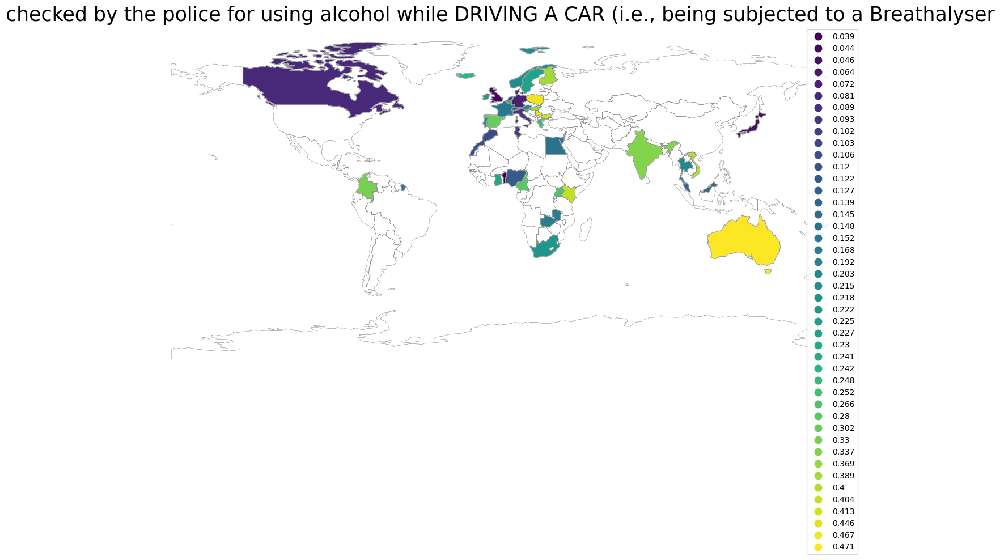

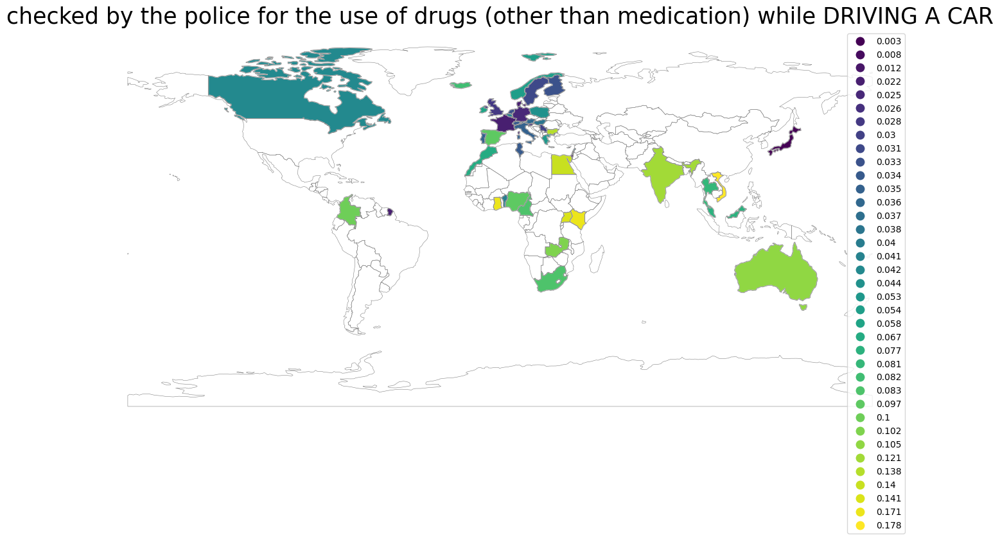

In [43]:
for i in range(len(data.columns)-1):
    plot_map(data.columns[1+i], data, free_legend=True)

### Support for policy measures (Q18)
Table 15: Support for policy measures, by country and region (“Do you oppose or support a legal obligation to …?” – % of support – scores 4 to 5 on a 5-point
scale from 1 “oppose” to 5 “support”).

In [44]:
data = pd.read_excel(file,sheet_name=10)
data.rename(
    columns={
    "Column1" : "Country",
    "Column2" : "install an alcohol “interlock” for drivers who have been caught drunk driving on more than one occasion",
    "Column3" : "have zero tolerance for alcohol (0,0 ‰) for novice drivers (licence obtained less than 2 years)",
    "Column4" : "have zero tolerance for alcohol (0,0 ‰) for all drivers",
    "Column5" : "install Intelligent Speed Assistance (ISA) in new cars",
    "Column6" : "install Dynamic Speed Warning signs",
    "Column7" : "have a seatbelt reminder system for the front and back seats in new cars",
    "Column8" : "require all cyclists to wear a helmet",
    "Column9" : "require cyclists under the age of 12 to wear a helmet",
    "Column10" : "require all moped drivers and motorcyclists to wear a helmet",
    "Column11" : "require pedestrians to wear reflective material when walking in the streets in the dark",
    "Column12" : "require cyclists to wear reflective material when cycling in the dark",
    "Column13" : "require moped drivers and motorcyclists to wear reflective material when driving in the dark",
    "Column14" : "have zero tolerance for using any type of mobile phone while driving (hand-held or handsfree) for all drivers",
    "Column15" : "not using headphones (or earbuds) while walking in the streets",
    "Column16" : "not using headphones (or earbuds) while riding a bicycle",
    }, inplace=True)
data = data.drop([0,1,2,3,4])
data = data.reset_index(drop=True)
for col in data.columns[1:]:
    mask = data[col].str.contains("%2", na=False)
    data[col][mask] = data[col][mask].str.rstrip("2")
for col in data.columns[1:]:
    mask = data[col].str.contains("%", na=False)
    data[col][mask] = data[col][mask].str.rstrip("%").astype(float)/100
data.to_csv('csv/support_policy_measures.csv')
data

,Country,install an alcohol “interlock” for drivers who have been caught drunk driving on more than one occasion,"have zero tolerance for alcohol (0,0 ‰) for novice drivers (licence obtained less than 2 years)","have zero tolerance for alcohol (0,0 ‰) for all drivers",install Intelligent Speed Assistance (ISA) in new cars,install Dynamic Speed Warning signs,have a seatbelt reminder system for the front and back seats in new cars,require all cyclists to wear a helmet,require cyclists under the age of 12 to wear a helmet,require all moped drivers and motorcyclists to wear a helmet,require pedestrians to wear reflective material when walking in the streets in the dark,require cyclists to wear reflective material when cycling in the dark,require moped drivers and motorcyclists to wear reflective material when driving in the dark,have zero tolerance for using any type of mobile phone while driving (hand-held or handsfree) for all drivers,not using headphones (or earbuds) while walking in the streets,not using headphones (or earbuds) while riding a bicycle
0,Australia,0.847,0.854,0.506,0.575,0.658,0.814,0.84,0.9,0.894,0.311,0.825,0.772,0.576,0.388,0.648
1,Austria,0.716,0.832,0.512,0.435,0.543,0.662,0.577,0.844,0.91,0.571,0.776,0.759,0.368,0.491,0.659
2,Belgium,0.761,0.781,0.576,0.579,0.648,0.81,0.583,0.838,0.824,0.602,0.813,0.809,0.475,0.446,0.627
3,Benin,0.913,0.934,0.905,0.955,0.967,0.967,0.93,0.901,0.959,0.74,0.909,0.839,0.744,0.554,0.751
4,Bulgaria,0.897,0.832,0.811,0.791,0.835,0.834,0.755,0.878,0.916,0.649,0.921,0.92,0.462,0.572,0.729
5,Cameroon,0.897,0.828,0.74,0.882,0.956,0.966,0.922,0.941,0.961,0.549,0.868,0.848,0.608,0.652,0.779
6,Canada,0.85,0.856,0.591,0.49,0.618,0.769,0.757,0.897,0.884,0.54,0.813,0.832,0.627,0.437,0.664
7,Colombia,0.893,0.881,0.898,0.775,0.879,0.9,0.943,0.946,0.952,0.462,0.925,0.921,0.65,0.439,0.638
8,Czech Republic,0.783,0.861,0.737,0.561,0.67,0.688,0.672,0.909,0.883,0.654,0.825,0.824,0.434,0.471,0.718
9,Denmark,0.845,0.691,0.524,0.557,0.636,0.764,0.542,0.805,0.891,0.637,0.828,0.787,0.565,0.366,0.542


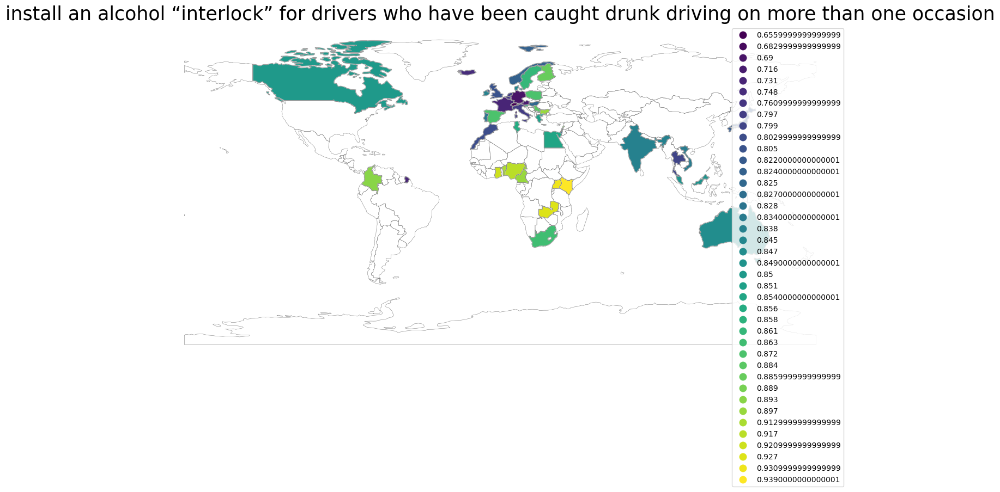

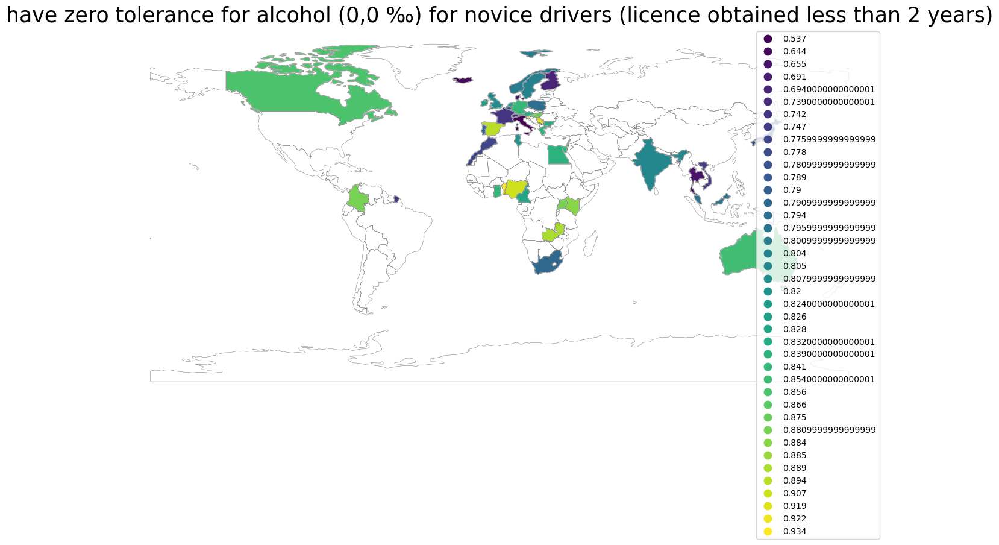

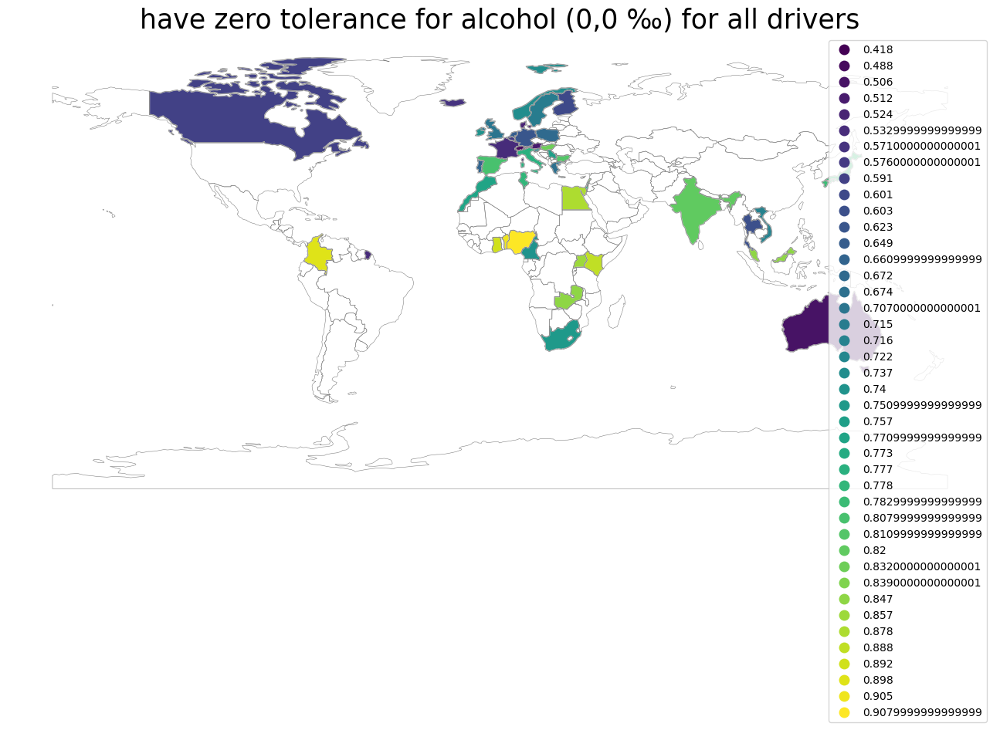

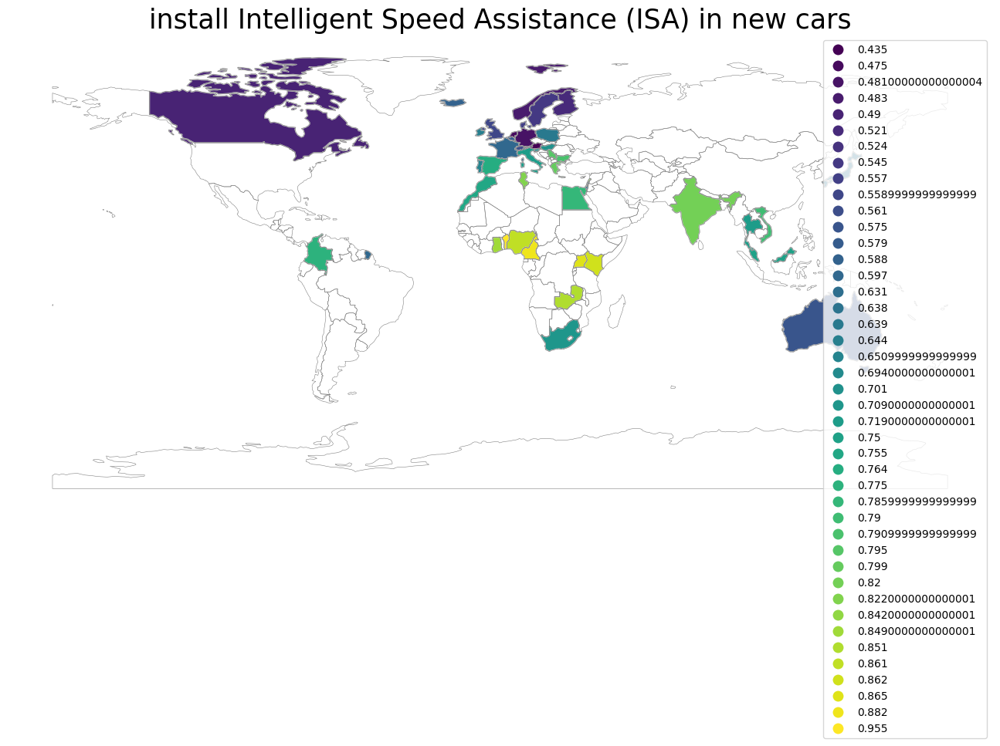

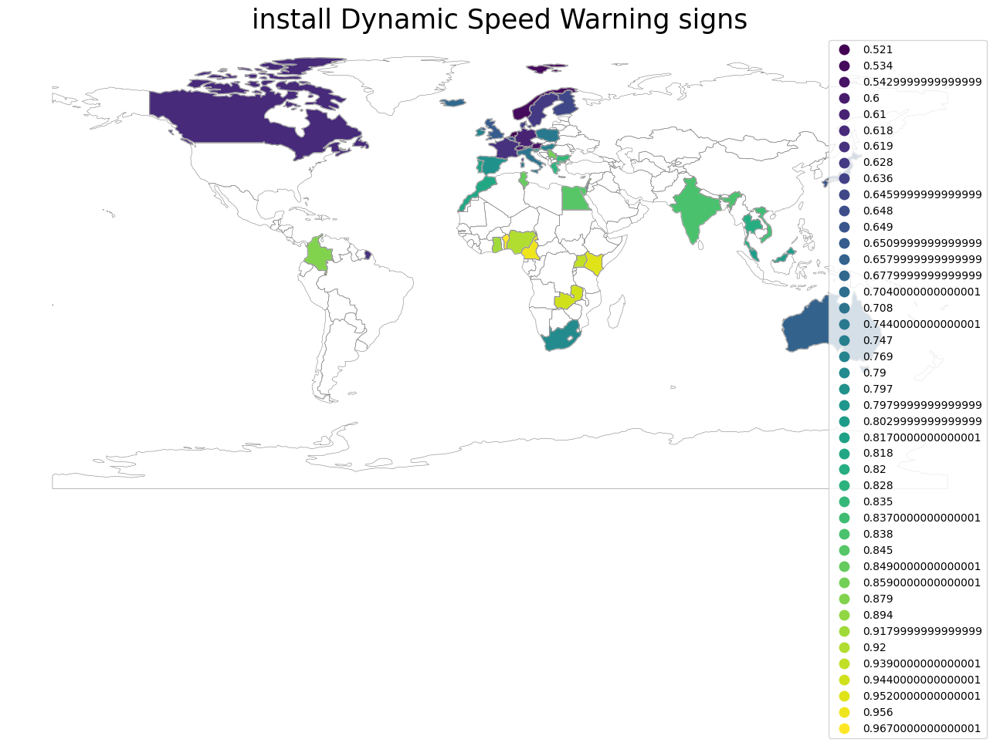

...

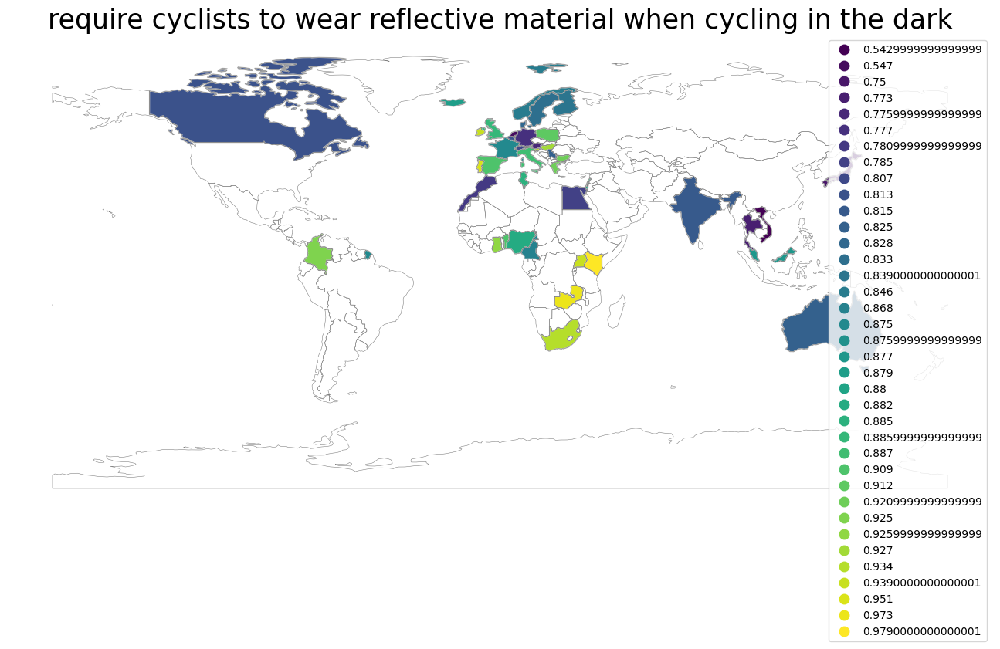

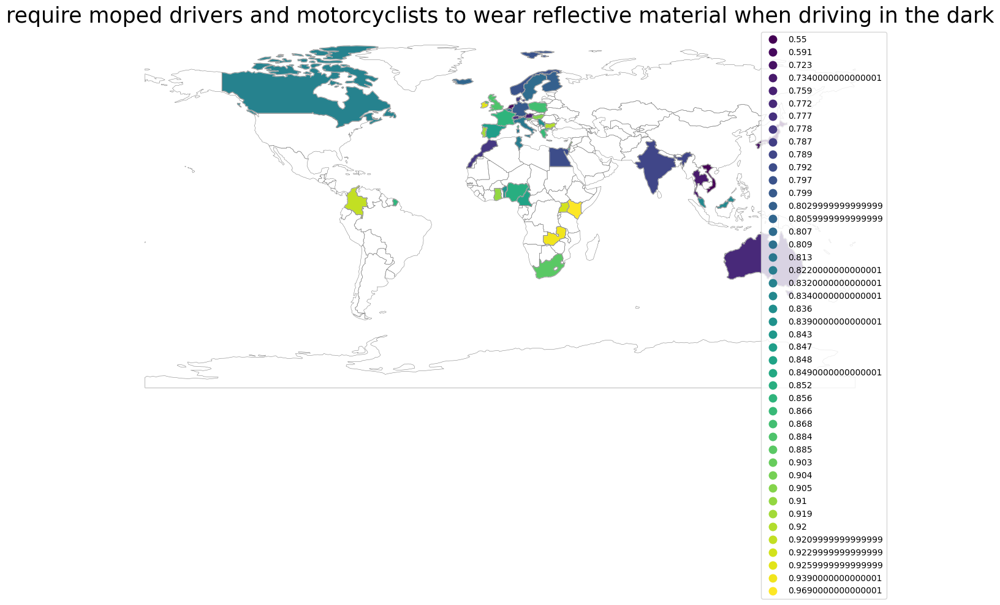

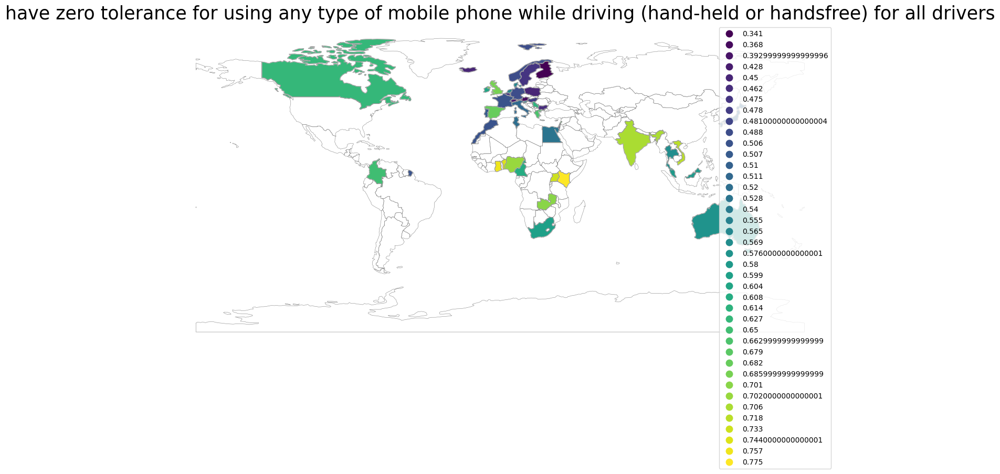

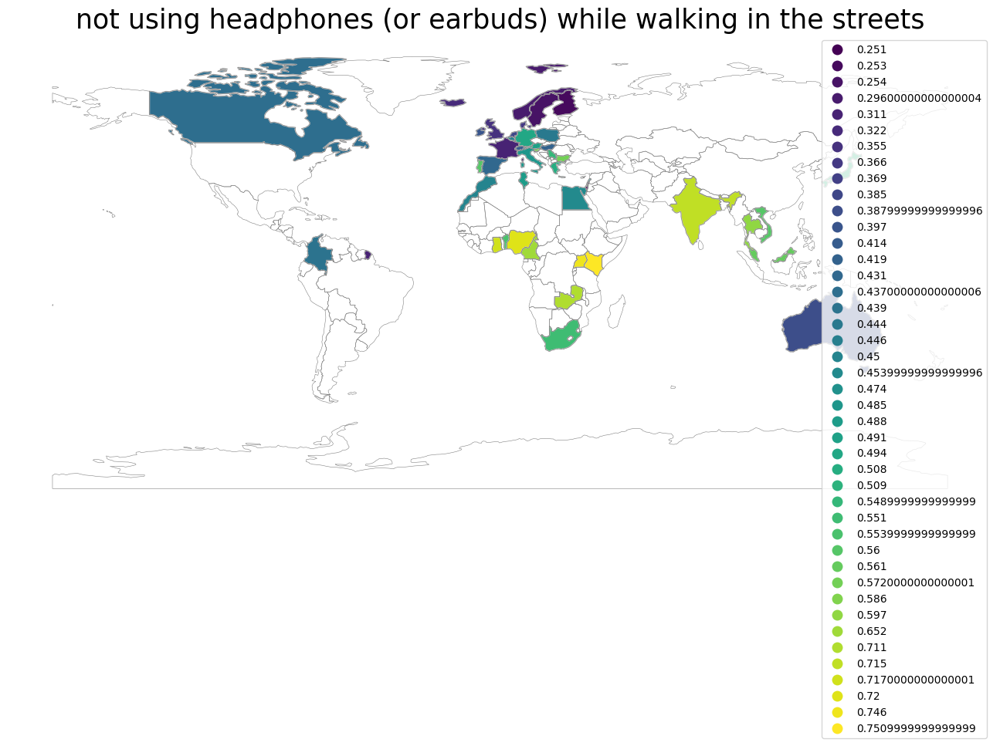

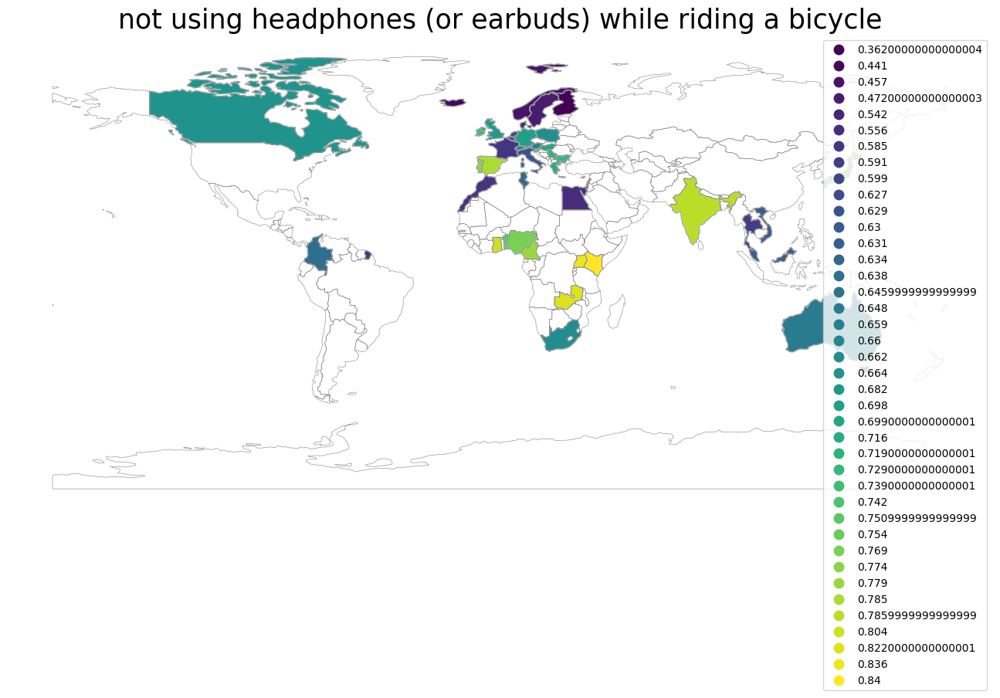

In [45]:
for i in range(len(data.columns)-1):
    plot_map(data.columns[1+i], data, free_legend=True)

### Vehicle automation (Q24/Q25)
Table 16: Interest in automated vehicles, by country and region (“How interested would you be in using
the following types of automated passenger car?” – % of interested – scores 5 to 7 on a 7-point scale
from 1 “not at all interested” to 7 “very interested”).

In [46]:
data = pd.read_excel(file,sheet_name=11)
data.rename(columns={"Column2" : "Country", "Column3" : "Semi-automated passenger car", "Column4" : "Fully-automated passenger car"}, inplace=True)
data = data.drop([0])
data = data.reset_index(drop=True)
for col in data.columns[1:]:
    mask = data[col].str.contains("%", na=False)
    data[col][mask] = data[col][mask].str.rstrip("%").astype(float)/100
data.to_csv('csv/vehicle_automation.csv')
data

,Country,Semi-automated passenger car,Fully-automated passenger car
0,Australia,0.374,0.326
1,Austria,0.368,0.288
2,Belgium,0.394,0.293
3,Benin,0.624,0.343
4,Bulgaria,0.537,0.495
5,Cameroon,0.647,0.564
6,Canada,0.398,0.318
7,Colombia,0.592,0.566
8,Czech Republic,0.364,0.333
9,Denmark,0.392,0.294


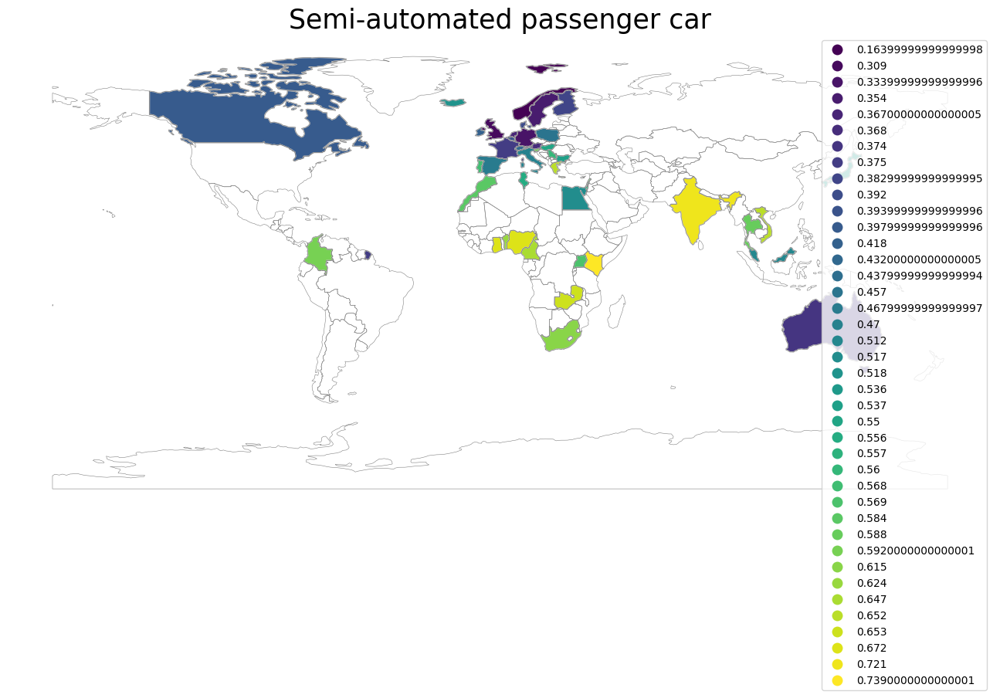

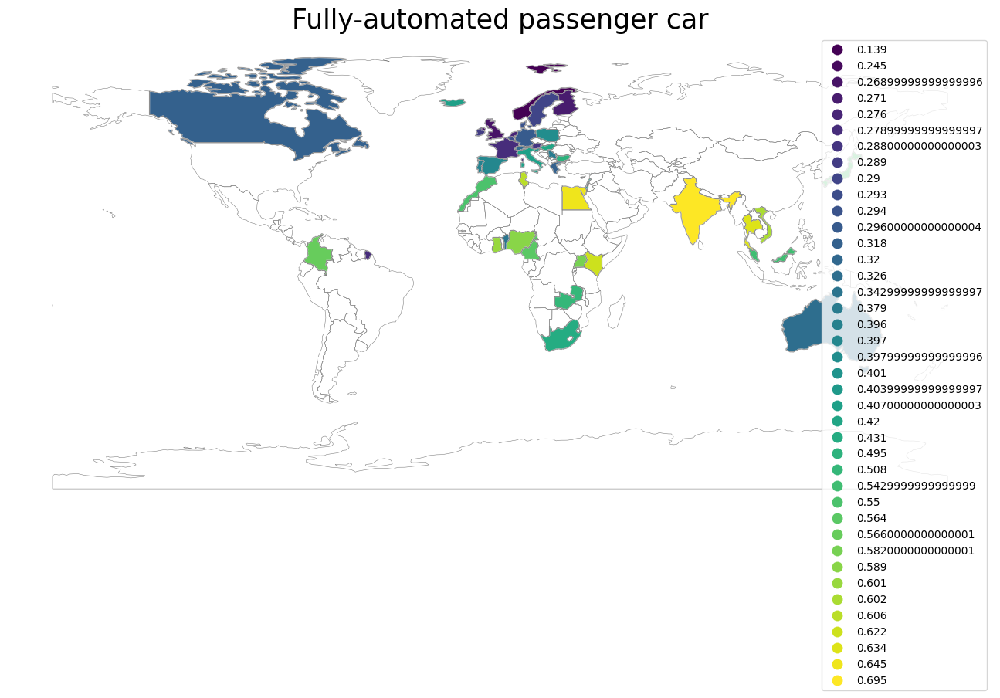

In [47]:
for i in range(len(data.columns)-1):
    plot_map(data.columns[1+i], data, free_legend=True)

# EUROSTAT

## ACCIDENTS BY VEHICLE

In [8]:
filename = "AccidentsByType.csv"

In [9]:
# Read CSV file using Panda
accidentsData = pd.read_csv(filename)
accidentsData

,DATAFLOW,LAST UPDATE,freq,unit,vehicle,geo,TIME_PERIOD,OBS_VALUE,OBS_FLAG,Country,REL
0,ESTAT:TRAN_SF_ROADVE(1.0),01/04/23 11:00:00,A,NR,TOTAL,AT,2019,405,NaN,Austria,0.000020
1,ESTAT:TRAN_SF_ROADVE(1.0),01/04/23 11:00:00,A,NR,TOTAL,BE,2019,646,NaN,Belgium,0.000048
2,ESTAT:TRAN_SF_ROADVE(1.0),01/04/23 11:00:00,A,NR,TOTAL,BG,2019,628,NaN,Bulgaria,0.000021
3,ESTAT:TRAN_SF_ROADVE(1.0),01/04/23 11:00:00,A,NR,TOTAL,CH,2019,187,NaN,Switzerland,NaN
4,ESTAT:TRAN_SF_ROADVE(1.0),01/04/23 11:00:00,A,NR,TOTAL,CY,2019,52,NaN,Cyprus,NaN
5,ESTAT:TRAN_SF_ROADVE(1.0),01/04/23 11:00:00,A,NR,TOTAL,CZ,2019,618,NaN,Czechia,0.000077
6,ESTAT:TRAN_SF_ROADVE(1.0),01/04/23 11:00:00,A,NR,TOTAL,DE,2019,3046,NaN,Germany,0.000046
7,ESTAT:TRAN_SF_ROADVE(1.0),01/04/23 11:00:00,A,NR,TOTAL,DK,2019,199,NaN,Denmark,0.000062
8,ESTAT:TRAN_SF_ROADVE(1.0),01/04/23 11:00:00,A,NR,TOTAL,EE,2019,52,NaN,Estonia,NaN
9,ESTAT:TRAN_SF_ROADVE(1.0),01/04/23 11:00:00,A,NR,TOTAL,EL,2019,688,NaN,Greece,0.000096


In [10]:
for col in accidentsData:
    print(col, accidentsData[col].unique())

DATAFLOW ['ESTAT:TRAN_SF_ROADVE(1.0)']
LAST UPDATE ['01/04/23 11:00:00']
freq ['A']
unit ['NR']
vehicle ['TOTAL']
geo ['AT' 'BE' 'BG' 'CH' 'CY' 'CZ' 'DE' 'DK' 'EE' 'EL' 'ES' 'EU27_2020' 'FI'
 'FR' 'HR' 'HU' 'IE' 'IS' 'IT' 'LI' 'LT' 'LU' 'LV' 'MT' 'NL' 'NO' 'PL'
 'PT' 'RO' 'SE' 'SI' 'SK']
TIME_PERIOD [2019]
OBS_VALUE [  405   646   628   187    52   618  3046   199   688  1755 22744   211
  3237   297   602   140     6  3173     0   185    22   132    16   586
   108  2909  1864   221   102   270]
OBS_FLAG [nan]
Country ['Austria' 'Belgium' 'Bulgaria' 'Switzerland' 'Cyprus' 'Czechia' 'Germany'
 'Denmark' 'Estonia' 'Greece' 'Spain' nan 'Finland' 'France' 'Croatia'
 'Hungary' 'Ireland' 'Iceland' 'Italy' 'Liechtenstein' 'Lithuania'
 'Luxembourg' 'Latvia' 'Malta' 'Netherlands' 'Norway' 'Poland' 'Portugal'
 'Romania' 'Sweden' 'Slovenia' 'Slovakia']
REL [2.01948579e-05 4.82702871e-05 2.14866569e-05            nan
 7.66113522e-05 4.56231771e-05 6.16175171e-05 9.62981822e-05
 6.63833354e-05 6.9

In [11]:
totalAccident = accidentsData[accidentsData["vehicle"]== "TOTAL"][accidentsData["TIME_PERIOD"] == 2019]
totalAccident

,DATAFLOW,LAST UPDATE,freq,unit,vehicle,geo,TIME_PERIOD,OBS_VALUE,OBS_FLAG,Country,REL
0,ESTAT:TRAN_SF_ROADVE(1.0),01/04/23 11:00:00,A,NR,TOTAL,AT,2019,405,NaN,Austria,0.000020
1,ESTAT:TRAN_SF_ROADVE(1.0),01/04/23 11:00:00,A,NR,TOTAL,BE,2019,646,NaN,Belgium,0.000048
2,ESTAT:TRAN_SF_ROADVE(1.0),01/04/23 11:00:00,A,NR,TOTAL,BG,2019,628,NaN,Bulgaria,0.000021
3,ESTAT:TRAN_SF_ROADVE(1.0),01/04/23 11:00:00,A,NR,TOTAL,CH,2019,187,NaN,Switzerland,NaN
4,ESTAT:TRAN_SF_ROADVE(1.0),01/04/23 11:00:00,A,NR,TOTAL,CY,2019,52,NaN,Cyprus,NaN
5,ESTAT:TRAN_SF_ROADVE(1.0),01/04/23 11:00:00,A,NR,TOTAL,CZ,2019,618,NaN,Czechia,0.000077
6,ESTAT:TRAN_SF_ROADVE(1.0),01/04/23 11:00:00,A,NR,TOTAL,DE,2019,3046,NaN,Germany,0.000046
7,ESTAT:TRAN_SF_ROADVE(1.0),01/04/23 11:00:00,A,NR,TOTAL,DK,2019,199,NaN,Denmark,0.000062
8,ESTAT:TRAN_SF_ROADVE(1.0),01/04/23 11:00:00,A,NR,TOTAL,EE,2019,52,NaN,Estonia,NaN
9,ESTAT:TRAN_SF_ROADVE(1.0),01/04/23 11:00:00,A,NR,TOTAL,EL,2019,688,NaN,Greece,0.000096


In [30]:
   
# Define a function to convert country codes to country names
def get_country_name(code):
    try:
        if(code == "EL"):
            return "Greece"
        return pycountry.countries.get(alpha_2=code).name
    except:
        return None

0.0
1.0


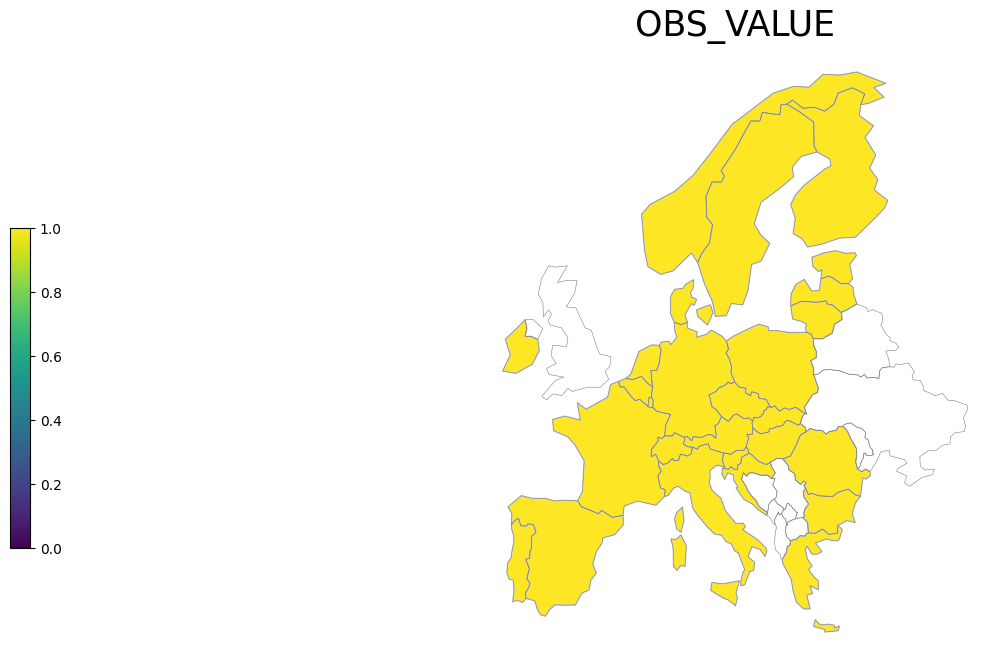

In [31]:
plot_map("OBS_VALUE", totalAccident)

In [32]:


# Define a list of country codes
country_codes = ["US", "CA", "MX"]

# Iterate over country codes and get country name for each
for code in country_codes:
    country = pycountry.countries.get(alpha_2=code)
    if country is not None:
        country_name = country.name
        print(f"{code} is {country_name}")
    else:
        print(f"{code} is not a valid country code")

US is United States
CA is Canada
MX is Mexico


In [33]:


# Add a new column to the DataFrame with the country names
totalAccident['Country'] = totalAccident['geo'].apply(lambda x: get_country_name(x))




# Write the updated DataFrame back to the CSV file
totalAccident.to_csv('AccidentsByType.csv', index=False)

In [34]:
totalAccidentsWorldMap = pd.merge(left=world,right=totalAccident, how="left", left_on="name", right_on="Country")

totalAccidentsWorldMap['REL'] = totalAccidentsWorldMap['OBS_VALUE'] / totalAccidentsWorldMap['pop_est']

# Extract the relevant columns and overwrite totalAccident
totalAccident['REL'] = totalAccidentsWorldMap['REL']
totalAccident.to_csv('AccidentsByType.csv', index=False)

totalAccidentsWorldMap

,pop_est,continent,name,iso_a3,gdp_md_est,geometry,DATAFLOW,LAST UPDATE,freq,unit,vehicle,geo,TIME_PERIOD,OBS_VALUE,OBS_FLAG,Country,REL
0,5347896.0,Europe,Norway,NOR,403336,"POLYGON ((29.39955 69.15692, 28.59193 69.06478...",ESTAT:TRAN_SF_ROADVE(1.0),01/04/23 11:00:00,A,NR,TOTAL,NO,2019.0,108.0,NaN,Norway,0.000020
1,67059887.0,Europe,France,FRA,2715518,"MULTIPOLYGON (((9.39000 43.00998, 9.56002 42.1...",ESTAT:TRAN_SF_ROADVE(1.0),01/04/23 11:00:00,A,NR,TOTAL,FR,2019.0,3237.0,NaN,France,0.000048
2,10285453.0,Europe,Sweden,SWE,530883,"POLYGON ((11.46827 59.43239, 12.30037 60.11793...",ESTAT:TRAN_SF_ROADVE(1.0),01/04/23 11:00:00,A,NR,TOTAL,SE,2019.0,221.0,NaN,Sweden,0.000021
3,9466856.0,Europe,Belarus,BLR,63080,"POLYGON ((29.22951 55.91834, 29.37157 55.67009...",NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
4,44385155.0,Europe,Ukraine,UKR,153781,"POLYGON ((32.41206 52.28869, 32.71576 52.23847...",NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
5,37970874.0,Europe,Poland,POL,595858,"POLYGON ((23.52754 53.47012, 23.80493 53.08973...",ESTAT:TRAN_SF_ROADVE(1.0),01/04/23 11:00:00,A,NR,TOTAL,PL,2019.0,2909.0,NaN,Poland,0.000077
6,8877067.0,Europe,Austria,AUT,445075,"POLYGON ((16.90375 47.71487, 16.34058 47.71290...",ESTAT:TRAN_SF_ROADVE(1.0),01/04/23 11:00:00,A,NR,TOTAL,AT,2019.0,405.0,NaN,Austria,0.000046
7,9769949.0,Europe,Hungary,HUN,163469,"POLYGON ((22.64082 48.15024, 22.71053 47.88219...",ESTAT:TRAN_SF_ROADVE(1.0),01/04/23 11:00:00,A,NR,TOTAL,HU,2019.0,602.0,NaN,Hungary,0.000062
8,2657637.0,Europe,Moldova,MDA,11968,"POLYGON ((26.85782 48.36821, 27.52254 48.46712...",NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
9,19356544.0,Europe,Romania,ROU,250077,"POLYGON ((28.67978 45.30403, 29.14972 45.46493...",ESTAT:TRAN_SF_ROADVE(1.0),01/04/23 11:00:00,A,NR,TOTAL,RO,2019.0,1864.0,NaN,Romania,0.000096


In [35]:
totalAccidentsWorldMap = pd.merge(left=world,right=totalAccident, how="left", left_on="name", right_on="Country")
totalAccidentsWorldMap

,pop_est,continent,name,iso_a3,gdp_md_est,geometry,DATAFLOW,LAST UPDATE,freq,unit,vehicle,geo,TIME_PERIOD,OBS_VALUE,OBS_FLAG,Country,REL
0,5347896.0,Europe,Norway,NOR,403336,"POLYGON ((29.39955 69.15692, 28.59193 69.06478...",ESTAT:TRAN_SF_ROADVE(1.0),01/04/23 11:00:00,A,NR,TOTAL,NO,2019.0,108.0,NaN,Norway,0.000053
1,67059887.0,Europe,France,FRA,2715518,"MULTIPOLYGON (((9.39000 43.00998, 9.56002 42.1...",ESTAT:TRAN_SF_ROADVE(1.0),01/04/23 11:00:00,A,NR,TOTAL,FR,2019.0,3237.0,NaN,France,0.000037
2,10285453.0,Europe,Sweden,SWE,530883,"POLYGON ((11.46827 59.43239, 12.30037 60.11793...",ESTAT:TRAN_SF_ROADVE(1.0),01/04/23 11:00:00,A,NR,TOTAL,SE,2019.0,221.0,NaN,Sweden,0.000038
3,9466856.0,Europe,Belarus,BLR,63080,"POLYGON ((29.22951 55.91834, 29.37157 55.67009...",NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
4,44385155.0,Europe,Ukraine,UKR,153781,"POLYGON ((32.41206 52.28869, 32.71576 52.23847...",NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
5,37970874.0,Europe,Poland,POL,595858,"POLYGON ((23.52754 53.47012, 23.80493 53.08973...",ESTAT:TRAN_SF_ROADVE(1.0),01/04/23 11:00:00,A,NR,TOTAL,PL,2019.0,2909.0,NaN,Poland,0.000034
6,8877067.0,Europe,Austria,AUT,445075,"POLYGON ((16.90375 47.71487, 16.34058 47.71290...",ESTAT:TRAN_SF_ROADVE(1.0),01/04/23 11:00:00,A,NR,TOTAL,AT,2019.0,405.0,NaN,Austria,0.000020
7,9769949.0,Europe,Hungary,HUN,163469,"POLYGON ((22.64082 48.15024, 22.71053 47.88219...",ESTAT:TRAN_SF_ROADVE(1.0),01/04/23 11:00:00,A,NR,TOTAL,HU,2019.0,602.0,NaN,Hungary,0.000064
8,2657637.0,Europe,Moldova,MDA,11968,"POLYGON ((26.85782 48.36821, 27.52254 48.46712...",NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
9,19356544.0,Europe,Romania,ROU,250077,"POLYGON ((28.67978 45.30403, 29.14972 45.46493...",ESTAT:TRAN_SF_ROADVE(1.0),01/04/23 11:00:00,A,NR,TOTAL,RO,2019.0,1864.0,NaN,Romania,0.000049


0.0
1.0


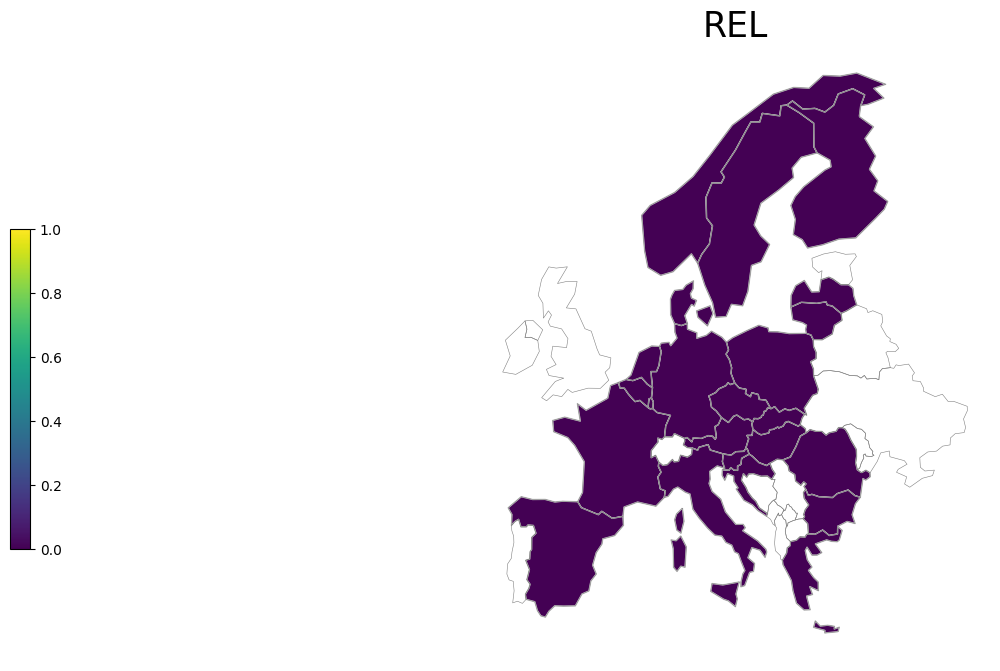

In [36]:
plot_map("REL", totalAccident)

In [37]:
vmin = totalAccident["OBS_VALUE"].max()
vmin

22744

In [38]:
def plot_map2(col, data, free_legend=False):
    #ax2 = world.plot( figsize=(8,4), edgecolor=u'gray', cmap='Set2' )

    merge_df = pd.merge(left=world, right=data, how="left", left_on="name", right_on="Country")

    vmin = merge_df[col].min() # Updated code
    print(vmin)
    vmax = merge_df[col].max() # Updated code
    print(vmax)
    cmap = "viridis"

    fig, ax = plt.subplots(1, figsize=(20, 8))
    ax.axis('off')
    if not free_legend:
        merge_df.plot(column=col, ax=ax, edgecolor='0.8', linewidth=1, cmap=cmap, legend=free_legend, vmin=vmin, vmax=vmax)
    else:
        merge_df.plot(column=col, ax=ax, edgecolor='0.8', linewidth=1, cmap=cmap, legend=free_legend)
    world.boundary.plot(ax=ax, linewidth=0.4, edgecolor=u'gray')

    ax.set_title(col, fontdict={'fontsize': '25', 'fontweight': '3'})

    if not free_legend:
        # Create colorbar as a legend
        sm = plt.cm.ScalarMappable(norm=plt.Normalize(vmin=vmin, vmax=vmax), cmap=cmap)
        # Empty array for the data range
        sm._A = []
        # Add the colorbar to the figure
        cbaxes = fig.add_axes([0.15, 0.25, 0.01, 0.4])
        cbar = fig.colorbar(sm, cax=cbaxes)


2.0194857940393753e-05
9.629818215483095e-05


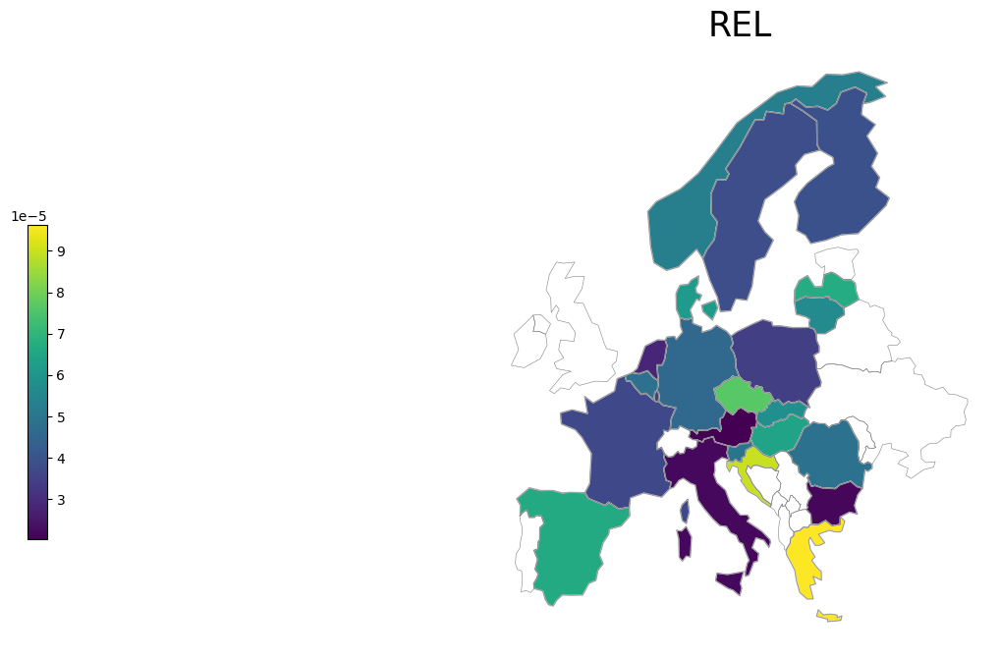

In [94]:
plot_map2("REL", totalAccident)

In [10]:
def plot_map(col, data, free_legend=False, lower=0.0, higher=1.0):
    world = gpd.read_file(gpd.datasets.get_path('naturalearth_lowres'))
    #ax2 = world.plot( figsize=(8,4), edgecolor=u'gray', cmap='Set2' )

    merge_df = pd.merge(left=world, right=data, how="left", left_on="name", right_on="Country")

    vmin = lower#data[col].min()
    vmax = higher#data[col].max()
    cmap = "viridis"

    fig, ax = plt.subplots(1, figsize=(20, 8))
    ax.axis('off')
    if not free_legend:
        merge_df.plot(column=col, ax=ax, edgecolor='0.8', linewidth=1, cmap=cmap, legend=free_legend, vmin=lower, vmax=higher)
    else:
        merge_df.plot(column=col, ax=ax, edgecolor='0.8', linewidth=1, cmap=cmap, legend=free_legend)
    world.boundary.plot(ax=ax, linewidth=0.4, edgecolor=u'gray')

    ax.set_title(col, fontdict={'fontsize': '25', 'fontweight': '3'})

    if not free_legend:
        # Create colorbar as a legend
        sm = plt.cm.ScalarMappable(norm=plt.Normalize(vmin=vmin, vmax=vmax), cmap=cmap)
        # Empty array for the data range
        sm._A = []
        # Add the colorbar to the figure
        cbaxes = fig.add_axes([0.15, 0.25, 0.01, 0.4])
        cbar = fig.colorbar(sm, cax=cbaxes)

    plt.plot()

In [11]:
file = "esra.xlsx"

In [12]:
data = pd.read_excel(file,sheet_name=2)
data.rename(columns={"Column1" : "Country"}, inplace=True)
for col in data.columns[1:]:
    mask = data[col].str.contains("%", na=False)
    data[col][mask] = data[col][mask].str.rstrip("%").astype(float)/100
data.to_csv('csv/self_declared_behaviour_driver_passenger.csv')
data

,Country,drive when you may have been over the legal limit for drinking and driving,drive after drinking alcohol,drive 1 hour after using drugs (other than medication ),drive after taking medication that carries a warning that it may influence your driving ability,drive faster than the speed limit inside built-up areas,drive faster than the speed limit outside built-up areas (but not on motorways /freeways),drive faster than the speed limit on motorways /freeways,drive without wearing your seatbelt,transport children under 150cm* without using child restraint systems,transport children over 150cm* without wearing their seatbelts,as a car passenger travel without wearing your seatbelt in the back seat,talk on a hand-held mobile phone while driving,talk on a hands-free mobile phone while driving,read a text message/e mail or check social media while driving,drive when you were so sleepy that you had trouble keeping your eyes open
0,Australia,0.089,0.237,0.059,0.134,0.446,0.506,0.493,0.063,0.079,0.059,0.1,0.125,0.413,0.19,0.17
1,Austria,0.148,0.305,0.073,0.22,0.714,0.825,0.77,0.199,0.148,0.098,0.437,0.365,0.636,0.342,0.318
2,Belgium,0.242,0.331,0.071,0.181,0.617,0.721,0.683,0.142,0.144,0.12,0.301,0.222,0.455,0.281,0.244
3,Benin,0.247,0.377,0.195,0.221,0.312,0.558,0.416,0.364,0.579,0.6,0.694,0.481,0.701,0.221,0.143
4,Bulgaria,0.051,0.093,0.035,0.101,0.491,0.552,0.44,0.337,0.19,0.216,0.58,0.385,0.522,0.249,0.193
5,Cameroon,0.239,0.27,0.09,0.159,0.398,0.472,0.443,0.614,0.545,0.556,0.866,0.364,0.625,0.33,0.091
6,Canada,0.145,0.259,0.128,0.167,0.664,0.751,0.786,0.16,0.199,0.155,0.252,0.214,0.436,0.26,0.22
7,Colombia,0.11,0.136,0.044,0.102,0.387,0.481,0.489,0.204,0.33,0.232,0.767,0.361,0.674,0.416,0.178
8,Czech Republic,0.119,0.072,0.027,0.115,0.683,0.783,0.711,0.277,0.152,0.117,0.493,0.337,0.406,0.268,0.219
9,Denmark,0.116,0.267,0.042,0.122,0.618,0.818,0.741,0.129,0.308,0.09,0.202,0.244,0.421,0.29,0.241


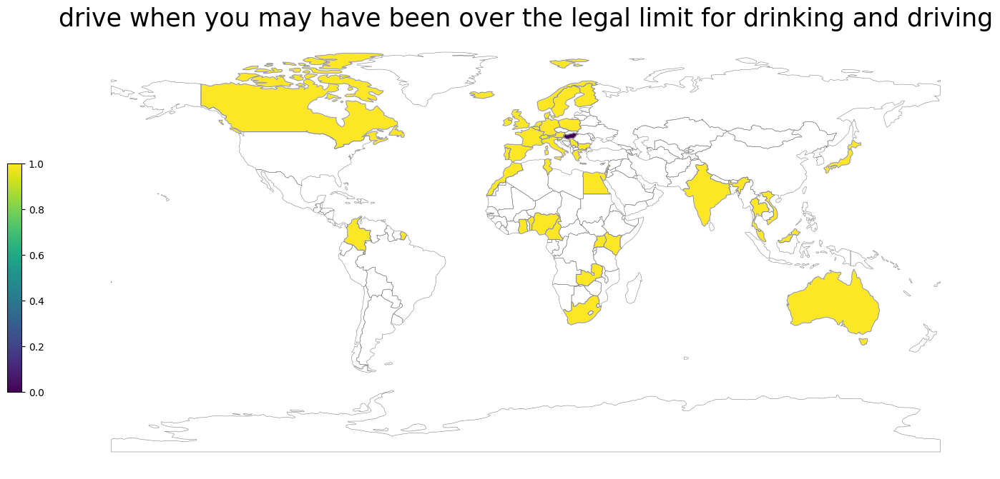

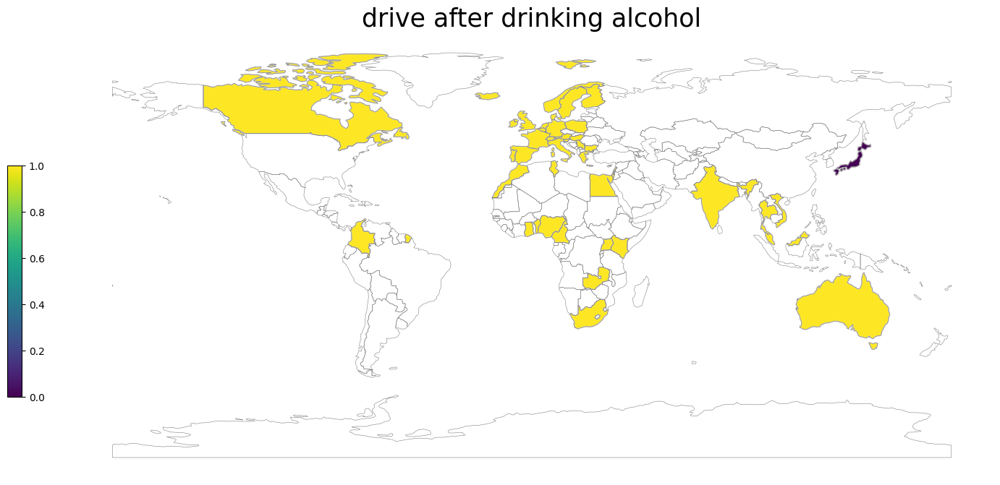

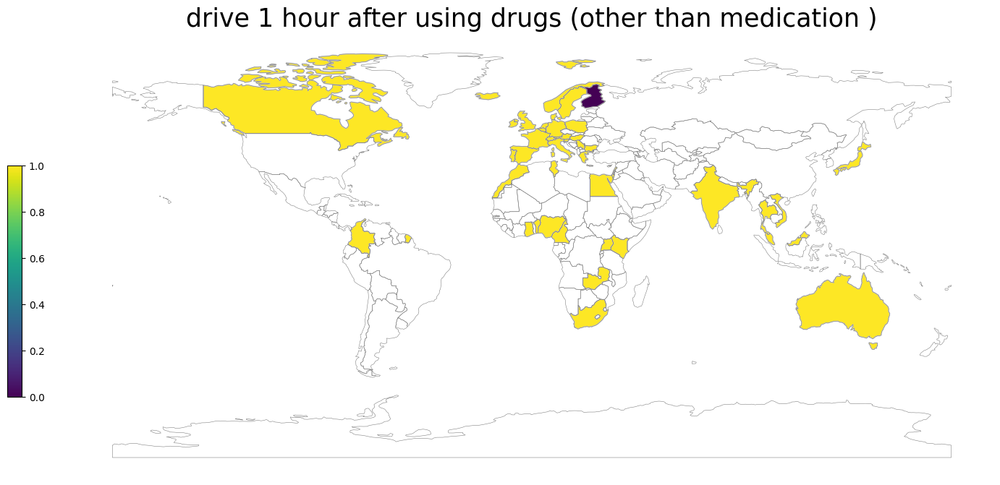

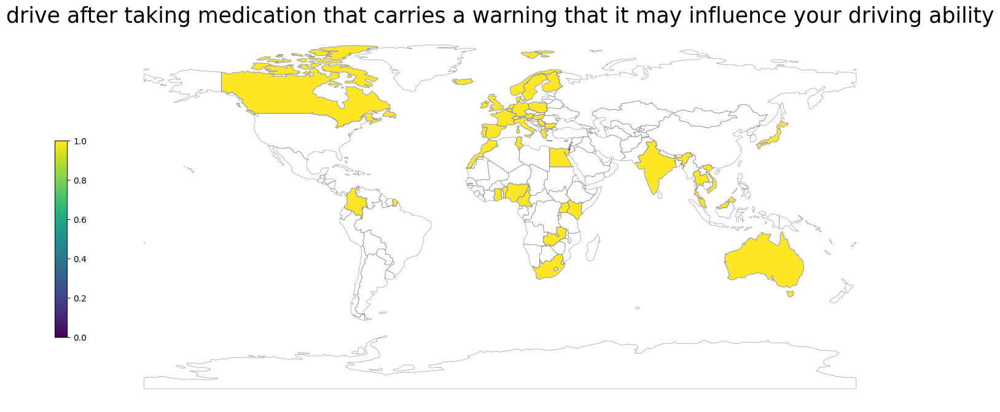

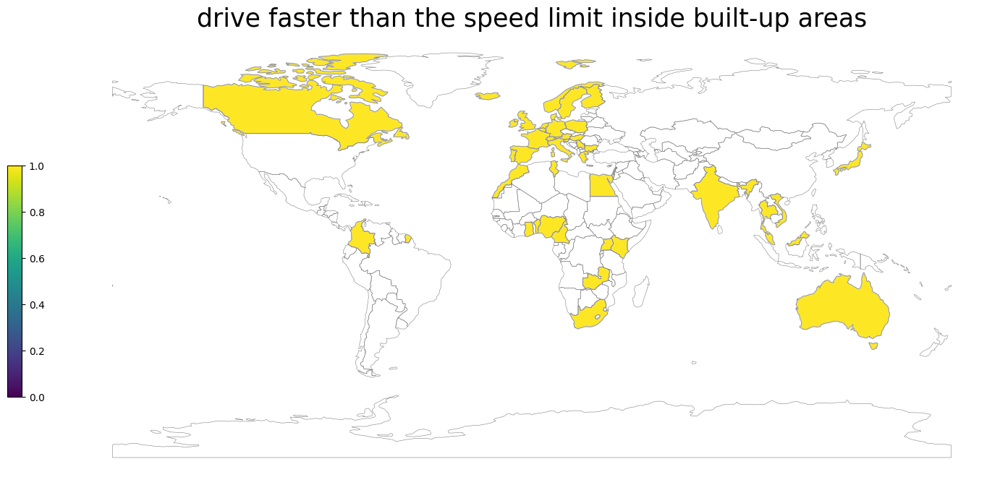

...

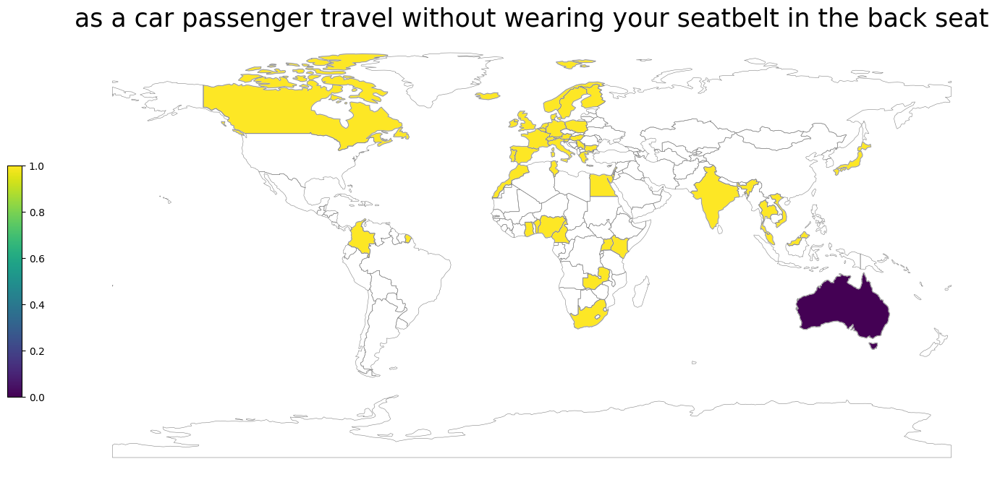

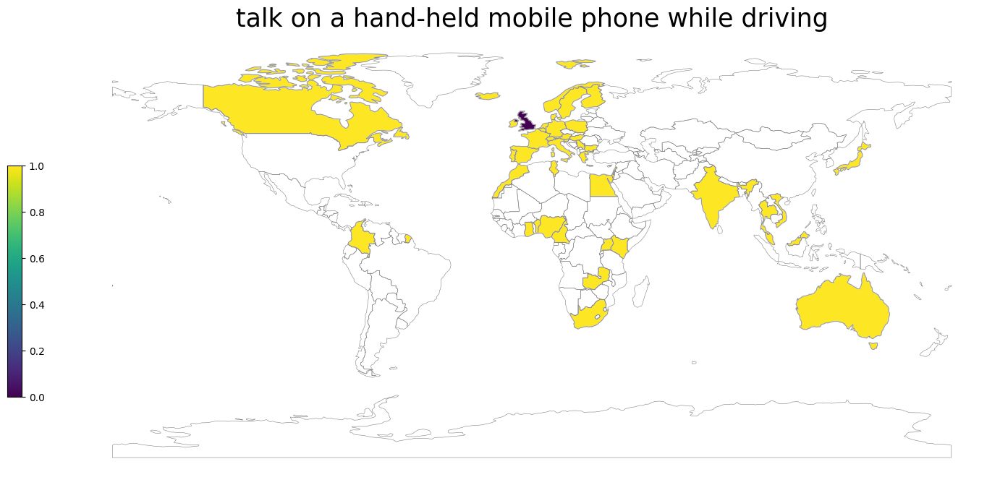

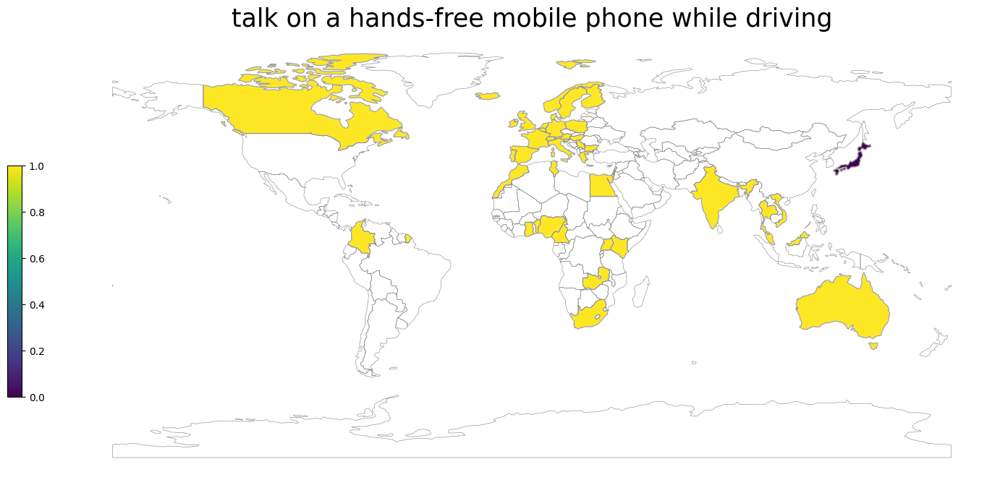

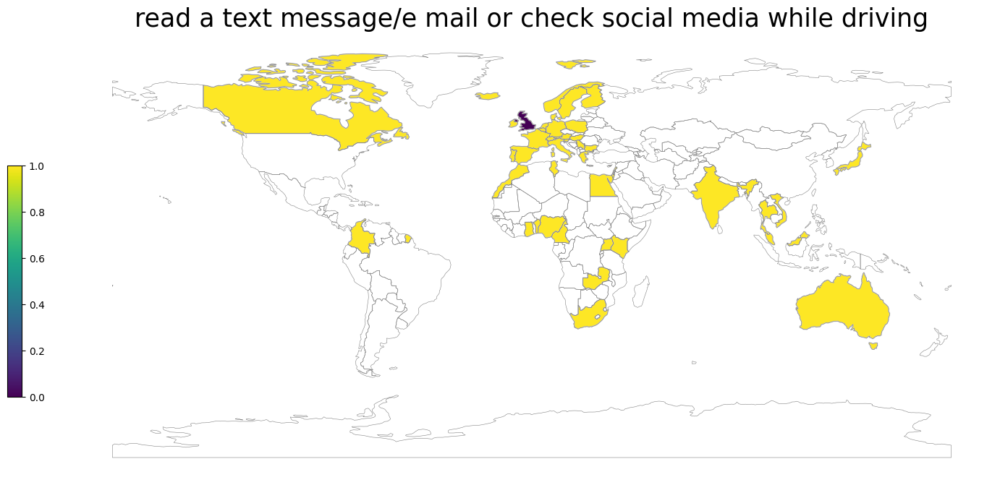

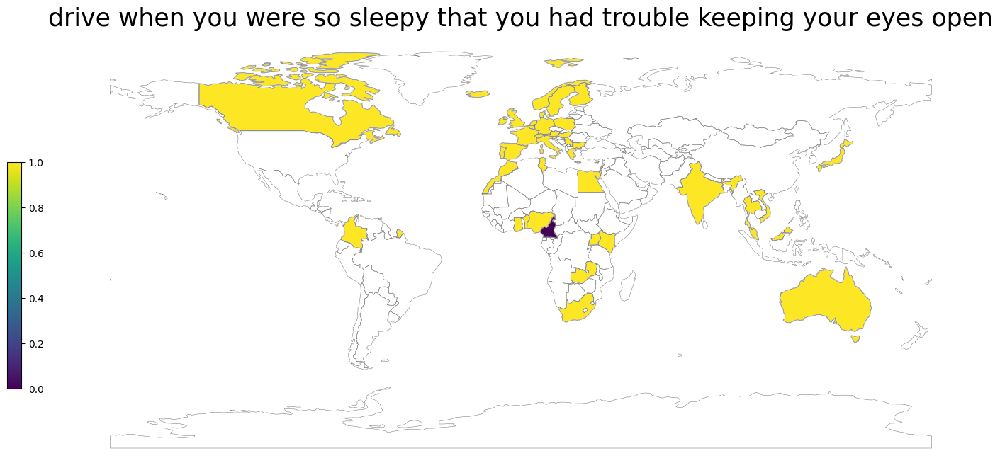

In [13]:
for i in range(len(data.columns)-1):
    plot_map(data.columns[1+i], data)